In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
import seaborn as sns
from random import seed

from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import  MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import Imputer

from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout, LSTM, BatchNormalization
from keras import layers
from keras import optimizers
from keras import callbacks
from keras import models

Using TensorFlow backend.


In [2]:
#Generate Dataset
#Airfoil Self-Noise
df_airfoil=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Airfoil_self_noise.csv')

#Automobile
df_automobile=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Automobile_data.txt')

#Autompg
df_autompg=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Auto-mpg.csv')

#ChallengerUSA
df_challenger=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Challenger USA Space Shuttle O-Ring.csv')

#Combine Cycle Power
df_combine=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Combine Cycle Power Plant.csv')

#Computer Hardware
df_computer=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Computer Hardware.csv')

#Concrete Compressive Strength
df_concrete_compressive_strength=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Compressive Strength.csv')

#Concrete Slump Test
df_concrete1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')
df_concrete2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')
df_concrete3=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')

#Energy Efficiency
df_energy1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')

#Fertility Diagnosis
df_fertility=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\fertility_Diagnosis.csv')

#Forest Fires
df_forest=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\forestfires.csv')

#Housing
df_housing=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Housing.csv')

#Istanbul Stock Exchange
df_istanbul=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Istanbul Stock Exchange.csv')

#WDBC
df_wdbc=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\wdbc.csv')

In [3]:
#remove Nan columns of df_energy1
df_energy1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy1.drop(df_energy1.columns[11],inplace=True, axis = 1)
df_energy1.drop(df_energy1.columns[10],inplace=True, axis = 1)

#remove Nan columns of df_energy2
df_energy2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy2.drop(df_energy2.columns[11],inplace=True, axis = 1)
df_energy2.drop(df_energy2.columns[10],inplace=True, axis = 1)

#remove question marks
#df_automobile
imp= Imputer(missing_values="NaN", strategy="mean")
df_automobile=df_automobile.replace("?", np.NaN)
df_automobile['num-of-doors'] = df_automobile['num-of-doors'].fillna("four")
for i in df_automobile.columns:
    if df_automobile[i].isnull().sum()>0:
        df_automobile[i]=imp.fit_transform(df_automobile[[i]])
#df_automobile = df_automobile[(df_automobile.astype(str) != '?').all(axis=1)]
#df_automobile.reset_index(drop=True, inplace=True)
df_automobile = df_automobile.drop(['engine-location'], axis=1)
#df_autompg
df_autompg = df_autompg[(df_autompg.astype(str) != '?').all(axis=1)]
df_autompg.reset_index(drop=True, inplace=True)

#convert string to number
le=LabelEncoder()
#df_automobile
string_automobile=df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]
df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]=string_automobile.apply(le.fit_transform)
encoder=df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']].astype(np.int64)
df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]=encoder
a=df_automobile[['normalized-losses','horsepower','price']].astype(np.int64)
b=df_automobile[['bore','stroke','peak-rpm']].astype(float)
df_automobile[['normalized-losses','horsepower','price']]=a
df_automobile[['bore','stroke','peak-rpm']]=b
#df_computer
string_computer=df_computer[['Vendor','Model']]
df_computer[['Vendor','Model']]=string_computer.apply(le.fit_transform)
df_computer[['Vendor','Model']]=df_computer[['Vendor','Model']].astype(np.int64)

#dropna spesific column & special preprocessing
#df_forest
df_forest=df_forest[(df_forest['area'].astype(int) != 0)] 
df_forest.reset_index(drop=True, inplace=True)
num_features=10
dimension=(num_features+1)*9+10
population_size=(2*dimension+1)*2
df_forest=df_forest[:population_size]

C:\Users\user\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:66: DeprecationWarning: Class Imputer is deprecated; Imputer was deprecated in version 0.20 and will be removed in 0.22. Import impute.SimpleImputer from sklearn instead.
  warnings.warn(msg, category=DeprecationWarning)


In [4]:
def preprocessing_data1(df,num_features):
    dimension=(num_features+1)*9+10
    population_size=(2*dimension+1)*2
    df=df.dropna()
    df=df[:population_size]
    df
    return df

In [5]:
def feature_selection(df):
    cor=df.corr()
    plt.figure(figsize=(100,50))
    sns.set(font_scale=3)
    sns.heatmap(cor, annot=True, cmap=plt.cm.Blues)
    plt.show()
    return cor

In [6]:
def train_test_split1(x, y):
    x_train, x_test, y_train, y_test= train_test_split(x, y, test_size=0.15, random_state=42)
    return x_train, x_test, y_train, y_test

In [7]:
def preprocessing_data2(df):
    train_size = 0.85*len(df)
    train_size = int(train_size)
    df_train = df[:train_size]
    df_test = df[train_size:]
    print(len(df_test))
    print(len(df_train))
    validation_size=len(df_test)/len(df_train)
    print(validation_size)
    return df_train, df_test, validation_size 

In [8]:
#df_airfoil=preprocessing_data1(df_airfoil,5)
#df_automobile=preprocessing_data1(df_automobile,22)
#df_autompg=preprocessing_data1(df_autompg,7)
#df_challenger=preprocessing_data1(df_challenger,3)
#df_combine=preprocessing_data1(df_combine,4)
#df_computer=preprocessing_data1(df_computer,9)
#df_concrete_compressive_strength=preprocessing_data1(df_concrete_compressive_strength,8)
#df_concrete1=preprocessing_data1(df_concrete1,7)
#df_concrete2=preprocessing_data1(df_concrete2,7)
#df_concrete3=preprocessing_data1(df_concrete3,7)
#df_energy1=preprocessing_data1(df_energy1,8)
#df_energy2=preprocessing_data1(df_energy2,8)

#df_fertility=preprocessing_data1(df_fertility,9)
for i in df_fertility:
    df_fertility.Diagnosis[df_fertility.Diagnosis == 'N'] = 1
    df_fertility.Diagnosis[df_fertility.Diagnosis == 'O'] = 2
df_fertility['Diagnosis']=df_fertility['Diagnosis'].astype(np.int64)

#df_forest=preprocessing_data1(df_forest,10)
#df_housing=preprocessing_data1(df_housing,13)

#df_istanbul=preprocessing_data1(df_istanbul,7)
new_header = df_istanbul.iloc[0]
df_istanbul = df_istanbul[1:]
df_istanbul.columns = new_header
df_istanbul[['ISE1','ISE2','SP','DAX','FTSE','NIKKEI','BOVESPA','EU','EM']]=df_istanbul[['ISE1','ISE2','SP','DAX','FTSE','NIKKEI','BOVESPA','EU','EM']].astype(np.float64)


#df_wdbc=preprocessing_data1(df_wdbc,10)
df_wdbc.drop(df_wdbc.columns[0], axis=1, inplace = True)
df_wdbc.columns=['id','diagnosis','radius_mean','texture_mean','perimeter_mean','area_mean','smoothness_mean','compactness_mean','concavity_mean','concave points_mean','symmetry_mean','fractal_dimension_mean','radius_se','texture_se','perimeter_se','area_se','smoothness_se','compactness_se','concavity_se','concave points_se','symmetry_se','fractal_dimension_se','radius_worst','texture_worst','perimeter_worst','area_worst','smoothness_worst','compactness_worst','concavity_worst','concave points_worst','symmetry_worst','fractal_dimension_worst']
for i in df_wdbc:
    df_wdbc.diagnosis[df_wdbc.diagnosis == 'M'] = 1
    df_wdbc.diagnosis[df_wdbc.diagnosis == 'B'] = 2
df_wdbc['diagnosis']=df_wdbc['diagnosis'].astype(np.object)

C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning: 
A value is trying to be set on a 

In [9]:
print(df_airfoil.head())
print(df_autompg.head())
print(df_automobile.head())
print(df_challenger.head())

   Frequency  Angle of Attack  Chord length  Free-stream velocity  \
0        800              0.0        0.3048                  71.3   
1       1000              0.0        0.3048                  71.3   
2       1250              0.0        0.3048                  71.3   
3       1600              0.0        0.3048                  71.3   
4       2000              0.0        0.3048                  71.3   

   Suction side displacement thickness  Scaled sound pressure level  
0                             0.002663                      126.201  
1                             0.002663                      125.201  
2                             0.002663                      125.951  
3                             0.002663                      127.591  
4                             0.002663                      127.461  
    Mpg  Cylinders  Displacement Horsepower  Weight  Acceleration  Model Year  \
0  18.0          8         307.0        130    3504          12.0          70   
1  

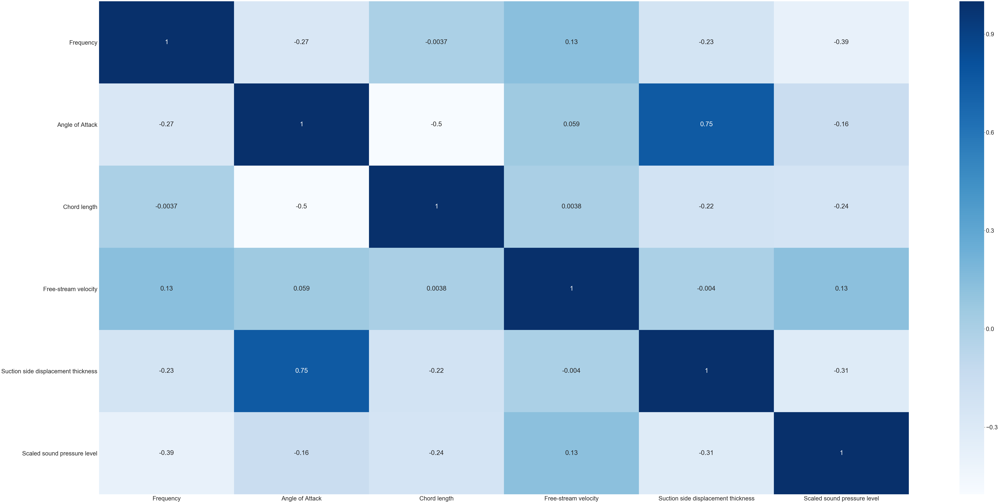

,Frequency,Angle of Attack,Chord length,Free-stream velocity,Suction side displacement thickness,Scaled sound pressure level
Frequency,1.000000,-0.272765,-0.003661,0.133664,-0.230107,-0.390711
Angle of Attack,-0.272765,1.000000,-0.504868,0.058760,0.753394,-0.156108
Chord length,-0.003661,-0.504868,1.000000,0.003787,-0.220842,-0.236162
Free-stream velocity,0.133664,0.058760,0.003787,1.000000,-0.003974,0.125103
Suction side displacement thickness,-0.230107,0.753394,-0.220842,-0.003974,1.000000,-0.312670
Scaled sound pressure level,-0.390711,-0.156108,-0.236162,0.125103,-0.312670,1.000000


In [10]:
feature_selection(df_airfoil)

In [11]:
#Train and Test 17 datasets
#Airfoil
x_airfoil = df_airfoil.drop(['Scaled sound pressure level'], axis = 1)
y_airfoil = df_airfoil['Scaled sound pressure level']
#Wdbc
x_wdbc = df_wdbc[['radius_mean','perimeter_mean','area_mean','concavity_mean','concave points_mean','radius_worst','perimeter_worst','area_worst','concave points_worst']]
y_wdbc = df_wdbc['diagnosis']
labelencoder_Y = LabelEncoder()
y_wdbc = labelencoder_Y.fit_transform(y_wdbc)
#Automobile
x_automobile = df_automobile.drop(['price','make','body-style'], axis = 1)
y_automobile = df_automobile['price']
y_automobile = np.reshape(y_automobile.values, (-1,1))
#Autompg
x_autompg = df_autompg.drop(['Mpg','Car Name'], axis = 1)
y_autompg = df_autompg['Mpg']
#Challenger
x_challenger = df_challenger.drop(['Number of O-rings','Temporal Order of Flight'], axis = 1)
y_challenger = df_challenger['Number of O-rings']
#Combine
x_combine = df_combine.drop(['PE'], axis = 1)
y_combine = df_combine['PE']
y_combine = np.reshape(y_combine.values, (-1,1))
#Computer
x_computer = df_computer.drop(['ERP'], axis = 1)
y_computer = df_computer['ERP']
y_computer = np.reshape(y_computer.values, (-1,1))
#Concrete_compressive_strength
x_concrete_compressive_strength = df_concrete_compressive_strength.drop(['CCS'], axis = 1)
y_concrete_compressive_strength = df_concrete_compressive_strength['CCS']
y_concrete_compressive_strength = np.reshape(y_concrete_compressive_strength.values, (-1,1))
#Concrete1
x_concrete1 = df_concrete1.drop(['No','Compressive Strength (28-day)(Mpa)'], axis = 1)
y_concrete1 = df_concrete1['Compressive Strength (28-day)(Mpa)']
#Concrete2
x_concrete2 = df_concrete2.drop(['No','SLUMP(cm)'], axis = 1)
y_concrete2 = df_concrete2['SLUMP(cm)']
y_concrete2 = np.reshape(y_concrete2.values, (-1,1))
#Concrete3
x_concrete3 = df_concrete3.drop(['No','FLOW(cm)'], axis = 1)
y_concrete3 = df_concrete3['FLOW(cm)']
y_concrete3 = np.reshape(y_concrete3.values, (-1,1))
#Energy1
x_energy1 = df_energy1.drop(['Y1'], axis = 1)
y_energy1 = df_energy1['Y1']
#Energy2
x_energy2 = df_energy2.drop(['Y2'], axis = 1)
y_energy2 = df_energy2['Y2']
#Fertility
x_fertility = df_fertility.drop(['Diagnosis'], axis = 1)
y_fertility = df_fertility['Diagnosis']
#Forest
x_forest = df_forest.drop(['month','day','area'], axis = 1)
y_forest = df_forest['area']
y_forest = np.reshape(y_forest.values, (-1,1))
#Housing
x_housing = df_housing.drop(['MEDV'], axis = 1)
y_housing = df_housing['MEDV']
#Istanbul
x_istanbul = df_istanbul.drop(['date','ISE1','ISE2'], axis = 1)
y_istanbul = df_istanbul[['ISE1','ISE2']]
y_istanbul['mean'] = y_istanbul.mean(axis=1)
y_istanbul = y_istanbul['mean']

C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:62: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [12]:
x_train_airfoil, x_test_airfoil, y_train_airfoil, y_test_airfoil = train_test_split1(x_airfoil, y_airfoil)
x_train_automobile, x_test_automobile, y_train_automobile, y_test_automobile = train_test_split1(x_automobile, y_automobile)
x_train_autompg, x_test_autompg, y_train_autompg, y_test_autompg = train_test_split1(x_autompg, y_autompg)
x_train_challenger, x_test_challenger, y_train_challenger, y_test_challenger = train_test_split1(x_challenger, y_challenger)
x_train_combine, x_test_combine, y_train_combine, y_test_combine = train_test_split1(x_combine, y_combine)
x_train_computer, x_test_computer, y_train_computer, y_test_computer = train_test_split1(x_computer, y_computer)
x_train_concrete_compressive_strength, x_test_concrete_compressive_strength, y_train_concrete_compressive_strength, y_test_concrete_compressive_strength = train_test_split1(x_concrete_compressive_strength, y_concrete_compressive_strength)
x_train_concrete1, x_test_concrete1, y_train_concrete1, y_test_concrete1 = train_test_split1(x_concrete1, y_concrete1)
x_train_concrete2, x_test_concrete2, y_train_concrete2, y_test_concrete2 = train_test_split1(x_concrete2, y_concrete2)
x_train_concrete3, x_test_concrete3, y_train_concrete3, y_test_concrete3 = train_test_split1(x_concrete3, y_concrete3)
x_train_energy1, x_test_energy1, y_train_energy1, y_test_energy1 = train_test_split1(x_energy1, y_energy1)
x_train_energy2, x_test_energy2, y_train_energy2, y_test_energy2 = train_test_split1(x_energy2, y_energy2)
x_train_fertility, x_test_fertility, y_train_fertility, y_test_fertility = train_test_split1(x_fertility, y_fertility)
x_train_forest, x_test_forest, y_train_forest, y_test_forest = train_test_split1(x_forest, y_forest)
x_train_housing, x_test_housing, y_train_housing, y_test_housing = train_test_split1(x_housing, y_housing)
x_train_istanbul, x_test_istanbul, y_train_istanbul, y_test_istanbul = train_test_split1(x_istanbul, y_istanbul)
x_train_wdbc, x_test_wdbc, y_train_wdbc, y_test_wdbc = train_test_split1(x_wdbc, y_wdbc)

In [13]:
def train_val_split(x_train, y_train):
    X_train, X_val, Y_train, Y_val= train_test_split(x_train, y_train, test_size=0.176, random_state=42)
    return X_train, X_val, Y_train, Y_val

In [14]:
def standard_scaler(X_train, X_val, x_test):
    sc=StandardScaler()
    X_train=X_train.values
    X_val=X_val.values
    x_test=x_test.values
    X_scale_train=sc.fit(X_train)
    #X_scale_val=sc.fit(X_val)
    #x_scale_test=sc.fit(x_test)
    X_train=X_scale_train.transform(X_train)
    X_val=X_scale_train.transform(X_val)
    x_test=X_scale_train.transform(x_test)
    return X_train, X_val, x_test, X_scale_train

In [15]:
def min_max_scaler_automobile(X_train, X_val, x_test, Y_train, Y_val, y_test):
    min_max=MinMaxScaler()
    X_train=X_train.values
    X_val=X_val.values
    x_test=x_test.values
    X_scale_train=min_max.fit(X_train)
    X_scale_val=min_max.fit(X_val)
    x_scale_test=min_max.fit(x_test)
    Y_scale_train=min_max.fit(Y_train)
    Y_scale_val=min_max.fit(Y_val)
    y_scale_test=min_max.fit(y_test)
    X_train=X_scale_train.transform(X_train)
    X_val=X_scale_val.transform(X_val)
    x_test=x_scale_test.transform(x_test)
    Y_train=Y_scale_train.transform(Y_train)
    Y_val=Y_scale_train.transform(Y_val)
    y_test=y_scale_test.transform(y_test)
    return X_train, X_val, x_test, Y_train, Y_val, y_test, X_scale_train, X_scale_val, x_scale_test, Y_scale_train, Y_scale_val, y_scale_test

In [16]:
def min_max_scaler(X_train, X_val, x_test, Y_train, Y_val, y_test):
    min_max=MinMaxScaler()
    X_train=X_train.values
    X_val=X_val.values
    x_test=x_test.values
    X_scale_train=min_max.fit(X_train)
    X_scale_val=min_max.fit(X_val)
    x_scale_test=min_max.fit(x_test)
    Y_scale_train=min_max.fit(Y_train)
    Y_scale_val=min_max.fit(Y_val)
    y_scale_test=min_max.fit(y_test)
    X_train=X_scale_train.transform(X_train)
    X_val=X_scale_val.transform(X_val)
    x_test=x_scale_test.transform(x_test)
    Y_train=Y_scale_train.transform(Y_train)
    Y_val=Y_scale_train.transform(Y_val)
    y_test=y_scale_test.transform(y_test)
    return X_train, X_val, x_test, Y_train, Y_val, y_test, min_max

In [17]:
def normalization(X_train, X_val, x_test, Y_train, Y_val, y_test):
    normalizer=Normalizer()
    X_train=normalizer.fit_transform(X_train)
    X_val=normalizer.fit_transform(X_val)
    x_test=normalizer.fit_transform(x_test)
    Y_train=normalizer.fit_transform(Y_train)
    Y_val=normalizer.fit_transform(Y_val)
    y_test=normalizer.fit_transform(y_test)
    return X_train, X_val, x_test, Y_train, Y_val, y_test

In [18]:
#Optimizer list
adam0 = 'adam'
adam1 = optimizers.Adam(lr=0.001)
adam2 = optimizers.Adam(lr=0.01)
adam3 = optimizers.Adam(lr=0.0001)
adam4 = optimizers.Adam(lr=0.00001)
sgd = optimizers.SGD(lr=0.005, decay=1e-4, momentum=0.9, nesterov=True)
RMSprop= optimizers.RMSprop(lr=0.001,rho=0.9)
adagrad = optimizers.Adagrad(lr=0.01)
adadelta = optimizers.Adadelta(lr=1.0)

In [19]:
def NN_model_structure_regression(X_train, X_val, Y_train, Y_val, adam, size, epochs, x_test, y_test):
    model = Sequential()
    model.add(Dense(units = 5, input_dim = (X_train.shape[1])))
    model.add(Activation('tanh'))
    #model.add(Dropout(0.2))
    model.add(Dense(units = 10))
    model.add(Activation('linear'))
    model.add(Dense(units = 1))
    model.compile(optimizer = adam , loss = 'mse')
    model.summary()
    history=model.fit(X_train,Y_train, batch_size=size,epochs=epochs, validation_data=(X_val, Y_val), shuffle=True)
    evaluate = model.evaluate(x_test, y_test, verbose=2, batch_size=size)
    print(evaluate)
    return model, history, evaluate

In [20]:
X_train_airfoil, X_val_airfoil, Y_train_airfoil, Y_val_airfoil = train_val_split(x_train_airfoil, y_train_airfoil)
X_train_automobile, X_val_automobile, Y_train_automobile, Y_val_automobile = train_val_split(x_train_automobile, y_train_automobile)
X_train_autompg, X_val_autompg, Y_train_autompg, Y_val_autompg = train_val_split(x_train_autompg, y_train_autompg)
X_train_challenger, X_val_challenger, Y_train_challenger, Y_val_challenger = train_val_split(x_train_challenger, y_train_challenger)
X_train_combine, X_val_combine, Y_train_combine, Y_val_combine = train_val_split(x_train_combine, y_train_combine)
X_train_computer, X_val_computer, Y_train_computer, Y_val_computer = train_val_split(x_train_computer, y_train_computer)
X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength = train_val_split(x_train_concrete_compressive_strength, y_train_concrete_compressive_strength)
X_train_concrete1, X_val_concrete1, Y_train_concrete1, Y_val_concrete1 = train_val_split(x_train_concrete1, y_train_concrete1)
X_train_concrete2, X_val_concrete2, Y_train_concrete2, Y_val_concrete2 = train_val_split(x_train_concrete2, y_train_concrete2)
X_train_concrete3, X_val_concrete3, Y_train_concrete3, Y_val_concrete3 = train_val_split(x_train_concrete3, y_train_concrete3)
X_train_energy1, X_val_energy1, Y_train_energy1, Y_val_energy1 = train_val_split(x_train_energy1, y_train_energy1)
X_train_energy2, X_val_energy2, Y_train_energy2, Y_val_energy2 = train_val_split(x_train_energy2, y_train_energy2)
X_train_fertility, X_val_fertility, Y_train_fertility, Y_val_fertility = train_val_split(x_train_fertility, y_train_fertility)
X_train_forest, X_val_forest, Y_train_forest, Y_val_forest = train_val_split(x_train_forest, y_train_forest)
X_train_housing, X_val_housing, Y_train_housing, Y_val_housing = train_val_split(x_train_housing, y_train_housing)
X_train_istanbul, X_val_istanbul, Y_train_istanbul, Y_val_istanbul = train_val_split(x_train_istanbul, y_train_istanbul)
X_train_wdbc, X_val_wdbc, Y_train_wdbc, Y_val_wdbc = train_val_split(x_train_wdbc, y_train_wdbc)

In [21]:
X_train_airfoil, X_val_airfoil, x_test_airfoil, X_scale_train_airfoil=standard_scaler(X_train_airfoil, X_val_airfoil, x_test_airfoil)
#X_train_automobile, X_val_automobile, x_test_automobile=standard_scaler(X_train_automobile, X_val_automobile, x_test_automobile)
#X_train_automobile, X_val_automobile, x_test_automobile, Y_train_automobile, Y_val_automobile, y_test_automobile = normalization(X_train_automobile, X_val_automobile, x_test_automobile, Y_train_automobile, Y_val_automobile, y_test_automobile)
X_train_automobile, X_val_automobile, x_test_automobile, Y_train_automobile, Y_val_automobile, y_test_automobile, X_scale_train_automobile, X_scale_val_automobile, x_scale_test_automobile, Y_scale_train_automobile, Y_scale_val_automobile, Y_scale_test_automobile=min_max_scaler_automobile(X_train_automobile, X_val_automobile, x_test_automobile, Y_train_automobile, Y_val_automobile, y_test_automobile)
X_train_autompg, X_val_autompg, x_test_autompg, X_scale_train_autompg=standard_scaler(X_train_autompg, X_val_autompg, x_test_autompg)
X_train_challenger, X_val_challenger, x_test_challenger, X_scale_train_challenger=standard_scaler(X_train_challenger, X_val_challenger, x_test_challenger)
X_train_combine, X_val_combine, x_test_combine, Y_train_combine, Y_val_combine, y_test_combine, min_max_combine=min_max_scaler(X_train_combine, X_val_combine, x_test_combine, Y_train_combine, Y_val_combine, y_test_combine)
X_train_computer, X_val_computer, x_test_computer, Y_train_computer, Y_val_computer, y_test_computer, min_max_computer=min_max_scaler(X_train_computer, X_val_computer, x_test_computer, Y_train_computer, Y_val_computer, y_test_computer)
X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, x_test_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength, y_test_concrete_compressive_strength, min_max_concrete_compressive_strength=min_max_scaler(X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, x_test_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength, y_test_concrete_compressive_strength)
X_train_concrete1, X_val_concrete1, x_test_concrete1, X_scale_train_concrete1=standard_scaler(X_train_concrete1, X_val_concrete1, x_test_concrete1)
X_train_concrete2, X_val_concrete2, x_test_concrete2, Y_train_concrete2, Y_val_concrete2, y_test_concrete2, min_max_concrete2=min_max_scaler(X_train_concrete2, X_val_concrete2, x_test_concrete2, Y_train_concrete2, Y_val_concrete2, y_test_concrete2)
X_train_concrete3, X_val_concrete3, x_test_concrete3, Y_train_concrete3, Y_val_concrete3, y_test_concrete3, min_max_concrete3=min_max_scaler(X_train_concrete3, X_val_concrete3, x_test_concrete3, Y_train_concrete3, Y_val_concrete3, y_test_concrete3)
X_train_energy1, X_val_energy1, x_test_energy1, X_scale_train_energy1=standard_scaler(X_train_energy1, X_val_energy1, x_test_energy1)
X_train_energy2, X_val_energy2, x_test_energy2, X_scale_train_energy2=standard_scaler(X_train_energy2, X_val_energy2, x_test_energy2)
X_train_fertility, X_val_fertility, x_test_fertility, X_scale_train_fertility=standard_scaler(X_train_fertility, X_val_fertility, x_test_fertility)
X_train_forest, X_val_forest, x_test_forest, Y_train_forest, Y_val_forest, y_test_forest, min_max_forest=min_max_scaler(X_train_forest, X_val_forest, x_test_forest, Y_train_forest, Y_val_forest, y_test_forest)
X_train_housing, X_val_housing, x_test_housing, X_scale_train_housing=standard_scaler(X_train_housing, X_val_housing, x_test_housing)
X_train_istanbul, X_val_istanbul, x_test_istanbul, X_scale_train_istanbul=standard_scaler(X_train_istanbul, X_val_istanbul, x_test_istanbul)

In [22]:
model_airfoil, history_airfoil, evaluate_airfoil=NN_model_structure_regression(X_train_airfoil, X_val_airfoil, Y_train_airfoil, Y_val_airfoil, adam2, 32, 100, x_test_airfoil, y_test_airfoil)
model_airfoil.get_weights()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 5)                 30        
_________________________________________________________________
activation_1 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_2 (Dense)              (None, 10)                60        
_________________________________________________________________
activation_2 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 11        
Total params: 101
Trainable params: 101
Non-trainable params: 0
_________________________________________________________________

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 428us/step - l

1052/1052 [==============================] - 0s 88us/step - loss: 22.3679 - val_loss: 26.5183
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 21.6470 - val_loss: 26.1256
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 21.6568 - val_loss: 25.4970
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 21.7654 - val_loss: 25.7926
Epoch 69/100
1052/1052 [==============================] - 0s 88us/step - loss: 21.8139 - val_loss: 26.0905
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 21.6586 - val_loss: 25.8333
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 21.7287 - val_loss: 25.8297
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 21.6688 - val_loss: 25.4825
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 21.8465 - val_loss: 27.3483
Epoch 74/100
1052/1052 [==========================

[array([[ 0.17652984,  0.01600568, -0.19112927,  0.16743477, -0.05533588],
        [ 0.21850115,  0.11866778, -0.10600449,  0.08960044, -0.11278467],
        [ 0.17784016,  0.00662393, -0.15876792,  0.14048496, -0.04469477],
        [ 0.0754637 , -0.02586073,  0.30685523, -0.17786488,  0.04072432],
        [ 0.09512769, -0.24778529, -0.13813816,  0.15298377,  0.13262922]],
       dtype=float32),
 array([-1.1869878, -1.4297477,  1.5373029, -1.4703466,  1.4349452],
       dtype=float32),
 array([[ 1.2309111 ,  1.9197047 ,  0.9103681 ,  1.143711  , -1.8886687 ,
          1.1676297 ,  1.8516982 , -2.0038404 , -1.9670727 ,  1.30841   ],
        [ 1.5956236 ,  1.3441344 ,  1.4035753 ,  1.0210177 , -1.4667186 ,
          1.4112842 ,  1.6758133 , -1.3261776 , -0.8018315 ,  1.327663  ],
        [-1.7090603 , -1.2283597 , -1.7863201 , -1.4606413 ,  1.1929674 ,
         -0.7244446 , -1.388267  ,  1.0326245 ,  0.85821563, -0.73838794],
        [ 1.7167672 ,  1.8468479 ,  1.3723711 ,  1.8646132 , -

In [23]:
#PSO
from random import seed
def initial_sol(particles, model):
    np.random.seed(7)
    weights_list=[]
    for j in range(particles):
        print('particle',j)
        #np.random.seed(j+12)
        weight = [np.random.uniform(low = -4.5, high = 4.5, size=(w.shape)) for w in model.get_weights()]
        weights_list.append(weight)
    return weights_list 

In [24]:
def particle_list_generate(particles, model, weights, X_train, Y_train, X_val, Y_val, x_test, y_test, epoch):
    particle_list=[]
    evaluate_list=[]
    train_val_test=[]
    for j in range(particles):
        model.set_weights(weights[j])
        model_training= model.fit(X_train,Y_train, batch_size=32,epochs=epoch, validation_data=(X_val, Y_val))
        model_history= model_training.history
        train_list=list(model_history['loss'])
        train_val_test.append(train_list[epoch-1])
        val_list=list(model_history['val_loss'])
        train_val_test.append(val_list[epoch-1])
        model_evaluation=model.evaluate(x_test, y_test, verbose=0)
        train_val_test.append(model_evaluation)
        weight = model.get_weights()
        particle_list.append(weight)
        evaluate_list.append(train_val_test)
        train_val_test=[]
    return particle_list, evaluate_list

In [25]:
def global_best(evaluate_list, pbest_list):
    #list_score=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\particle_best_list.csv')
    result_global_best=[]
    compare_val=math.inf
    compare_test=math.inf
    for i in range(len(evaluate_list)):
        if evaluate_list[i][1]<compare_val:
            if evaluate_list[i][2]<compare_test:
                compare_val=evaluate_list[i][1]
                compare_test=evaluate_list[i][2]
                global_best_train=evaluate_list[i][0]
                global_best_val=compare_val
                global_best_test=compare_test
                weight_global_best=pbest_list[i]
    result_global_best.append(global_best_train)
    result_global_best.append(global_best_val)
    result_global_best.append(global_best_test)
    return result_global_best, weight_global_best

In [26]:
def initial_velocity(particles, model):
    initial_velocity=[]
    for i in range(particles):
        velocity_weights=[np.random.uniform(low = -0.4, high = 0.4, size=(w.shape)) for w in model.get_weights()]
        initial_velocity.append(velocity_weights)
    return initial_velocity

In [27]:
def update_velocity(particles, velocity, weight_global_best, particle_list, pbest_list, w, c1, c2):
    update_velocity_list=[]
    for i in range(particles):
        r1=np.random.uniform(0,1)
        r2=np.random.uniform(0,1)
        eq1=c1*r1*(np.array(weight_global_best)-np.array(particle_list[i]))
        eq2=c2*r2*(np.array(pbest_list[i])-np.array(particle_list[i]))
        update_velocity=(w*np.array(velocity[i]))+eq1+eq2
        for array in range(len(update_velocity)):
            update_velocity[array][update_velocity[array]<-0.4]=-0.4
            update_velocity[array][update_velocity[array]>0.4]=0.4
        update_velocity_list.append(update_velocity)
    return update_velocity_list

In [28]:
def update_solution(particles, particle_list, velocity):
    solution_list=[]
    for i in range(particles):
        update_solution=np.array(particle_list[i])+np.array(velocity[i])
        for array in range(len(update_solution)):
            update_solution[array][update_solution[array]<-4.5]=-4.5
            update_solution[array][update_solution[array]>4.5]=4.5
        solution_list.append(update_solution)
    return solution_list

In [31]:
def generate_PSO(iteration, velocity, weight_global_best, particle_list, pbest_list, 
                 model, X_train, Y_train, X_val, Y_val, x_test, y_test, pbest_list_result, 
                 result_global_best):
    
    w=0.7
    c1=0.5
    c2=0.5
    
    result_global_best_list=[]
    
    for i in range(iteration):
        #iteration1=i+1
        #w=wmax-(((wmax-wmin)/iteration)*iteration1)
        #c1=(cmin-cmax)*(iteration1/iteration)+cmax
        #c2=(cmax-cmin)*(iteration1/iteration)+cmin
        velocity=update_velocity(10, velocity, weight_global_best, particle_list, pbest_list, w, c1, c2)
        weights=update_solution(10, particle_list, velocity)
        particle_list, particle_list_result=particle_list_generate(10, model, weights, X_train, Y_train, X_val, Y_val, 
                                                          x_test, y_test, 10)
        print('particle',particle_list_result)
        print('pbest_list',pbest_list_result)
        for j in range(len(particle_list)):
            if particle_list_result[j][1]<pbest_list_result[j][1]:
                if particle_list_result[j][2]<pbest_list_result[j][2]:
                    pbest_list_result[j]=particle_list_result[j]
                    pbest_list[j]=particle_list[j]
            if pbest_list_result[j][1]<result_global_best[1]:
                if pbest_list_result[j][2]<result_global_best[2]:
                    result_global_best=pbest_list_result[j]
                    weight_global_best=pbest_list[j]
            
        result_global_best_list.append(result_global_best)
            
    return weight_global_best, result_global_best, result_global_best_list

In [30]:
#Airfoil
weights_airfoil=initial_sol(10, model_airfoil)
particle_list_airfoil, particle_list_result_airfoil=particle_list_generate(10, model_airfoil, weights_airfoil, X_train_airfoil, Y_train_airfoil, X_val_airfoil, Y_val_airfoil, x_test_airfoil, y_test_airfoil, 10)
pbest_list_airfoil=list(particle_list_airfoil)
pbest_list_result_airfoil=list(particle_list_result_airfoil)
result_global_best_airfoil, weight_global_best_airfoil=global_best(pbest_list_result_airfoil, pbest_list_airfoil)
velocity_airfoil=initial_velocity(10, model_airfoil)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 1052 samples, validate on 225 samples
Epoch 1/10
1052/1052 [==============================] - 0s 89us/step - loss: 7862.7399 - val_loss: 1090.1156
Epoch 2/10
1052/1052 [==============================] - 0s 88us/step - loss: 569.8236 - val_loss: 289.3898
Epoch 3/10
1052/1052 [==============================] - 0s 94us/step - loss: 197.0806 - val_loss: 166.7249
Epoch 4/10
1052/1052 [==============================] - 0s 91us/step - loss: 123.1254 - val_loss: 117.1940
Epoch 5/10
1052/1052 [==============================] - 0s 88us/step - loss: 90.0020 - val_loss: 91.6123
Epoch 6/10
1052/1052 [==============================] - 0s 86us/step - loss: 69.2722 - val_loss: 73.4170
Epoch 7/10
1052/1052 [==============================] - 0s 88us/step - loss: 56.3050 - val_loss: 63.0810
Epoch 8/10
1052/1052 [==============================] - 0s 86us/step - loss: 47.0244 - val_loss: 5

1052/1052 [==============================] - 0s 89us/step - loss: 617.8395 - val_loss: 657.8422
Epoch 4/10
1052/1052 [==============================] - 0s 84us/step - loss: 462.2812 - val_loss: 505.0816
Epoch 5/10
1052/1052 [==============================] - 0s 87us/step - loss: 365.1402 - val_loss: 400.9493
Epoch 6/10
1052/1052 [==============================] - 0s 89us/step - loss: 300.0436 - val_loss: 324.8043
Epoch 7/10
1052/1052 [==============================] - 0s 88us/step - loss: 252.6603 - val_loss: 272.0405
Epoch 8/10
1052/1052 [==============================] - 0s 87us/step - loss: 216.6933 - val_loss: 233.6565
Epoch 9/10
1052/1052 [==============================] - 0s 89us/step - loss: 187.7462 - val_loss: 204.4428
Epoch 10/10
1052/1052 [==============================] - 0s 86us/step - loss: 166.8253 - val_loss: 183.2141
Train on 1052 samples, validate on 225 samples
Epoch 1/10
1052/1052 [==============================] - 0s 88us/step - loss: 10479.1872 - val_loss: 3659.22

In [ ]:
#PSO-MLP with Airfoil
weight_global_best_airfoil_PSO, result_global_best_airfoil_PSO, list_global_best_airfoil_PSO=generate_PSO(10, velocity_airfoil, weight_global_best_airfoil, particle_list_airfoil, pbest_list_airfoil, 
                                                      model_airfoil, X_train_airfoil, Y_train_airfoil, X_val_airfoil, Y_val_airfoil, 
                                                    x_test_airfoil, y_test_airfoil, pbest_list_result_airfoil, result_global_best_airfoil)

Train on 1052 samples, validate on 225 samples
Epoch 1/10
1052/1052 [==============================] - 0s 91us/step - loss: 289.1182 - val_loss: 94.7534
Epoch 2/10
1052/1052 [==============================] - 0s 84us/step - loss: 64.1218 - val_loss: 67.6008
Epoch 3/10
1052/1052 [==============================] - 0s 89us/step - loss: 51.6319 - val_loss: 60.4713
Epoch 4/10
1052/1052 [==============================] - 0s 89us/step - loss: 47.0459 - val_loss: 56.5533
Epoch 5/10
1052/1052 [==============================] - 0s 92us/step - loss: 43.4734 - val_loss: 52.5507
Epoch 6/10
1052/1052 [==============================] - 0s 93us/step - loss: 40.4654 - val_loss: 49.5648
Epoch 7/10
1052/1052 [==============================] - 0s 94us/step - loss: 37.9553 - val_loss: 47.1228
Epoch 8/10
1052/1052 [==============================] - 0s 87us/step - loss: 35.8949 - val_loss: 45.2139
Epoch 9/10
1052/1052 [==============================] - 0s 92us/step - loss: 34.1050 - val_loss: 43.3007
Epoch 1

1052/1052 [==============================] - 0s 84us/step - loss: 43.4269 - val_loss: 42.8089
Epoch 6/10
1052/1052 [==============================] - 0s 83us/step - loss: 37.9787 - val_loss: 37.9678
Epoch 7/10
1052/1052 [==============================] - 0s 86us/step - loss: 36.1444 - val_loss: 35.6583
Epoch 8/10
1052/1052 [==============================] - 0s 86us/step - loss: 35.2338 - val_loss: 34.9505
Epoch 9/10
1052/1052 [==============================] - 0s 87us/step - loss: 34.8769 - val_loss: 33.9334
Epoch 10/10
1052/1052 [==============================] - 0s 87us/step - loss: 34.2578 - val_loss: 33.2109
Train on 1052 samples, validate on 225 samples
Epoch 1/10
1052/1052 [==============================] - 0s 89us/step - loss: 275.9255 - val_loss: 48.3880
Epoch 2/10
1052/1052 [==============================] - 0s 87us/step - loss: 44.5989 - val_loss: 40.6327
Epoch 3/10
1052/1052 [==============================] - 0s 88us/step - loss: 36.9143 - val_loss: 38.2704
Epoch 4/10
1052/1

1052/1052 [==============================] - 0s 86us/step - loss: 24.9975 - val_loss: 28.1928
Epoch 9/10
1052/1052 [==============================] - 0s 87us/step - loss: 24.4467 - val_loss: 27.9287
Epoch 10/10
1052/1052 [==============================] - 0s 86us/step - loss: 23.9111 - val_loss: 27.4481
Train on 1052 samples, validate on 225 samples
Epoch 1/10
1052/1052 [==============================] - 0s 88us/step - loss: 105.6642 - val_loss: 45.4361
Epoch 2/10
1052/1052 [==============================] - 0s 86us/step - loss: 33.9743 - val_loss: 34.0856
Epoch 3/10
1052/1052 [==============================] - 0s 86us/step - loss: 31.5529 - val_loss: 33.7802
Epoch 4/10
1052/1052 [==============================] - 0s 87us/step - loss: 31.0931 - val_loss: 33.4795
Epoch 5/10
1052/1052 [==============================] - 0s 89us/step - loss: 30.4130 - val_loss: 33.1961
Epoch 6/10
1052/1052 [==============================] - 0s 86us/step - loss: 30.0457 - val_loss: 33.2294
Epoch 7/10
1052/1

1052/1052 [==============================] - 0s 87us/step - loss: 80.4355 - val_loss: 35.9383
Epoch 2/10
1052/1052 [==============================] - 0s 92us/step - loss: 25.9169 - val_loss: 31.1851
Epoch 3/10
1052/1052 [==============================] - 0s 90us/step - loss: 24.7871 - val_loss: 29.7624
Epoch 4/10
1052/1052 [==============================] - 0s 89us/step - loss: 23.5606 - val_loss: 28.8019
Epoch 5/10
1052/1052 [==============================] - 0s 89us/step - loss: 22.6986 - val_loss: 28.5604
Epoch 6/10
1052/1052 [==============================] - 0s 90us/step - loss: 22.4258 - val_loss: 27.6929
Epoch 7/10
1052/1052 [==============================] - 0s 90us/step - loss: 21.8874 - val_loss: 26.8255
Epoch 8/10
1052/1052 [==============================] - 0s 89us/step - loss: 21.3843 - val_loss: 26.5850
Epoch 9/10
1052/1052 [==============================] - 0s 82us/step - loss: 20.8205 - val_loss: 26.4508
Epoch 10/10
1052/1052 [==============================] - 0s 91us/s

Epoch 6/10
1052/1052 [==============================] - 0s 86us/step - loss: 27.2001 - val_loss: 29.9616
Epoch 7/10
1052/1052 [==============================] - 0s 88us/step - loss: 26.7502 - val_loss: 29.8943
Epoch 8/10
1052/1052 [==============================] - 0s 89us/step - loss: 26.3558 - val_loss: 29.7538
Epoch 9/10
1052/1052 [==============================] - 0s 88us/step - loss: 26.0584 - val_loss: 29.6782
Epoch 10/10
1052/1052 [==============================] - 0s 92us/step - loss: 25.6156 - val_loss: 28.9788
Train on 1052 samples, validate on 225 samples
Epoch 1/10
1052/1052 [==============================] - 0s 89us/step - loss: 134.0664 - val_loss: 43.5136
Epoch 2/10
1052/1052 [==============================] - 0s 88us/step - loss: 29.0578 - val_loss: 29.8139
Epoch 3/10
1052/1052 [==============================] - 0s 90us/step - loss: 26.4849 - val_loss: 29.2732
Epoch 4/10
1052/1052 [==============================] - 0s 89us/step - loss: 25.9905 - val_loss: 28.4377
Epoch 

1052/1052 [==============================] - 0s 87us/step - loss: 16.8432 - val_loss: 21.2086
Epoch 10/10
1052/1052 [==============================] - 0s 86us/step - loss: 16.6021 - val_loss: 21.5533
Train on 1052 samples, validate on 225 samples
Epoch 1/10
1052/1052 [==============================] - 0s 87us/step - loss: 140.8529 - val_loss: 50.6431
Epoch 2/10
1052/1052 [==============================] - 0s 87us/step - loss: 29.5728 - val_loss: 29.2979
Epoch 3/10
1052/1052 [==============================] - 0s 87us/step - loss: 23.7684 - val_loss: 27.1951
Epoch 4/10
1052/1052 [==============================] - 0s 87us/step - loss: 23.0282 - val_loss: 26.8587
Epoch 5/10
1052/1052 [==============================] - 0s 84us/step - loss: 22.3970 - val_loss: 26.2817
Epoch 6/10
1052/1052 [==============================] - 0s 89us/step - loss: 22.0218 - val_loss: 26.1150
Epoch 7/10
1052/1052 [==============================] - 0s 87us/step - loss: 21.5275 - val_loss: 25.8096
Epoch 8/10
1052/1

In [31]:
print(weight_global_best_airfoil_PSO)
print(result_global_best_airfoil_PSO)

[array([[-3.7352405 ,  2.9028869 , -0.5278174 ,  1.9827404 ,  0.04088522],
       [ 0.06225986, -0.44249693, -0.86035305, -0.05622468,  0.12890834],
       [ 0.11783772,  0.01876115, -0.32846367,  0.90025604, -1.0601888 ],
       [ 0.05966578, -0.09286302,  0.23205385, -0.09674452,  0.0237411 ],
       [-2.3340735 ,  0.38806388, -0.01023054,  0.27729902, -0.14648631]],
      dtype=float32), array([-4.9212303 ,  1.5732156 ,  0.19570655,  3.0922825 , -1.3329539 ],
      dtype=float32), array([[ 0.91690373,  1.8567472 ,  2.663351  ,  1.929219  ,  2.2012503 ,
         0.9725781 ,  0.233463  ,  1.7115438 , -0.03926349, -2.131847  ],
       [-0.5641561 ,  1.1852623 , -0.22063147,  2.1041362 , -0.23410821,
        -0.4661317 , -0.25754476,  0.27214515,  1.1458822 , -0.7835582 ],
       [-2.573616  ,  1.2763087 , -0.3175238 ,  2.6997223 , -0.5626775 ,
        -0.20606321,  0.5050322 ,  2.4482589 ,  1.2233063 ,  2.8505638 ],
       [-3.2646425 , -0.31135455,  3.1227891 , -0.32675716,  2.0097206

In [29]:
model_airfoil=models.load_model('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\PSO-MLP_model_airfoil_model_second_step_linear.h5')

In [30]:
#model_airfoil.set_weights(weight_global_best_airfoil_PSO)
validating=model_airfoil.evaluate(X_val_airfoil, Y_val_airfoil, verbose=0)
testing=model_airfoil.evaluate(x_test_airfoil, y_test_airfoil, verbose=0)
print(validating)
print(testing)

8.217971852487988
5.95475125734785


In [31]:
#Airfoil
prediction = model_airfoil.predict(x_test_airfoil)
y_test_list=list(y_test_airfoil)
for i in range(len(y_test_list)):
    print("predict", prediction[i][0], "actual", y_test_list[i])

predict 121.815865 actual 125.045
predict 117.21654 actual 118.76700000000001
predict 117.545876 actual 120.23299999999999
predict 134.99243 actual 137.047
predict 133.08218 actual 134.556
predict 123.078735 actual 120.766
predict 124.07532 actual 124.525
predict 134.65915 actual 136.798
predict 133.22948 actual 130.123
predict 127.591324 actual 123.991
predict 127.52159 actual 126.78
predict 110.37993 actual 110.652
predict 133.31035 actual 134.528
predict 134.61212 actual 133.756
predict 123.97571 actual 123.354
predict 110.75821 actual 107.985
predict 127.78476 actual 125.581
predict 131.57289 actual 130.558
predict 130.47928 actual 128.95600000000002
predict 123.55267 actual 121.58200000000001
predict 125.197876 actual 125.34299999999999
predict 131.18327 actual 128.74
predict 110.58037 actual 109.949
predict 125.57971 actual 126.486
predict 125.33251 actual 124.493
predict 125.75345 actual 125.631
predict 129.31552 actual 125.647
predict 128.70956 actual 129.491
predict 111.44792 

In [34]:
model_airfoil.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\PSO-MLP_model_airfoil_weights_second_step_linear.h5')
model_airfoil.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\PSO-MLP_model_airfoil_model_second_step_linear.h5')
np.savetxt("airfoil_global_best_list_PSO_second_step_linear.csv", list_global_best_airfoil_PSO, delimiter=",")

In [32]:
x_test_airfoil

array([[-0.77825928, -1.17622275,  1.82897688, -1.2743343 , -0.60936979],
       [-0.51412115,  0.93246172, -0.37217705, -1.2743343 ,  2.31597397],
       [-0.12568272, -0.4904717 ,  1.82897688, -0.76822763, -0.42095894],
       ...,
       [-0.59180883,  0.74388018, -0.92246553, -0.76822763,  0.28084549],
       [-0.51412115,  1.49820633, -0.37217705,  1.26260545,  2.45633576],
       [-0.28105809, -0.25045884,  0.17811143,  0.25039211, -0.53197698]])

In [33]:
tst=x_test_airfoil[:,0]
tst

array([-0.77825928, -0.51412115, -0.12568272,  0.34044339,  0.65119413,
       -0.65395898, -0.59180883, -0.7471842 , -0.77825928, -0.51412115,
       -0.59180883,  1.58344634, -0.40535839, -0.40535839, -0.40535839,
        1.05517009, -0.59180883, -0.80467309, -0.59180883, -0.77825928,
        0.34044339,  2.20494782,  0.65119413, -0.7471842 , -0.80467309,
        1.05517009, -0.59180883, -0.65395898,  0.65119413, -0.84040942,
       -0.59180883,  1.58344634, -0.51412115,  1.58344634,  0.34044339,
       -0.84040942, -0.12568272, -0.7471842 ,  0.34044339, -0.12568272,
       -0.12568272,  0.65119413, -0.59180883, -0.84040942, -0.80467309,
        0.34044339, -0.59180883,  0.65119413,  2.20494782,  0.07630526,
       -0.12568272,  1.58344634,  1.58344634, -0.84040942, -0.59180883,
        0.34044339,  0.07630526, -0.65395898, -0.82487189,  0.65119413,
       -0.28105809,  0.34044339, -0.70678661, -0.28105809,  0.65119413,
       -0.28105809,  1.05517009, -0.28105809, -0.70678661, -0.59

In [34]:
mint=tst.min(axis=0)
maxt=tst.max(axis=0)
print(mint)
print(maxt)

-0.8404094235576681
2.9818246707619305


In [35]:
tst=x_test_airfoil[:,1]
tst

array([-1.17622275,  0.93246172, -0.4904717 , -1.17622275, -1.17622275,
       -0.35332149,  1.46391878,  0.07527291,  0.05812913, -0.25045884,
       -1.17622275, -0.66190947,  1.00103682,  0.45243599,  0.07527291,
        0.93246172, -0.26760261,  0.05812913, -0.83334723,  0.26385445,
       -1.17622275, -1.17622275,  0.52101109, -0.83334723,  1.46391878,
       -1.17622275, -0.45618415, -0.26760261,  0.93246172,  1.49820633,
        1.80679431, -1.17622275,  0.05812913,  1.00103682, -0.4904717 ,
        0.34957333, -1.17622275, -0.26760261,  1.80679431,  0.93246172,
       -0.4904717 , -0.35332149,  0.52101109,  1.46391878, -0.4904717 ,
       -0.35332149,  1.46391878,  1.46391878, -1.17622275, -0.35332149,
       -1.17622275, -0.91906611, -0.35332149,  0.52101109, -0.91906611,
        1.80679431, -1.17622275, -0.71334079, -1.17622275, -0.4904717 ,
       -0.91906611, -1.17622275, -0.25045884,  0.26385445, -0.83334723,
        1.80679431,  0.45243599,  2.20110116, -1.17622275, -1.17

In [36]:
mint=tst.min(axis=0)
maxt=tst.max(axis=0)
print(mint)
print(maxt)

-1.1762227508167762
2.6296955627284415


In [37]:
X_train_airfoil

array([[ 0.34044339, -0.45618415, -0.92246553,  1.26260545, -0.7523472 ],
       [-0.59180883, -0.61047814, -0.37217705,  1.26260545, -0.70680605],
       [-0.84040942,  0.07527291,  1.00354416, -1.2743343 ,  0.14577106],
       ...,
       [ 0.07630526, -0.25045884,  0.17811143,  0.25039211, -0.53197698],
       [-0.40535839,  1.46391878, -0.92246553, -0.76822763,  1.28305588],
       [ 0.07630526,  0.34957333, -0.37217705,  1.26260545, -0.07865002]])

In [38]:
t=X_train_airfoil[:,0]
t

array([ 0.34044339, -0.59180883, -0.84040942, ...,  0.07630526,
       -0.40535839,  0.07630526])

In [39]:
mint=t.min(axis=0)
maxt=t.max(axis=0)
print(mint)
print(maxt)

-0.8404094235576681
5.312455216078759


In [40]:
t=X_train_airfoil[:,1]
t

array([-0.45618415, -0.61047814,  0.07527291, ..., -0.25045884,
        1.46391878,  0.34957333])

In [41]:
mint=t.min(axis=0)
maxt=t.max(axis=0)
print(mint)
print(maxt)

-1.1762227508167762
2.6296955627284415


In [42]:
X_val_airfoil

array([[-0.80467309,  0.34957333, -0.37217705, -0.76822763,  0.08450738],
       [-0.40535839, -0.4904717 ,  1.82897688,  1.26260545, -0.48305934],
       [-0.40535839, -0.4904717 ,  1.00354416,  1.26260545, -0.55677148],
       ...,
       [-0.12568272,  2.62969556, -1.19760977,  1.26260545,  0.76406694],
       [-0.28105809,  1.46391878, -0.92246553, -1.2743343 ,  1.33812947],
       [-0.28105809, -0.25045884,  0.17811143, -0.76822763, -0.49272681]])

In [43]:
v=X_val_airfoil[:,0]
v

array([-0.80467309, -0.40535839, -0.40535839, -0.70678661,  0.65119413,
        0.34044339, -0.65395898,  0.65119413,  0.65119413, -0.77825928,
        2.20494782, -0.40535839,  1.58344634, -0.70678661, -0.80467309,
       -0.59180883,  0.65119413,  0.07630526, -0.70678661, -0.59180883,
        2.98182467, -0.80467309,  4.06945226,  0.34044339, -0.12568272,
       -0.70678661, -0.28105809,  1.05517009, -0.59180883,  0.07630526,
        0.34044339, -0.40535839, -0.70678661,  0.65119413, -0.28105809,
       -0.77825928, -0.51412115, -0.77825928, -0.70678661, -0.65395898,
       -0.84040942, -0.28105809, -0.40535839,  1.05517009, -0.65395898,
       -0.40535839,  0.65119413, -0.70678661, -0.28105809,  0.34044339,
        0.07630526, -0.40535839,  0.34044339, -0.65395898,  1.05517009,
       -0.40535839, -0.12568272, -0.12568272,  0.07630526, -0.65395898,
        0.34044339, -0.77825928, -0.40535839,  0.34044339, -0.51412115,
        2.20494782, -0.77825928, -0.7471842 , -0.65395898, -0.12

In [44]:
mint=v.min(axis=0)
maxt=v.max(axis=0)
print(mint)
print(maxt)

-0.8404094235576681
4.06945225857645


In [45]:
v=X_val_airfoil[:,1]
v

array([ 0.34957333, -0.4904717 , -0.4904717 ,  1.80679431, -1.17622275,
       -0.83334723, -0.66190947,  0.26385445,  0.07527291,  1.80679431,
       -0.91906611,  2.20110116, -1.17622275, -0.4904717 , -0.91906611,
        0.52101109, -0.71334079, -0.83334723,  1.00103682,  1.49820633,
       -1.17622275,  2.20110116, -0.35332149, -0.35332149, -0.91906611,
        0.52101109, -1.17622275, -0.83334723, -0.83334723,  0.93246172,
        1.80679431,  1.46391878,  0.45243599, -1.17622275,  0.74388018,
       -0.02758975, -0.4904717 , -0.91906611, -1.17622275, -0.61047814,
        0.52101109, -0.35332149, -0.02758975,  0.45243599, -0.61047814,
       -0.91906611, -1.17622275, -0.26760261, -0.02758975,  0.05812913,
       -0.66190947,  0.93246172,  0.93246172, -1.17622275, -1.17622275,
       -1.17622275,  0.05812913,  1.00103682, -0.4904717 , -1.17622275,
       -0.25045884, -1.17622275, -0.91906611, -0.25045884, -1.17622275,
       -0.61047814,  1.49820633, -0.4904717 ,  2.62969556, -0.25

In [46]:
mint=v.min(axis=0)
maxt=v.max(axis=0)
print(mint)
print(maxt)

-1.1762227508167762
2.6296955627284415


### Feature Optimization 

In [47]:
def initial_sol_1_first_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=np.random.uniform(200,20000)
        a.append(Frequency)
        Angle_of_Attack = X[1]
        a.append(Angle_of_Attack)
        Chord_length = X[2]
        a.append(Chord_length)
        Free_stream_velocity=X[3]
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [48]:
def initial_sol_first_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=np.random.uniform(200,20000)
        a.append(Frequency)
        Angle_of_Attack = X[i][1]
        a.append(Angle_of_Attack)
        Chord_length = X[i][2]
        a.append(Chord_length)
        Free_stream_velocity=X[i][3]
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[i][4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [49]:
def p_best(particle, model):
    result_list=[]
    features=particle
    results=model.predict(features)
    for i in results:
        result_list.append(i[0])
    return features, result_list 

In [50]:
def g_best(pbest_feature, pbest_result, desired_width):
    compare=math.inf
    for k in range(len(pbest_result)):
        if abs(pbest_result[k]-desired_width)<compare:
            compare=pbest_result[k]-desired_width
            result_best=pbest_result[k]
            sol_best=pbest_feature[k]
    return sol_best, result_best 

In [51]:
def initial_velocity_first_feature(dimension):
    initial_sol=[]
    for i in range(dimension):
        initial_sol.append(np.random.uniform(-0.08,0.53))
        #initial_sol.append(0.01*np.random.random()) # warning
    return initial_sol

In [52]:
def update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle, w, c1, c2):
    for i in range(dimension):
        r1=np.random.uniform(0,1)
        r2=np.random.uniform(0,1)
        part1=c1*r1*(gbest_feature[0]-particle[i][0])
        part2=c2*r2*(pbest_feature[i][0]-particle[i][0])
        #print('particle', particle[i][1])
        #print('pbest', pbest_feature[i][1])
        velocity[i]=(w*velocity[i])+part1+part2
        if velocity[i]<-0.08:
            velocity[i]=-0.08
        if velocity[i]>0.53:
            velocity[i]=0.53
    return velocity

In [53]:
def update_particle_first_feature(dimension, particle, velocity):
    for i in range(dimension):
        particle[i][0]=particle[i][0]+velocity[i]
        if particle[i][0]<-0.8404094235576681:
            particle[i][0]=-0.8404094235576681
        if particle[i][0]>5.312455216078759:
            particle[i][0]=5.312455216078759
    return particle

In [54]:
def initial_sol_1_second_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=X[0]
        a.append(Frequency)
        Angle_of_Attack = np.random.uniform(0,22.2)
        a.append(Angle_of_Attack)
        Chord_length = X[2]
        a.append(Chord_length)
        Free_stream_velocity=X[3]
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [55]:
def initial_sol_second_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=X[i][0]
        a.append(Frequency)
        Angle_of_Attack = np.random.uniform(0,22.2)
        a.append(Angle_of_Attack)
        Chord_length = X[i][2]
        a.append(Chord_length)
        Free_stream_velocity=X[i][3]
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[i][4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [56]:
def initial_velocity_second_feature(dimension):
    initial_sol=[]
    for i in range(dimension):
        initial_sol.append(np.random.uniform(-0.11,0.26))
        #initial_sol.append(0.01*np.random.random()) # warning
    return initial_sol

In [57]:
def update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle, w, c1, c2):
    for i in range(dimension):
        r1=np.random.uniform(0,1)
        r2=np.random.uniform(0,1)
        part1=c1*r1*(gbest_feature[1]-particle[i][1])
        part2=c2*r2*(pbest_feature[i][1]-particle[i][1])
        #print('particle', particle[i][1])
        #print('pbest', pbest_feature[i][1])
        velocity[i]=(w*velocity[i])+part1+part2
        if velocity[i]<-0.11:
            velocity[i]=-0.11
        if velocity[i]>0.26:
            velocity[i]=0.26
    return velocity

In [58]:
def update_particle_second_feature(dimension, particle, velocity):
    for i in range(dimension):
        particle[i][1]=particle[i][1]+velocity[i]
        if particle[i][1]<-1.1762227508167762:
            particle[i][1]=-1.1762227508167762
        if particle[i][1]>2.6296955627284415:
            particle[i][1]=2.6296955627284415
    return particle

In [68]:
#Plot one data first feature train 
#Feature Optimization
iteration=20000
dimension=2
size=3
#wmax=1.0
#wmin=0.005
#cmax=2.0
#cmin=0.005
w=0.7
c1=0.5
c2=0.5
#X_train_airfoil_inverse=X_scale_train_airfoil.inverse_transform(X_train_airfoil)
X_train=list(X_train_airfoil_inverse)
Y_train=list(Y_train_airfoil)
features=[]
actual_features=[]
gap_feature=[]
prediction_result=[]
actual_y=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

#Calling Actual Result
X_train_1=X_train[3]
desired_width = Y_train[3]
        
#Initial Solution
particle = initial_sol_1_first_feature(dimension, X_train_1)
particle_feature=X_scale_train_airfoil.transform(particle)
pbest_feature=np.copy(particle_feature)
        
#Particle & Global Best
pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
#print('pbest_feature',pbest_feature)
        
#Initial Velocity
velocity=initial_velocity_first_feature(dimension)
#print('Data', i)
print('initial global best sol:',gbest_feature)
print('initial global best result:',gbest_result)
        
for k in range(iteration):
    print('Iteration', k+1)
    #iteration1=i+1
    #w=wmax-(((wmax-wmin)/iteration)*iteration1)
    #c1=(cmin-cmax)*(iteration1/iteration)+cmax
    #c2=(cmax-cmin)*(iteration1/iteration)+cmin
    velocity=update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
    particle=update_particle_first_feature(dimension, particle_feature, velocity)
    #print('particle',particle)
    particle_feature, particle_result=p_best(particle, model_airfoil)
    #print('pbest',pbest_feature)
            
    for j in range(len(particle_result)):
        #print('particle_gap',abs(particle_result[j]-desired_width))
        #print('pbest_result',abs(pbest_result[j]-desired_width))
        if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
            pbest_feature[j]=particle_feature[j]
            pbest_result[j]=particle_result[j]
        if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
            gbest_feature=pbest_feature[j]
            gbest_result=pbest_result[j]
        
    current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
    print('current', current_best_feature)
    print('actual', X_train_1)
    features.append(current_best_feature)
    actual_features.append(X_train_1)
    gap_feature1=abs(current_best_feature[0]-X_train_1[0])
    gap_feature.append(gap_feature1)
    prediction_result.append(gbest_result)
    actual_y.append(desired_width)
    error=(gbest_result-desired_width)**2
    error_value.append(error)
        
    print('squared error', error)
    print('Frequency :',current_best_feature[0])
    print('gap_feature1:', gap_feature1)
    print('Scaled sound pressure level :',gbest_result)
    Final_value.append(current_best_feature[0])
    Global_best.append(gbest_result)

initial global best sol: [-0.37089485 -0.83334723  1.00354416  1.26260545 -0.63837445]
initial global best result: 129.14505
Iteration 1
current [2.13310986e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 0.25169328724002815
Frequency : 2133.1098565767043
gap_feature1: 366.89014342329574
Scaled sound pressure level : 127.50769
Iteration 2
current [2.42865387e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 0.17195630727304537
Frequency : 2428.653865457351
gap_feature1: 71.346134542649
Scaled sound pressure level : 126.591324
Iteration 3
current [2.42865387e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 0.17195630727304537
Frequency : 2428.653865457351
gap_feature1: 71.346134542649
Scaled 

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 60
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 61
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 62
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared er

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 115
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 116
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 117
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9303

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 189
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 190
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 191
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Itera

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 254
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 255
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 256
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9303

 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 326
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 327
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 328
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.9

Iteration 393
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 394
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 395
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 396
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.130000

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 457
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 458
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 459
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9303

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 520
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 521
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 522
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9303

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 586
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 587
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 588
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 660
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 661
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 662
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9303

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 734
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 735
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 736
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9303

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 800
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 801
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 802
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 866
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 867
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 868
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9303

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 939
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 940
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 941
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9303

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1006
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1007
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1008
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1071
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1072
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1073
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squa

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1135
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1136
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1137
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
It

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1208
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1209
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1210
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1276
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1277
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1278
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
It

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1342
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1343
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1344
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1404
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1405
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1406
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_f

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1467
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1468
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1469
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
It

 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1528
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1529
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1530
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1597
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1598
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1599
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_f

 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1662
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1663
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1664
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1731
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1732
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1733
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_f

Iteration 1796
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1797
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1798
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1799
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13

 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1860
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1861
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1862
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1923
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1924
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1925
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1987
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1988
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 1989
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_f

Iteration 2050
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2051
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2052
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2053
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2119
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2120
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2121
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2186
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2187
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2188
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squa

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2253
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2254
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2255
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled so

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2314
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2315
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2316
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

Scaled sound pressure level : 127.006
Iteration 2379
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2380
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2381
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2382
current [2.28599269e

Scaled sound pressure level : 127.006
Iteration 2447
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2448
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2449
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2450
current [2.28599269e

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2508
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2509
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2510
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
It

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2572
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2573
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2574
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squa

Iteration 2637
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2638
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2639
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2640
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13

Scaled sound pressure level : 127.006
Iteration 2699
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2700
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2701
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2702
current [2.28599269e

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2767
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2768
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2769
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2835
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2836
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2837
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

Iteration 2901
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2902
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2903
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2904
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2964
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2965
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 2966
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3026
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3027
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3028
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3088
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3089
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3090
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squa

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3150
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3151
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3152
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_f

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3220
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3221
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3222
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3285
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3286
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3287
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3356
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3357
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3358
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3420
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3421
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3422
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squa

Scaled sound pressure level : 127.006
Iteration 3486
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3487
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3488
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3489
current [2.28599269e

Scaled sound pressure level : 127.006
Iteration 3551
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3552
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3553
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3554
current [2.28599269e

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3618
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3619
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3620
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled so

Scaled sound pressure level : 127.006
Iteration 3680
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3681
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3682
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3683
current [2.28599269e

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3748
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3749
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3750
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled so

Iteration 3824
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3825
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3826
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3827
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3888
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3889
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3890
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
It

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3956
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3957
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 3958
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4024
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4025
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4026
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
It

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4089
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4090
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4091
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4159
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4160
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4161
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4223
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4224
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4225
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

Scaled sound pressure level : 127.006
Iteration 4290
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4291
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4292
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4293
current [2.28599269e

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4355
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4356
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4357
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
It

Iteration 4426
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4427
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4428
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4429
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4487
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4488
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4489
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4554
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4555
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4556
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4616
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4617
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4618
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squa

Scaled sound pressure level : 127.006
Iteration 4682
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4683
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4684
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4685
current [2.28599269e

Scaled sound pressure level : 127.006
Iteration 4743
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4744
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4745
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4746
current [2.28599269e

Iteration 4813
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4814
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4815
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4816
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4876
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4877
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4878
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled so

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4943
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4944
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 4945
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squa

Iteration 5007
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5008
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5009
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5010
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5078
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5079
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5080
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5145
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5146
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5147
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
It

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5212
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5213
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5214
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

Iteration 5284
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5285
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5286
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5287
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5347
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5348
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5349
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5422
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5423
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5424
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_f

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5495
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5496
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5497
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_f

Scaled sound pressure level : 127.006
Iteration 5567
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5568
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5569
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5570
current [2.28599269e

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5631
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5632
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5633
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5699
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5700
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5701
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squa

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5766
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5767
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5768
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_f

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5825
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5826
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5827
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squa

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5887
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5888
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5889
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

Scaled sound pressure level : 127.006
Iteration 5946
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5947
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5948
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 5949
current [2.28599269e

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6014
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6015
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6016
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6080
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6081
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6082
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6145
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6146
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6147
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
It

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6208
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6209
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6210
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_f

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6274
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6275
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6276
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squa

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6342
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6343
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6344
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6407
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6408
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6409
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

Iteration 6471
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6472
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6473
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6474
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6539
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6540
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6541
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

Iteration 6605
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6606
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6607
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6608
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13

Scaled sound pressure level : 127.006
Iteration 6676
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6677
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6678
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6679
current [2.28599269e

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6746
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6747
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6748
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6821
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6822
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6823
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6886
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6887
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6888
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6961
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6962
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 6963
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled so

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7028
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7029
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7030
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_f

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7101
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7102
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7103
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

Scaled sound pressure level : 127.006
Iteration 7170
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7171
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7172
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7173
current [2.28599269e

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7237
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7238
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7239
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

Scaled sound pressure level : 127.006
Iteration 7301
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7302
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7303
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7304
current [2.28599269e

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7372
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7373
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7374
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7438
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7439
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7440
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

Scaled sound pressure level : 127.006
Iteration 7503
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7504
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7505
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7506
current [2.28599269e

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7571
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7572
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7573
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7640
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7641
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7642
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled so

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7712
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7713
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7714
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7779
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7780
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7781
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_f

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7846
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7847
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7848
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

Scaled sound pressure level : 127.006
Iteration 7914
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7915
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7916
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7917
current [2.28599269e

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7983
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7984
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 7985
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squa

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8051
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8052
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8053
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squa

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8120
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8121
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8122
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

Scaled sound pressure level : 127.006
Iteration 8181
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8182
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8183
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8184
current [2.28599269e

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8241
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8242
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8243
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_f

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8311
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8312
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8313
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_f

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8378
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8379
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8380
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8451
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8452
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8453
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8515
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8516
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8517
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_f

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8586
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8587
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8588
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

Scaled sound pressure level : 127.006
Iteration 8653
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8654
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8655
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8656
current [2.28599269e

Iteration 8712
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8713
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8714
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8715
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8777
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8778
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8779
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8845
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8846
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8847
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8912
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8913
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8914
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8978
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8979
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 8980
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9043
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9044
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9045
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_f

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9108
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9109
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9110
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9174
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9175
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9176
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

Iteration 9236
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9237
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9238
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9239
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9300
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9301
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9302
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squa

Iteration 9366
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9367
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9368
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9369
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13

Scaled sound pressure level : 127.006
Iteration 9434
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9435
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9436
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9437
current [2.28599269e

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9499
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9500
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9501
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9565
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9566
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9567
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_f

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9634
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9635
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9636
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled so

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9701
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9702
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9703
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9765
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9766
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9767
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9833
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9834
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9835
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.9

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9900
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9901
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9902
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_f

Iteration 9966
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9967
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9968
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 9969
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10036
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10037
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10038
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10100
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10101
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10102
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10166
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10167
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10168
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled

Scaled sound pressure level : 127.006
Iteration 10231
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10232
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10233
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10234
current [2.28599

 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10295
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10296
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10297
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+

Iteration 10370
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10371
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10372
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10373
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10440
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10441
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10442
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10500
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10501
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10502
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
s

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10577
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10578
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10579
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10643
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10644
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10645
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
ga

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10709
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10710
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10711
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
ga

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10772
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10773
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10774
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
s

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10835
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10836
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10837
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
s

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10898
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10899
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10900
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
ga

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10965
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10966
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 10967
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
s

Iteration 11034
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11035
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11036
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11037
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 

Iteration 11105
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11106
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11107
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11108
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 

Iteration 11169
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11170
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11171
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11172
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 

Iteration 11239
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11240
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11241
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11242
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11309
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11310
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11311
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11375
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11376
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11377
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11433
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11434
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11435
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11497
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11498
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11499
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
ga

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11558
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11559
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11560
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

Iteration 11619
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11620
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11621
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11622
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11684
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11685
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11686
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
ga

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11747
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11748
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11749
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
s

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11817
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11818
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11819
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11897
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11898
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11899
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11969
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11970
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 11971
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12038
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12039
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12040
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12105
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12106
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12107
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12173
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12174
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12175
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12238
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12239
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12240
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
ga

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12300
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12301
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12302
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12371
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12372
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12373
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled

Iteration 12442
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12443
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12444
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12445
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12514
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12515
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12516
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12581
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12582
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12583
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12658
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12659
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12660
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12725
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12726
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12727
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12798
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12799
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12800
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12861
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12862
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12863
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12930
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12931
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12932
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12996
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12997
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 12998
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

Iteration 13068
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13069
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13070
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13071
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 

Scaled sound pressure level : 127.006
Iteration 13140
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13141
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13142
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13143
current [2.28599

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13206
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13207
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13208
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13270
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13271
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13272
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

Scaled sound pressure level : 127.006
Iteration 13340
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13341
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13342
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13343
current [2.28599

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13408
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13409
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13410
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13476
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13477
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13478
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
ga

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13539
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13540
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13541
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
ga

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13600
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13601
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13602
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13659
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13660
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13661
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
s

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13718
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13719
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13720
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13778
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13779
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13780
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13827
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13828
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13829
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13880
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13881
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13882
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13935
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13936
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13937
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
ga

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13997
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13998
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 13999
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14064
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14065
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14066
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
ga

 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14137
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14138
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14139
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14198
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14199
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14200
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14259
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14260
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14261
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
ga

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14329
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14330
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14331
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14392
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14393
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14394
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14454
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14455
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14456
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14520
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14521
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14522
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
s

 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14593
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14594
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14595
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14668
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14669
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14670
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14734
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14735
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14736
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
s

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14799
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14800
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14801
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14865
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14866
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14867
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14922
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14923
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14924
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14975
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14976
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 14977
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15032
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15033
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15034
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15095
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15096
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15097
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15157
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15158
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15159
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15222
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15223
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15224
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled

Scaled sound pressure level : 127.006
Iteration 15287
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15288
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15289
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15290
current [2.28599

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15364
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15365
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15366
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15430
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15431
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15432
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15502
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15503
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15504
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15563
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15564
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15565
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15639
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15640
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15641
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15708
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15709
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15710
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

Scaled sound pressure level : 127.006
Iteration 15770
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15771
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15772
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15773
current [2.28599

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15835
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15836
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15837
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15896
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15897
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15898
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15959
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15960
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 15961
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
s

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16020
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16021
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16022
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16083
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16084
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16085
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16147
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16148
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16149
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16211
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16212
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16213
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16281
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16282
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16283
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16346
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16347
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16348
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16415
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16416
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16417
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

Scaled sound pressure level : 127.006
Iteration 16478
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16479
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16480
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16481
current [2.28599

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16545
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16546
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16547
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16612
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16613
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16614
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16678
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16679
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16680
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
s

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16743
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16744
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16745
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16806
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16807
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16808
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16879
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16880
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16881
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16948
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16949
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 16950
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17011
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17012
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17013
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17072
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17073
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17074
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17129
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17130
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17131
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17193
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17194
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17195
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17252
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17253
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17254
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
ga

Scaled sound pressure level : 127.006
Iteration 17317
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17318
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17319
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17320
current [2.28599

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17384
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17385
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17386
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17450
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17451
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17452
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17515
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17516
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17517
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17578
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17579
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17580
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17643
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17644
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17645
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+

 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17708
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17709
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17710
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17772
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17773
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17774
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17838
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17839
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17840
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
ga

Scaled sound pressure level : 127.006
Iteration 17902
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17903
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17904
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17905
current [2.28599

Iteration 17967
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17968
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17969
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 17970
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18035
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18036
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18037
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
s

 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18101
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18102
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18103
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18171
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18172
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18173
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18237
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18238
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18239
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18302
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18303
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18304
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18368
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18369
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18370
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

Iteration 18431
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18432
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18433
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18434
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18500
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18501
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18502
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
s

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18568
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18569
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18570
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
s

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18634
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18635
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18636
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
s

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18705
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18706
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18707
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18773
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18774
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18775
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18839
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18840
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18841
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18906
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18907
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18908
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
s

Scaled sound pressure level : 127.006
Iteration 18979
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18980
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18981
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 18982
current [2.28599

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19050
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19051
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19052
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

Scaled sound pressure level : 127.006
Iteration 19115
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19116
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19117
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19118
current [2.28599

gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19183
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19184
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19185
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19249
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19250
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19251
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
ga

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19315
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19316
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19317
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19386
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19387
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19388
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
s

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19456
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19457
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19458
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19523
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19524
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19525
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled

 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19588
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19589
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19590
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+

actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19649
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19650
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19651
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
s

Iteration 19711
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19712
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19713
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19714
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 

current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19775
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19776
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19777
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 

Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19843
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19844
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19845
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled

squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19909
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19910
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19911
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
ga

Iteration 19977
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19978
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19979
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 1.0862946511813743e-11
Frequency : 2285.9926943165133
gap_feature1: 214.00730568348672
Scaled sound pressure level : 127.006
Iteration 19980
current [2.28599269e+03 2.00000000e+00 2.28600000e-01 

In [66]:
df_features=pd.DataFrame(features,columns=['Frequency(prediction)','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_features.to_csv('features_PSO_airfoil_w&c_one_data_first_feature_linear_train.csv', sep = ',')
df_actual_features=pd.DataFrame(actual_features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_actual_features.to_csv('actual_features_PSO_airfoil_w&c_one_data_first_feature_linear_train.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_PSO_w&c_one_data_first_feature_linear_train.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_PSO_w&c_one_data_first_feature_linear_train.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_PSO_w&c_one_data_first_feature_linear_train.csv', sep = ',')

In [61]:
#Feature Optimization first feature train
data_length=len(X_train_airfoil)
iteration=20000
dimension=20
size=3
#wmax=1.0
#wmin=0.1
#cmax=2.5
#cmin=0.5
w=0.7
c1=0.5
c2=0.5
#X_train_airfoil_inverse=X_scale_train_airfoil.inverse_transform(X_train_airfoil)
X_train=list(X_train_airfoil_inverse)
Y_train=list(Y_train_airfoil)
features=[]
gap_feature=[]
prediction_result=[]
prediction_result_inverse=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

for i in range(data_length):
    try:
        #Calling Actual Result
        actual_feature = X_train[i]
        desired_width = Y_train[i]
        
        #Initial Solution
        particle = initial_sol_first_feature(dimension, X_train_airfoil_inverse)
        particle_feature=X_scale_train_airfoil.transform(particle)
        pbest_feature=np.copy(particle_feature)
        
        #Particle & Global Best
        pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
        gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
        #print('pbest_feature',pbest_feature)
        
        #Initial Velocity
        velocity=initial_velocity_first_feature(dimension)
        print('Data', i)
        print('initial global best sol:',gbest_feature)
        print('initial global best result:',gbest_result)
        
        for k in range(iteration):
            #print('Iteration', k+1)
            #iteration1=i+1
            #w=wmax-(((wmax-wmin)/iteration)*iteration1)
            #c1=(cmin-cmax)*(iteration1/iteration)+cmax
            #c2=(cmax-cmin)*(iteration1/iteration)+cmin
            velocity=update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
            particle=update_particle_first_feature(dimension, particle_feature, velocity)
            #print('particle',particle)
            particle_feature, particle_result=p_best(particle, model_airfoil)
            #print('pbest',pbest_feature)
            
            for j in range(len(particle_result)):
                if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
                    pbest_feature[j]=particle_feature[j]
                    pbest_result[j]=particle_result[j]
                if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
                    gbest_feature=pbest_feature[j]
                    gbest_result=pbest_result[j]
        
        current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
        print('current', current_best_feature)
        print('actual', actual_feature)
        features.append(current_best_feature)
        prediction_result.append(gbest_result)
        gap_feature1=abs(current_best_feature[0]-actual_feature[0])
        gap_feature.append(gap_feature1)
        error=(gbest_result-desired_width)**2
        error_value.append(error)
        
        print('squared error', error)
        print('Frequency :',current_best_feature[0])
        print('gap_feature1:', gap_feature1)
        print('Scaled sound pressure level :',gbest_result)
        Final_value.append(current_best_feature[0])
        Global_best.append(gbest_result)
    
    except KeyError:
        print("data is not exist")

Data 0
initial global best sol: [-0.37089485 -0.45618415 -0.92246553  1.26260545 -0.7523472 ]
initial global best result: 133.5548
current [2.4835375e+03 4.2000000e+00 5.0800000e-02 7.1300000e+01 1.4278800e-03]
actual [4.00000e+03 4.20000e+00 5.08000e-02 7.13000e+01 1.42788e-03]
squared error 5.187094233521927e-11
Frequency : 2483.5374979662124
gap_feature1: 1516.4625020337876
Scaled sound pressure level : 133.598
Data 1
initial global best sol: [ 3.76608828 -0.61047814 -0.37217705  1.26260545 -0.70680605]
initial global best result: 114.35708
current [1.88318458e+03 3.30000000e+00 1.01600000e-01 7.13000000e+01
 2.02822000e-03]
actual [1.00000e+03 3.30000e+00 1.01600e-01 7.13000e+01 2.02822e-03]
squared error 3.291666510590874e-11
Frequency : 1883.1845844803393
gap_feature1: 883.1845844803395
Scaled sound pressure level : 131.434
Data 2
initial global best sol: [ 3.64300964  0.07527291  1.00354416 -1.2743343   0.14577106]
initial global best result: 107.50653
current [4.28174249e+02 7.

current [6.10274035e+02 1.97000000e+01 5.08000000e-02 3.96000000e+01
 3.64840000e-02]
actual [5.0000e+02 1.9700e+01 5.0800e-02 3.9600e+01 3.6484e-02]
squared error 15.384692393772273
Frequency : 610.2740346386922
gap_feature1: 110.27403463869223
Scaled sound pressure level : 124.52167
Data 21
initial global best sol: [ 3.5043139  -1.17622275 -1.19760977 -1.2743343  -0.82732679]
initial global best result: 123.22868
current [1.23671163e+04 0.00000000e+00 2.54000000e-02 3.17000000e+01
 4.39472000e-04]
actual [1.60000e+04 0.00000e+00 2.54000e-02 3.17000e+01 4.39472e-04]
squared error 1.2069940776848754e-12
Frequency : 12367.116276393033
gap_feature1: 3632.8837236069667
Scaled sound pressure level : 125.627
Data 22
initial global best sol: [ 3.99610898 -1.17622275  1.00354416  1.26260545 -0.69806482]
initial global best result: 110.137436
current [2.02745682e+03 0.00000000e+00 2.28600000e-01 7.13000000e+01
 2.14345000e-03]
actual [1.25000e+03 0.00000e+00 2.28600e-01 7.13000e+01 2.14345e-03

current [1.16582521e+03 0.00000000e+00 1.52400000e-01 3.17000000e+01
 2.09405000e-03]
actual [1.00000e+03 0.00000e+00 1.52400e-01 3.17000e+01 2.09405e-03]
squared error 6.225840652937282
Frequency : 1165.825207127379
gap_feature1: 165.82520712737914
Scaled sound pressure level : 128.49184
Data 41
initial global best sol: [ 4.98801602 -0.26760261  1.00354416 -0.76822763 -0.3946412 ]
initial global best result: 107.4832
current [3.62589655e+03 5.30000000e+00 2.28600000e-01 3.96000000e+01
 6.14329000e-03]
actual [4.00000e+03 5.30000e+00 2.28600e-01 3.96000e+01 6.14329e-03]
squared error 6.262212982041659e-12
Frequency : 3625.896554090342
gap_feature1: 374.10344590965815
Scaled sound pressure level : 115.801
Data 42
initial global best sol: [ 1.96600173 -0.35332149 -1.19760977 -0.76822763 -0.79182457]
initial global best result: 125.66893
current [9.02137565e+03 4.80000000e+00 2.54000000e-02 3.96000000e+01
 9.07475000e-04]
actual [1.60000e+03 4.80000e+00 2.54000e-02 3.96000e+01 9.07475e-04

current [1.56176689e+03 0.00000000e+00 3.04800000e-01 5.55000000e+01
 2.83081000e-03]
actual [1.60000e+03 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
squared error 3.725289784983783e-15
Frequency : 1561.7668856458565
gap_feature1: 38.23311435414348
Scaled sound pressure level : 126.986
Data 61
initial global best sol: [ 4.3394671   0.93246172 -0.37217705  1.26260545  1.70178964]
initial global best result: 110.49423
current [3.99679751e+03 1.23000000e+01 1.01600000e-01 7.13000000e+01
 3.37792000e-02]
actual [5.00000e+03 1.23000e+01 1.01600e-01 7.13000e+01 3.37792e-02]
squared error 2.9206276285775877e-12
Frequency : 3996.7975140018307
gap_feature1: 1003.2024859981693
Scaled sound pressure level : 116.108
Data 62
initial global best sol: [ 5.06778435  0.07527291  1.00354416 -0.76822763  0.07604911]
initial global best result: 107.42731
current [4.39705341e+03 7.30000000e+00 2.28600000e-01 3.96000000e+01
 1.23481000e-02]
actual [5.00000e+03 7.30000e+00 2.28600e-01 3.96000e+01 1.2348

current [6.48815664e+03 4.80000000e+00 2.54000000e-02 5.55000000e+01
 8.73218000e-04]
actual [3.15000e+03 4.80000e+00 2.54000e-02 5.55000e+01 8.73218e-04]
squared error 1.5258789179739552e-11
Frequency : 6488.156644511455
gap_feature1: 3338.156644511455
Scaled sound pressure level : 132.354
Data 81
initial global best sol: [ 1.89578246  0.26385445 -0.92246553 -0.76822763 -0.43112935]
initial global best result: 118.58788
current [1.52773287e+03 8.40000000e+00 5.08000000e-02 3.96000000e+01
 5.66229000e-03]
actual [1.25000e+03 8.40000e+00 5.08000e-02 3.96000e+01 5.66229e-03]
squared error 3.352761222819023e-12
Frequency : 1527.7328684818349
gap_feature1: 277.7328684818349
Scaled sound pressure level : 131.205
Data 82
initial global best sol: [ 0.84990077 -0.02758975 -0.37217705 -0.76822763 -0.42214234]
initial global best result: 117.831955
current [1.77396793e+03 6.70000000e+00 1.01600000e-01 3.96000000e+01
 5.78076000e-03]
actual [1.60000e+03 6.70000e+00 1.01600e-01 3.96000e+01 5.78076

current [1.97104033e+03 3.00000000e+00 3.04800000e-01 3.17000000e+01
 5.29514000e-03]
actual [2.50000e+03 3.00000e+00 3.04800e-01 3.17000e+01 5.29514e-03]
squared error 1.8253922375033316e-13
Frequency : 1971.0403310636989
gap_feature1: 528.9596689363011
Scaled sound pressure level : 119.598
Data 101
initial global best sol: [ 2.07390654 -0.02758975 -0.37217705 -0.76822763 -0.42214234]
initial global best result: 113.415634
current [8.66234618e+02 6.70000000e+00 1.01600000e-01 3.96000000e+01
 5.78076000e-03]
actual [6.30000e+02 6.70000e+00 1.01600e-01 3.96000e+01 5.78076e-03]
squared error 3.8526568703069883
Frequency : 866.234617664755
gap_feature1: 236.23461766475498
Scaled sound pressure level : 131.39218
Data 102
initial global best sol: [3.47294517 0.52101109 0.17811143 0.25039211 0.72052391]
initial global best result: 108.62797
current [7.48606812e+03 9.90000000e+00 1.52400000e-01 5.55000000e+01
 2.08438000e-02]
actual [6.30000e+03 9.90000e+00 1.52400e-01 5.55000e+01 2.08438e-02

current [3.47748812e+03 5.40000000e+00 1.52400000e-01 3.17000000e+01
 5.25474000e-03]
actual [3.15000e+03 5.40000e+00 1.52400e-01 3.17000e+01 5.25474e-03]
squared error 1.3411045307609727e-13
Frequency : 3477.4881171558263
gap_feature1: 327.48811715582633
Scaled sound pressure level : 118.291
Data 121
initial global best sol: [ 3.82620486 -1.17622275  1.00354416  1.26260545 -0.69806482]
initial global best result: 110.594284
current [7.31155835e+03 0.00000000e+00 2.28600000e-01 7.13000000e+01
 2.14345000e-03]
actual [6.30000e+03 0.00000e+00 2.28600e-01 7.13000e+01 2.14345e-03]
squared error 1.6428530137529984e-12
Frequency : 7311.558345924376
gap_feature1: 1011.5583459243762
Scaled sound pressure level : 122.044
Data 122
initial global best sol: [ 3.75945803  0.05812913  0.17811143  1.26260545 -0.29017585]
initial global best result: 109.4377
current [1.31417196e+03 7.20000000e+00 1.52400000e-01 7.13000000e+01
 7.52039000e-03]
actual [1.25000e+03 7.20000e+00 1.52400e-01 7.13000e+01 7.5

current [2.00000e+02 1.26000e+01 1.52400e-01 7.13000e+01 4.83159e-02]
actual [2.50000e+02 1.26000e+01 1.52400e-01 7.13000e+01 4.83159e-02]
squared error 1.2384366983134891
Frequency : 200.0
gap_feature1: 50.0
Scaled sound pressure level : 128.63115
Data 141
initial global best sol: [ 3.86589172 -0.35332149 -1.19760977 -0.76822763 -0.79182457]
initial global best result: 120.68809
current [2.42593735e+03 4.80000000e+00 2.54000000e-02 3.96000000e+01
 9.07475000e-04]
actual [5.00000e+03 4.80000e+00 2.54000e-02 3.96000e+01 9.07475e-04]
squared error 3.3750009061529185
Frequency : 2425.9373462268168
gap_feature1: 2574.0626537731832
Scaled sound pressure level : 133.58888
Data 142
initial global best sol: [ 1.00280173 -1.17622275  0.17811143 -1.2743343  -0.70181225]
initial global best result: 121.65411
current [2.64630799e+03 0.00000000e+00 1.52400000e-01 3.17000000e+01
 2.09405000e-03]
actual [6.30000e+02 0.00000e+00 1.52400e-01 3.17000e+01 2.09405e-03]
squared error 2.715736581115902e-12


current [4.58993294e+02 9.90000000e+00 1.52400000e-01 5.55000000e+01
 2.08438000e-02]
actual [4.00000e+02 9.90000e+00 1.52400e-01 5.55000e+01 2.08438e-02]
squared error 1.8253922375033315e-11
Frequency : 458.9932940998701
gap_feature1: 58.99329409987013
Scaled sound pressure level : 131.605
Data 161
initial global best sol: [-0.50129147 -1.17622275 -0.92246553  1.26260545 -0.80449279]
initial global best result: 128.82593
current [1.1480807e+04 0.0000000e+00 5.0800000e-02 7.1300000e+01 7.4047800e-04]
actual [1.00000e+03 0.00000e+00 5.08000e-02 7.13000e+01 7.40478e-04]
squared error 9.313225676765846e-12
Frequency : 11480.807028748324
gap_feature1: 10480.807028748324
Scaled sound pressure level : 129.45
Data 162
initial global best sol: [ 4.04749137 -0.4904717   1.00354416  0.25039211 -0.53551808]
initial global best result: 107.9468
current [9.04066546e+02 4.00000000e+00 2.28600000e-01 5.55000000e+01
 4.28620000e-03]
actual [1.0000e+03 4.0000e+00 2.2860e-01 5.5500e+01 4.2862e-03]
squar

current [2.19002372e+02 1.26000000e+01 1.52400000e-01 7.13000000e+01
 4.83159000e-02]
actual [3.15000e+02 1.26000e+01 1.52400e-01 7.13000e+01 4.83159e-02]
squared error 4.1857361908259615e-11
Frequency : 219.00237163852762
gap_feature1: 95.99762836147238
Scaled sound pressure level : 128.484
Data 181
initial global best sol: [ 0.23333167  0.93246172 -0.37217705  0.25039211  1.93271184]
initial global best result: 114.372314
current [2.00000e+02 1.23000e+01 1.01600e-01 5.55000e+01 3.68233e-02]
actual [2.50000e+02 1.23000e+01 1.01600e-01 5.55000e+01 3.68233e-02]
squared error 14.381123954673413
Frequency : 200.0
gap_feature1: 50.0
Scaled sound pressure level : 129.50175
Data 182
initial global best sol: [-0.77513316 -1.17622275 -0.37217705 -0.76822763 -0.74965876]
initial global best result: 120.030106
current [3.99526953e+03 0.00000000e+00 1.01600000e-01 3.96000000e+01
 1.46332000e-03]
actual [4.00000e+03 0.00000e+00 1.01600e-01 3.96000e+01 1.46332e-03]
squared error 6.262212982041659e-

current [9.05166291e+03 0.00000000e+00 3.04800000e-01 3.96000000e+01
 3.10138000e-03]
actual [1.00000e+04 0.00000e+00 3.04800e-01 3.96000e+01 3.10138e-03]
squared error 3.725289784983783e-15
Frequency : 9051.662913791715
gap_feature1: 948.3370862082847
Scaled sound pressure level : 112.139
Data 201
initial global best sol: [ 5.05010569 -1.17622275 -0.92246553 -1.2743343  -0.79905477]
initial global best result: 116.61479
current [1.18528667e+04 0.00000000e+00 5.08000000e-02 3.17000000e+01
 8.12164000e-04]
actual [1.00000e+04 0.00000e+00 5.08000e-02 3.17000e+01 8.12164e-04]
squared error 9.31322576350202e-12
Frequency : 11852.866744600815
gap_feature1: 1852.8667446008149
Scaled sound pressure level : 122.45
Data 202
initial global best sol: [ 4.15312816 -1.17622275  1.82897688 -0.76822763 -0.62539727]
initial global best result: 107.7621
current [1.16589603e+04 0.00000000e+00 3.04800000e-01 3.96000000e+01
 3.10138000e-03]
actual [1.25000e+04 0.00000e+00 3.04800e-01 3.96000e+01 3.10138e-

current [2.53083723e+03 3.30000000e+00 1.01600000e-01 3.96000000e+01
 2.45138000e-03]
actual [6.30000e+02 3.30000e+00 1.01600e-01 3.96000e+01 2.45138e-03]
squared error 5.012750618849093e-11
Frequency : 2530.837230243495
gap_feature1: 1900.837230243495
Scaled sound pressure level : 127.25101
Data 221
initial global best sol: [ 4.63958222 -0.91906611  1.82897688 -0.76822763 -0.56321645]
initial global best result: 107.40173
current [9.12252048e+02 1.50000000e+00 3.04800000e-01 3.96000000e+01
 3.92107000e-03]
actual [8.00000e+02 1.50000e+00 3.04800e-01 3.96000e+01 3.92107e-03]
squared error 5.974809207002963
Frequency : 912.2520481448796
gap_feature1: 112.25204814487961
Scaled sound pressure level : 126.38666
Data 222
initial global best sol: [ 4.0956224  -1.17622275  0.17811143  0.25039211 -0.72968055]
initial global best result: 111.06366
current [1.32802787e+03 0.00000000e+00 1.52400000e-01 5.55000000e+01
 1.72668000e-03]
actual [2.00000e+03 0.00000e+00 1.52400e-01 5.55000e+01 1.72668

current [1.59311392e+04 1.26000000e+01 1.52400000e-01 3.96000000e+01
 5.84113000e-02]
actual [4.00000e+03 1.26000e+01 1.52400e-01 3.96000e+01 5.84113e-02]
squared error 10.705755136965308
Frequency : 15931.139216548061
gap_feature1: 11931.139216548061
Scaled sound pressure level : 107.771965
Data 241
initial global best sol: [ 2.67946887 -1.17622275  1.82897688  1.26260545 -0.65862424]
initial global best result: 112.65708
current [1.18499331e+04 0.00000000e+00 3.04800000e-01 7.13000000e+01
 2.66337000e-03]
actual [1.25000e+04 0.00000e+00 3.04800e-01 7.13000e+01 2.66337e-03]
squared error 7.2121620159903974e-12
Frequency : 11849.933110124373
gap_feature1: 650.0668898756267
Scaled sound pressure level : 112.241
Data 242
initial global best sol: [ 3.25268212 -0.66190947  1.82897688 -1.2743343  -0.45898096]
initial global best result: 107.66918
current [4.38753792e+03 3.00000000e+00 3.04800000e-01 3.17000000e+01
 5.29514000e-03]
actual [5.00000e+03 3.00000e+00 3.04800e-01 3.17000e+01 5.29

current [1.19649234e+03 3.30000000e+00 1.01600000e-01 3.96000000e+01
 2.45138000e-03]
actual [2.00000e+03 3.30000e+00 1.01600e-01 3.96000e+01 2.45138e-03]
squared error 3.062624757129964
Frequency : 1196.4923408760746
gap_feature1: 803.5076591239254
Scaled sound pressure level : 130.55096
Data 261
initial global best sol: [ 5.30237607 -1.17622275  1.82897688 -0.76822763 -0.62539727]
initial global best result: 107.34973
current [3.231675e+03 0.000000e+00 3.048000e-01 3.960000e+01 3.101380e-03]
actual [2.50000e+03 0.00000e+00 3.04800e-01 3.96000e+01 3.10138e-03]
squared error 4.306435581247214e-12
Frequency : 3231.675002790127
gap_feature1: 731.6750027901271
Scaled sound pressure level : 121.399
Data 262
initial global best sol: [2.98905013 0.52101109 0.17811143 0.25039211 0.72052391]
initial global best result: 108.785255
current [2.31200941e+03 9.90000000e+00 1.52400000e-01 5.55000000e+01
 2.08438000e-02]
actual [2.50000e+03 9.90000e+00 1.52400e-01 5.55000e+01 2.08438e-02]
squared err

current [1.77940143e+04 1.26000000e+01 1.52400000e-01 7.13000000e+01
 4.83159000e-02]
actual [5.00000e+03 1.26000e+01 1.52400e-01 7.13000e+01 4.83159e-02]
squared error 0.0001513587749043631
Frequency : 17794.01426881246
gap_feature1: 12794.014268812462
Scaled sound pressure level : 108.0463
Data 281
initial global best sol: [ 3.91817364  0.07527291  1.00354416  0.25039211 -0.01327479]
initial global best result: 107.62281
current [1.09061354e+03 7.30000000e+00 2.28600000e-01 5.55000000e+01
 1.11706000e-02]
actual [8.00000e+02 7.30000e+00 2.28600e-01 5.55000e+01 1.11706e-02]
squared error 5.960465043752819e-14
Frequency : 1090.6135403535436
gap_feature1: 290.6135403535436
Scaled sound pressure level : 128.444
Data 282
initial global best sol: [ 4.58836204  1.00103682 -1.19760977 -0.76822763  0.12742079]
initial global best result: 120.08613
current [2.42882391e+03 1.27000000e+01 2.54000000e-02 3.96000000e+01
 1.30253000e-02]
actual [4.00000e+02 1.27000e+01 2.54000e-02 3.96000e+01 1.302

current [1.01692822e+03 1.26000000e+01 1.52400000e-01 7.13000000e+01
 4.83159000e-02]
actual [5.00000e+02 1.26000e+01 1.52400e-01 7.13000e+01 4.83159e-02]
squared error 2.1457672075841925e-12
Frequency : 1016.9282164566644
gap_feature1: 516.9282164566644
Scaled sound pressure level : 121.664
Data 301
initial global best sol: [ 2.9033631   0.07527291  1.00354416 -1.2743343   0.14577106]
initial global best result: 107.68289
current [2.26342477e+03 7.30000000e+00 2.28600000e-01 3.17000000e+01
 1.32672000e-02]
actual [2.00000e+03 7.30000e+00 2.28600e-01 3.17000e+01 1.32672e-02]
squared error 3.580003967357248e-12
Frequency : 2263.424772447479
gap_feature1: 263.424772447479
Scaled sound pressure level : 115.309
Data 302
initial global best sol: [ 3.67137392 -0.26760261  1.00354416  1.26260545 -0.46663816]
initial global best result: 108.29589
current [3.80843838e+03 5.30000000e+00 2.28600000e-01 7.13000000e+01
 5.19420000e-03]
actual [4.0000e+03 5.3000e+00 2.2860e-01 7.1300e+01 5.1942e-03]

current [5.43264671e+03 2.70000000e+00 1.52400000e-01 7.13000000e+01
 2.43851000e-03]
actual [5.00000e+03 2.70000e+00 1.52400e-01 7.13000e+01 2.43851e-03]
squared error 2.5182962103686978e-12
Frequency : 5432.6467141718485
gap_feature1: 432.64671417184854
Scaled sound pressure level : 124.364
Data 321
initial global best sol: [0.06556704 0.52101109 0.17811143 1.26260545 0.60342046]
initial global best result: 118.37431
current [2.70446205e+03 9.90000000e+00 1.52400000e-01 7.13000000e+01
 1.93001000e-02]
actual [2.50000e+03 9.90000e+00 1.52400e-01 7.13000e+01 1.93001e-02]
squared error 3.725289784983783e-15
Frequency : 2704.462049934802
gap_feature1: 204.46204993480205
Scaled sound pressure level : 119.639
Data 322
initial global best sol: [-0.29875829 -1.17622275 -1.19760977  0.25039211 -0.82938878]
initial global best result: 132.96855
current [9.73366838e+03 0.00000000e+00 2.54000000e-02 5.55000000e+01
 4.12290000e-04]
actual [4.0000e+03 0.0000e+00 2.5400e-02 5.5500e+01 4.1229e-04]
s

current [6.70933477e+03 0.00000000e+00 3.04800000e-01 5.55000000e+01
 2.83081000e-03]
actual [6.30000e+03 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
squared error 4.306435581247214e-12
Frequency : 6709.334773307837
gap_feature1: 409.33477330783717
Scaled sound pressure level : 117.976
Data 341
initial global best sol: [ 0.9348887   0.05812913  0.17811143 -0.76822763 -0.17097415]
initial global best result: 113.10607
current [5.02852986e+03 7.20000000e+00 1.52400000e-01 3.96000000e+01
 9.09175000e-03]
actual [4.00000e+03 7.20000e+00 1.52400e-01 3.96000e+01 9.09175e-03]
squared error 1.0464340477064904e-11
Frequency : 5028.529864808626
gap_feature1: 1028.5298648086264
Scaled sound pressure level : 114.258
Data 342
initial global best sol: [ 3.59448576 -0.02758975 -0.37217705  1.26260545 -0.49784046]
initial global best result: 112.93161
current [1.17959714e+03 6.70000000e+00 1.01600000e-01 7.13000000e+01
 4.78288000e-03]
actual [1.25000e+03 6.70000e+00 1.01600e-01 7.13000e+01 4.782

current [1.19034252e+03 1.12000000e+01 5.08000000e-02 7.13000000e+01
 1.40720000e-02]
actual [1.0000e+03 1.1200e+01 5.0800e-02 7.1300e+01 1.4072e-02]
squared error 10.257407391601578
Frequency : 1190.342520713317
gap_feature1: 190.3425207133173
Scaled sound pressure level : 133.73828
Data 361
initial global best sol: [ 3.8340659  -0.26760261  1.00354416  1.26260545 -0.46663816]
initial global best result: 108.16249
current [1.80731285e+03 5.30000000e+00 2.28600000e-01 7.13000000e+01
 5.19420000e-03]
actual [4.0000e+02 5.3000e+00 2.2860e-01 7.1300e+01 5.1942e-03]
squared error 9.31322576350202e-12
Frequency : 1807.312852562651
gap_feature1: 1407.312852562651
Scaled sound pressure level : 127.7
Data 362
initial global best sol: [ 2.56173267 -1.17622275 -0.37217705  0.25039211 -0.76054376]
initial global best result: 121.09006
current [2.4908721e+03 0.0000000e+00 1.0160000e-01 5.5500000e+01 1.3198300e-03]
actual [4.00000e+03 0.00000e+00 1.01600e-01 5.55000e+01 1.31983e-03]
squared error 0

current [1.39036875e+03 6.70000000e+00 1.01600000e-01 3.17000000e+01
 5.92927000e-03]
actual [4.00000e+02 6.70000e+00 1.01600e-01 3.17000e+01 5.92927e-03]
squared error 2.755224712858162e-11
Frequency : 1390.3687544387838
gap_feature1: 990.3687544387838
Scaled sound pressure level : 128.296
Data 381
initial global best sol: [ 3.09581363 -0.91906611  1.82897688  1.26260545 -0.60522562]
initial global best result: 109.8586
current [9.5707623e+03 1.5000000e+00 3.0480000e-01 7.1300000e+01 3.3672900e-03]
actual [1.00000e+04 1.50000e+00 3.04800e-01 7.13000e+01 3.36729e-03]
squared error 1.9311904868257736e-11
Frequency : 9570.762297730504
gap_feature1: 429.23770226949637
Scaled sound pressure level : 113.492004
Data 382
initial global best sol: [ 2.78315038 -0.91906611  1.82897688  1.26260545 -0.60522562]
initial global best result: 110.72842
current [3.33339532e+03 1.50000000e+00 3.04800000e-01 7.13000000e+01
 3.36729000e-03]
actual [3.15000e+03 1.50000e+00 3.04800e-01 7.13000e+01 3.36729e-

current [3.07817335e+03 7.30000000e+00 2.28600000e-01 3.96000000e+01
 1.23481000e-02]
actual [4.00000e+03 7.30000e+00 2.28600e-01 3.96000e+01 1.23481e-02]
squared error 5.6661665748108934e-12
Frequency : 3078.1733498631656
gap_feature1: 921.8266501368344
Scaled sound pressure level : 114.079
Data 401
initial global best sol: [ 5.25439464 -1.17622275  1.00354416 -1.2743343  -0.65404008]
initial global best result: 107.61192
current [4.6869075e+03 0.0000000e+00 2.2860000e-01 3.1700000e+01 2.7238000e-03]
actual [3.1500e+02 0.0000e+00 2.2860e-01 3.1700e+01 2.7238e-03]
squared error 1.4901161221603232e-12
Frequency : 4686.907495260183
gap_feature1: 4371.907495260183
Scaled sound pressure level : 120.595
Data 402
initial global best sol: [ 2.84075352 -0.66190947  1.82897688  1.26260545 -0.53771268]
initial global best result: 109.47662
current [1.85970074e+03 3.00000000e+00 3.04800000e-01 7.13000000e+01
 4.25727000e-03]
actual [1.60000e+03 3.00000e+00 3.04800e-01 7.13000e+01 4.25727e-03]
squ

current [1.18606799e+03 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [8.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 1.2069940776848754e-12
Frequency : 1186.0679910858123
gap_feature1: 386.0679910858123
Scaled sound pressure level : 130.748
Data 421
initial global best sol: [ 1.66269192 -1.17622275 -0.37217705 -0.76822763 -0.74965876]
initial global best result: 123.1494
current [3.02736821e+03 0.00000000e+00 1.01600000e-01 3.96000000e+01
 1.46332000e-03]
actual [8.00000e+02 0.00000e+00 1.01600e-01 3.96000e+01 1.46332e-03]
squared error 9.536742959781465e-13
Frequency : 3027.368207023929
gap_feature1: 2227.368207023929
Scaled sound pressure level : 128.401
Data 422
initial global best sol: [ 0.70081262  2.62969556 -1.19760977 -0.76822763  0.87671747]
initial global best result: 119.656
current [5.03413968e+03 2.22000000e+01 2.54000000e-02 3.96000000e+01
 2.29028000e-02]
actual [2.00000e+02 2.22000e+01 2.54000e-02 3.96000e+01 2.29028e-

current [2.58738909e+03 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [1.25000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 2.1457672492175563e-12
Frequency : 2587.389093440231
gap_feature1: 1337.3890934402311
Scaled sound pressure level : 132.086
Data 441
initial global best sol: [ 1.43738258 -0.83334723  1.00354416  1.26260545 -0.63837445]
initial global best result: 118.92995
current [3.14755061e+03 2.00000000e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [4.00000e+02 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 7.2121620159903974e-12
Frequency : 3147.5506091396833
gap_feature1: 2747.5506091396833
Scaled sound pressure level : 125.116
Data 442
initial global best sol: [ 0.85369981 -0.25045884  0.17811143 -0.76822763 -0.49272681]
initial global best result: 115.79945
current [8.05694135e+02 5.40000000e+00 1.52400000e-01 3.96000000e+01
 4.85029000e-03]
actual [8.00000e+02 5.40000e+00 1.52400e-01 3.96000e+01 4.8

current [8.68150532e+03 0.00000000e+00 5.08000000e-02 3.96000000e+01
 7.91822000e-04]
actual [8.00000e+03 0.00000e+00 5.08000e-02 3.96000e+01 7.91822e-04]
squared error 2.884864806396159e-11
Frequency : 8681.50532415105
gap_feature1: 681.5053241510504
Scaled sound pressure level : 128.518
Data 461
initial global best sol: [ 4.01143751 -1.17622275 -0.92246553 -1.2743343  -0.79905477]
initial global best result: 118.05377
current [1.16242137e+04 0.00000000e+00 5.08000000e-02 3.17000000e+01
 8.12164000e-04]
actual [8.00000e+02 0.00000e+00 5.08000e-02 3.17000e+01 8.12164e-04]
squared error 8.381903057047558e-13
Frequency : 11624.213700286899
gap_feature1: 10824.213700286899
Scaled sound pressure level : 122.79
Data 462
initial global best sol: [ 4.52013157 -1.17622275  1.00354416  0.25039211 -0.68669281]
initial global best result: 108.45076
current [2.50998448e+03 0.00000000e+00 2.28600000e-01 5.55000000e+01
 2.29336000e-03]
actual [6.30000e+02 0.00000e+00 2.28600e-01 5.55000e+01 2.29336e

current [1.35305332e+04 0.00000000e+00 2.54000000e-02 7.13000000e+01
 4.00682000e-04]
actual [1.60000e+04 0.00000e+00 2.54000e-02 7.13000e+01 4.00682e-04]
squared error 2.5048851928166637e-11
Frequency : 13530.533166875273
gap_feature1: 2469.4668331247267
Scaled sound pressure level : 130.477
Data 481
initial global best sol: [ 0.3873041  -0.83334723  1.00354416 -0.76822763 -0.5977573 ]
initial global best result: 119.76597
current [2.57161771e+03 2.00000000e+00 2.28600000e-01 3.96000000e+01
 3.46574000e-03]
actual [2.00000e+03 2.00000e+00 2.28600e-01 3.96000e+01 3.46574e-03]
squared error 8.583068913603498e-12
Frequency : 2571.6177138620533
gap_feature1: 571.6177138620533
Scaled sound pressure level : 122.797
Data 482
initial global best sol: [ 4.79657067 -1.17622275  1.00354416 -0.76822763 -0.66835391]
initial global best result: 107.8746
current [2.26943143e+03 0.00000000e+00 2.28600000e-01 3.96000000e+01
 2.53511000e-03]
actual [2.00000e+03 0.00000e+00 2.28600e-01 3.96000e+01 2.535

current [5.40701349e+03 0.00000000e+00 2.28600000e-01 7.13000000e+01
 2.14345000e-03]
actual [5.00000e+03 0.00000e+00 2.28600e-01 7.13000e+01 2.14345e-03]
squared error 7.301568950013326e-13
Frequency : 5407.013494129973
gap_feature1: 407.01349412997297
Scaled sound pressure level : 124.304
Data 501
initial global best sol: [ 2.95943564  0.74388018 -0.92246553 -0.76822763  0.28084549]
initial global best result: 116.14956
current [1.28669485e+04 1.12000000e+01 5.08000000e-02 3.96000000e+01
 1.50478000e-02]
actual [4.00000e+03 1.12000e+01 5.08000e-02 3.96000e+01 1.50478e-02]
squared error 0.3910977839605001
Frequency : 12866.948461627097
gap_feature1: 8866.948461627097
Scaled sound pressure level : 116.14538
Data 502
initial global best sol: [ 1.8838746   1.46391878 -0.92246553 -1.2743343   1.33812947]
initial global best result: 114.836395
current [8.49810381e+03 1.54000000e+01 5.08000000e-02 3.17000000e+01
 2.89853000e-02]
actual [5.00000e+03 1.54000e+01 5.08000e-02 3.17000e+01 2.8985

current [4.80797251e+03 9.50000000e+00 2.54000000e-02 7.13000000e+01
 4.20654000e-03]
actual [5.00000e+03 9.50000e+00 2.54000e-02 7.13000e+01 4.20654e-03]
squared error 2.151727669852388e-11
Frequency : 4807.972514251733
gap_feature1: 192.02748574826728
Scaled sound pressure level : 131.186
Data 521
initial global best sol: [ 4.03458963  0.74388018 -0.92246553  1.26260545  0.20682234]
initial global best result: 117.14097
current [2.60382087e+03 1.12000000e+01 5.08000000e-02 7.13000000e+01
 1.40720000e-02]
actual [3.1500e+02 1.1200e+01 5.0800e-02 7.1300e+01 1.4072e-02]
squared error 1.0862946511813743e-11
Frequency : 2603.820867971174
gap_feature1: 2288.820867971174
Scaled sound pressure level : 128.381
Data 522
initial global best sol: [ 2.8482302  -1.17622275 -0.37217705  0.25039211 -0.76054376]
initial global best result: 119.597046
current [1.06269568e+04 0.00000000e+00 1.01600000e-01 5.55000000e+01
 1.31983000e-03]
actual [1.00000e+04 0.00000e+00 1.01600e-01 5.55000e+01 1.31983e-0

current [1.07785753e+03 0.00000000e+00 3.04800000e-01 3.96000000e+01
 3.10138000e-03]
actual [5.00000e+02 0.00000e+00 3.04800e-01 3.96000e+01 3.10138e-03]
squared error 0.5410903529754365
Frequency : 1077.8575342312529
gap_feature1: 577.8575342312529
Scaled sound pressure level : 126.22341
Data 541
initial global best sol: [ 1.44547695 -0.4904717   1.82897688  1.26260545 -0.48305934]
initial global best result: 113.1514
current [9.19275994e+02 4.00000000e+00 3.04800000e-01 7.13000000e+01
 4.97773000e-03]
actual [6.30000e+02 4.00000e+00 3.04800e-01 7.13000e+01 4.97773e-03]
squared error 1.4858961222902163
Frequency : 919.2759944908214
gap_feature1: 289.2759944908214
Scaled sound pressure level : 130.39603
Data 542
initial global best sol: [-0.48596357 -0.61047814 -0.37217705  0.25039211 -0.69294055]
initial global best result: 131.48781
current [1.32368984e+03 3.30000000e+00 1.01600000e-01 5.55000000e+01
 2.21100000e-03]
actual [1.250e+03 3.300e+00 1.016e-01 5.550e+01 2.211e-03]
squared

current [1.68424751e+03 0.00000000e+00 1.01600000e-01 7.13000000e+01
 1.21072000e-03]
actual [2.00000e+03 0.00000e+00 1.01600e-01 7.13000e+01 1.21072e-03]
squared error 2.381596449279782
Frequency : 1684.2475118220634
gap_feature1: 315.7524881779366
Scaled sound pressure level : 130.55176
Data 561
initial global best sol: [ 0.37929071 -0.02758975 -0.37217705  0.25039211 -0.46514374]
initial global best result: 122.83885
current [1.88242508e+03 6.70000000e+00 1.01600000e-01 5.55000000e+01
 5.21390000e-03]
actual [5.0000e+02 6.7000e+00 1.0160e-01 5.5500e+01 5.2139e-03]
squared error 5.379319240550462e-12
Frequency : 1882.4250765275074
gap_feature1: 1382.4250765275074
Scaled sound pressure level : 129.343
Data 562
initial global best sol: [4.94727674 0.98389305 0.17811143 1.26260545 2.8045283 ]
initial global best result: 108.04974
current [1.78185737e+04 1.26000000e+01 1.52400000e-01 7.13000000e+01
 4.83159000e-02]
actual [6.30000e+03 1.26000e+01 1.52400e-01 7.13000e+01 4.83159e-02]
squa

current [2.0603619e+03 3.0000000e+00 3.0480000e-01 7.1300000e+01 4.2572700e-03]
actual [2.00000e+03 3.00000e+00 3.04800e-01 7.13000e+01 4.25727e-03]
squared error 4.306435581247214e-12
Frequency : 2060.361899582674
gap_feature1: 60.36189958267414
Scaled sound pressure level : 125.524
Data 581
initial global best sol: [ 0.81966388 -0.4904717   1.00354416 -1.2743343  -0.47449108]
initial global best result: 113.4038
current [6.84424837e+02 4.00000000e+00 2.28600000e-01 3.17000000e+01
 5.09068000e-03]
actual [1.25000e+03 4.00000e+00 2.28600e-01 3.17000e+01 5.09068e-03]
squared error 0.060077079773101845
Frequency : 684.4248365080834
gap_feature1: 565.5751634919166
Scaled sound pressure level : 127.87389
Data 582
initial global best sol: [ 0.52968593 -0.25045884  0.17811143 -0.76822763 -0.49272681]
initial global best result: 117.494156
current [1.53650998e+03 5.40000000e+00 1.52400000e-01 3.96000000e+01
 4.85029000e-03]
actual [1.25000e+03 5.40000e+00 1.52400e-01 3.96000e+01 4.85029e-03]


current [5.72983359e+03 0.00000000e+00 3.04800000e-01 5.55000000e+01
 2.83081000e-03]
actual [5.00000e+03 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
squared error 7.882714222390286e-12
Frequency : 5729.833586226254
gap_feature1: 729.8335862262538
Scaled sound pressure level : 119.606
Data 601
initial global best sol: [ 2.09929037 -0.25045884  0.17811143  0.25039211 -0.53197698]
initial global best result: 112.52238
current [9.54585111e+02 5.40000000e+00 1.52400000e-01 5.55000000e+01
 4.33288000e-03]
actual [8.00000e+02 5.40000e+00 1.52400e-01 5.55000e+01 4.33288e-03]
squared error 1.7224556637984139
Frequency : 954.5851111194208
gap_feature1: 154.58511111942084
Scaled sound pressure level : 131.78458
Data 602
initial global best sol: [ 4.17523801 -0.4904717   1.00354416 -0.76822763 -0.50124425]
initial global best result: 107.6811
current [2.07232583e+03 4.00000000e+00 2.28600000e-01 3.96000000e+01
 4.73801000e-03]
actual [3.15000e+02 4.00000e+00 2.28600e-01 3.96000e+01 4.73801e-

current [2.98989421e+03 0.00000000e+00 3.04800000e-01 7.13000000e+01
 2.66337000e-03]
actual [3.15000e+03 0.00000e+00 3.04800e-01 7.13000e+01 2.66337e-03]
squared error 1.2967735583804818e-11
Frequency : 2989.8942090586665
gap_feature1: 160.10579094133345
Scaled sound pressure level : 125.201
Data 621
initial global best sol: [ 1.35484221  0.26385445 -0.92246553 -1.2743343  -0.42009415]
initial global best result: 119.16872
current [6.35074661e+03 8.40000000e+00 5.08000000e-02 3.17000000e+01
 5.80776000e-03]
actual [4.00000e+02 8.40000e+00 5.08000e-02 3.17000e+01 5.80776e-03]
squared error 1.2967735583804818e-11
Frequency : 6350.746608129101
gap_feature1: 5950.746608129101
Scaled sound pressure level : 120.076
Data 622
initial global best sol: [ 1.11626339  0.05812913  0.17811143 -0.76822763 -0.17097415]
initial global best result: 112.44013
current [6.27164521e+03 7.20000000e+00 1.52400000e-01 3.96000000e+01
 9.09175000e-03]
actual [6.30000e+03 7.20000e+00 1.52400e-01 3.96000e+01 9.09

current [6.34945811e+03 0.00000000e+00 2.54000000e-02 7.13000000e+01
 4.00682000e-04]
actual [5.00000e+03 0.00000e+00 2.54000e-02 7.13000e+01 4.00682e-04]
squared error 3.153085688956114e-11
Frequency : 6349.458107163326
gap_feature1: 1349.4581071633256
Scaled sound pressure level : 136.837
Data 641
initial global best sol: [ 1.68229069 -0.61047814 -0.37217705  0.25039211 -0.69294055]
initial global best result: 120.99916
current [1.59627533e+03 3.30000000e+00 1.01600000e-01 5.55000000e+01
 2.21100000e-03]
actual [1.000e+03 3.300e+00 1.016e-01 5.550e+01 2.211e-03]
squared error 4.827976185839411e-12
Frequency : 1596.2753289552784
gap_feature1: 596.2753289552786
Scaled sound pressure level : 131.129
Data 642
initial global best sol: [ 5.15236974 -0.45618415 -0.92246553  1.26260545 -0.7523472 ]
initial global best result: 118.01651
current [2.00000e+04 4.20000e+00 5.08000e-02 7.13000e+01 1.42788e-03]
actual [1.25000e+04 4.20000e+00 5.08000e-02 7.13000e+01 1.42788e-03]
squared error 0.383

current [6.65395468e+02 4.00000000e+00 3.04800000e-01 3.96000000e+01
 5.79636000e-03]
actual [4.00000e+02 4.00000e+00 3.04800e-01 3.96000e+01 5.79636e-03]
squared error 4.022265272964403
Frequency : 665.3954679729054
gap_feature1: 265.3954679729054
Scaled sound pressure level : 126.62744
Data 661
initial global best sol: [ 1.79701854 -1.17622275 -0.92246553 -0.76822763 -0.80059789]
initial global best result: 128.5103
current [8.19295501e+03 0.00000000e+00 5.08000000e-02 3.96000000e+01
 7.91822000e-04]
actual [1.25000e+03 0.00000e+00 5.08000e-02 3.96000e+01 7.91822e-04]
squared error 2.5048851928166637e-11
Frequency : 8192.955012799117
gap_feature1: 6942.955012799117
Scaled sound pressure level : 129.148
Data 662
initial global best sol: [ 1.85025629  1.80679431 -1.19760977  0.25039211  0.39636349]
initial global best result: 120.24486
current [9.26967938e+03 1.74000000e+01 2.54000000e-02 5.55000000e+01
 1.65706000e-02]
actual [2.50000e+02 1.74000e+01 2.54000e-02 5.55000e+01 1.65706e-0

current [2.06360189e+03 0.00000000e+00 2.54000000e-02 7.13000000e+01
 4.00682000e-04]
actual [1.25000e+04 0.00000e+00 2.54000e-02 7.13000e+01 4.00682e-04]
squared error 2.110153434811135e-10
Frequency : 2063.601885871052
gap_feature1: 10436.398114128948
Scaled sound pressure level : 133.20699
Data 681
initial global best sol: [ 1.93877964 -0.61047814 -0.37217705 -1.2743343  -0.66992874]
initial global best result: 116.11167
current [1.14167016e+03 3.30000000e+00 1.01600000e-01 3.17000000e+01
 2.51435000e-03]
actual [1.60000e+03 3.30000e+00 1.01600e-01 3.17000e+01 2.51435e-03]
squared error 12.073278470938847
Frequency : 1141.6701608259177
gap_feature1: 458.3298391740823
Scaled sound pressure level : 129.92734
Data 682
initial global best sol: [ 0.72741621 -1.17622275  1.82897688 -1.2743343  -0.60936979]
initial global best result: 116.799835
current [2.2367598e+03 0.0000000e+00 3.0480000e-01 3.1700000e+01 3.3126600e-03]
actual [2.00000e+03 0.00000e+00 3.04800e-01 3.17000e+01 3.31266e-0

current [9.42620845e+03 4.00000000e+00 3.04800000e-01 7.13000000e+01
 4.97773000e-03]
actual [1.00000e+04 4.00000e+00 3.04800e-01 7.13000e+01 4.97773e-03]
squared error 1.4901161221603232e-12
Frequency : 9426.208452580227
gap_feature1: 573.7915474197725
Scaled sound pressure level : 110.905
Data 701
initial global best sol: [ 4.73581605 -0.83334723  1.00354416 -1.2743343  -0.57818797]
initial global best result: 107.60626
current [2.68758607e+03 2.00000000e+00 2.28600000e-01 3.17000000e+01
 3.72371000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 3.17000e+01 3.72371e-03]
squared error 5.379319240550462e-12
Frequency : 2687.5860741002994
gap_feature1: 187.58607410029936
Scaled sound pressure level : 121.407
Data 702
initial global best sol: [ 2.44220835  0.26385445 -0.92246553  0.25039211 -0.4473442 ]
initial global best result: 118.84218
current [7.02508642e+03 8.40000000e+00 5.08000000e-02 5.55000000e+01
 5.44854000e-03]
actual [4.00000e+03 8.40000e+00 5.08000e-02 5.55000e+01 5.448

current [2.47404795e+02 1.27000000e+01 2.54000000e-02 7.13000000e+01
 1.21808000e-02]
actual [2.50000e+02 1.27000e+01 2.54000e-02 7.13000e+01 1.21808e-02]
squared error 3.8146972394237365e-12
Frequency : 247.40479523906333
gap_feature1: 2.5952047609366673
Scaled sound pressure level : 119.698
Data 721
initial global best sol: [ 0.91754993 -1.17622275  1.00354416 -0.76822763 -0.66835391]
initial global best result: 119.8772
current [3.39275635e+03 0.00000000e+00 2.28600000e-01 3.96000000e+01
 2.53511000e-03]
actual [4.00000e+03 0.00000e+00 2.28600e-01 3.96000e+01 2.53511e-03]
squared error 1.341104509944291e-11
Frequency : 3392.7563507498235
gap_feature1: 607.2436492501765
Scaled sound pressure level : 123.465
Data 722
initial global best sol: [ 3.32359296  2.62969556 -1.19760977  1.26260545  0.76406694]
initial global best result: 121.175354
current [2.00000e+04 2.22000e+01 2.54000e-02 7.13000e+01 2.14178e-02]
actual [3.15000e+03 2.22000e+01 2.54000e-02 7.13000e+01 2.14178e-02]
squared

current [4.06734076e+03 4.20000000e+00 5.08000000e-02 3.96000000e+01
 1.52689000e-03]
actual [5.00000e+03 4.20000e+00 5.08000e-02 3.96000e+01 1.52689e-03]
squared error 5.187094233521927e-11
Frequency : 4067.3407649615674
gap_feature1: 932.6592350384326
Scaled sound pressure level : 129.777
Data 741
initial global best sol: [ 2.06845992 -1.17622275 -0.92246553  1.26260545 -0.80449279]
initial global best result: 131.60927
current [1.02147707e+04 0.00000000e+00 5.08000000e-02 7.13000000e+01
 7.40478000e-04]
actual [8.00000e+02 0.00000e+00 5.08000e-02 7.13000e+01 7.40478e-04]
squared error 4.5076012504530193e-11
Frequency : 10214.770737911422
gap_feature1: 9414.770737911422
Scaled sound pressure level : 130.96
Data 742
initial global best sol: [ 4.38305132 -1.17622275 -1.19760977  1.26260545 -0.83026935]
initial global best result: 125.28829
current [1.39287403e+04 0.00000000e+00 2.54000000e-02 7.13000000e+01
 4.00682000e-04]
actual [8.00000e+03 0.00000e+00 2.54000e-02 7.13000e+01 4.0068

current [2.31230344e+03 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [2.50000e+03 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 6.571412055011994e-12
Frequency : 2312.3034438030263
gap_feature1: 187.6965561969737
Scaled sound pressure level : 122.088
Data 761
initial global best sol: [ 0.18205412 -1.17622275 -0.37217705 -1.2743343  -0.74680647]
initial global best result: 127.55966
current [1.42872133e+03 0.00000000e+00 1.01600000e-01 3.17000000e+01
 1.50092000e-03]
actual [1.00000e+03 0.00000e+00 1.01600e-01 3.17000e+01 1.50092e-03]
squared error 4.084780965325799
Frequency : 1428.7213346739552
gap_feature1: 428.7213346739554
Scaled sound pressure level : 129.29192
Data 762
initial global best sol: [3.70100952 0.52101109 0.17811143 1.26260545 0.60342046]
initial global best result: 108.82571
current [3.80531514e+03 9.90000000e+00 1.52400000e-01 7.13000000e+01
 1.93001000e-02]
actual [3.15000e+03 9.90000e+00 1.52400e-01 7.13000e+01 1.93001e-02]


current [2.76881739e+03 0.00000000e+00 3.04800000e-01 5.55000000e+01
 2.83081000e-03]
actual [2.50000e+03 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
squared error 7.882714222390286e-12
Frequency : 2768.8173860276183
gap_feature1: 268.81738602761834
Scaled sound pressure level : 124.106
Data 781
initial global best sol: [ 1.27165951 -0.45618415 -0.92246553 -0.76822763 -0.74483641]
initial global best result: 125.77405
current [7.03328912e+03 4.20000000e+00 5.08000000e-02 3.96000000e+01
 1.52689000e-03]
actual [6.30000e+03 4.20000e+00 5.08000e-02 3.96000e+01 1.52689e-03]
squared error 8.229166194945182e-12
Frequency : 7033.289115694601
gap_feature1: 733.2891156946007
Scaled sound pressure level : 125.717
Data 782
initial global best sol: [ 2.74629901  1.80679431 -1.19760977 -1.2743343   0.47923938]
initial global best result: 119.75289
current [1.2804889e+03 1.7400000e+01 2.5400000e-02 3.1700000e+01 1.7663100e-02]
actual [1.25000e+03 1.74000e+01 2.54000e-02 3.17000e+01 1.76631e-02]

current [2.09452698e+03 1.12000000e+01 5.08000000e-02 7.13000000e+01
 1.40720000e-02]
actual [2.5000e+03 1.1200e+01 5.0800e-02 7.1300e+01 1.4072e-02]
squared error 1.3411045307609727e-13
Frequency : 2094.5269778818265
gap_feature1: 405.4730221181735
Scaled sound pressure level : 130.541
Data 801
initial global best sol: [ 4.05813526 -1.17622275  1.00354416  0.25039211 -0.68669281]
initial global best result: 109.07165
current [4.80127488e+03 0.00000000e+00 2.28600000e-01 5.55000000e+01
 2.29336000e-03]
actual [4.00000e+03 0.00000e+00 2.28600e-01 5.55000e+01 2.29336e-03]
squared error 1.341104509944291e-11
Frequency : 4801.274876891896
gap_feature1: 801.2748768918964
Scaled sound pressure level : 123.41
Data 802
initial global best sol: [-0.30439249  0.93246172 -0.37217705  0.25039211  1.93271184]
initial global best result: 118.38786
current [1.00444856e+03 1.23000000e+01 1.01600000e-01 5.55000000e+01
 3.68233000e-02]
actual [6.30000e+02 1.23000e+01 1.01600e-01 5.55000e+01 3.68233e-02]

current [3.94208903e+03 2.00000000e+00 2.28600000e-01 5.55000000e+01
 3.13525000e-03]
actual [4.00000e+02 2.00000e+00 2.28600e-01 5.55000e+01 3.13525e-03]
squared error 3.352761326902432e-14
Frequency : 3942.089030887468
gap_feature1: 3542.089030887468
Scaled sound pressure level : 122.292
Data 821
initial global best sol: [0.98958272 0.52101109 0.17811143 1.26260545 0.60342046]
initial global best result: 113.37567
current [2.00000e+02 9.90000e+00 1.52400e-01 7.13000e+01 1.93001e-02]
actual [4.00000e+02 9.90000e+00 1.52400e-01 7.13000e+01 1.93001e-02]
squared error 0.04498096267468065
Frequency : 200.0
gap_feature1: 200.0
Scaled sound pressure level : 134.86691
Data 822
initial global best sol: [ 2.05502921  1.46391878 -0.92246553  1.26260545  1.14405196]
initial global best result: 116.32211
current [4.01787037e+03 1.54000000e+01 5.08000000e-02 7.13000000e+01
 2.64269000e-02]
actual [5.00000e+03 1.54000e+01 5.08000e-02 7.13000e+01 2.64269e-02]
squared error 4.563480593758329e-12
Freq

current [1.85616108e+03 8.40000000e+00 5.08000000e-02 3.96000000e+01
 5.66229000e-03]
actual [2.00000e+03 8.40000e+00 5.08000e-02 3.96000e+01 5.66229e-03]
squared error 1.341104509944291e-11
Frequency : 1856.16107883598
gap_feature1: 143.8389211640199
Scaled sound pressure level : 129.965
Data 841
initial global best sol: [ 2.82436343 -0.66190947  1.82897688  0.25039211 -0.51740903]
initial global best result: 108.69612
current [7.76720843e+03 3.00000000e+00 3.04800000e-01 5.55000000e+01
 4.52492000e-03]
actual [1.00000e+04 3.00000e+00 3.04800e-01 5.55000e+01 4.52492e-03]
squared error 1.6428530137529984e-12
Frequency : 7767.208428143695
gap_feature1: 2232.7915718563054
Scaled sound pressure level : 112.169
Data 842
initial global best sol: [ 5.23633241  0.45243599 -1.19760977 -1.2743343  -0.51066896]
initial global best result: 120.46317
current [1.48064101e+03 9.50000000e+00 2.54000000e-02 3.17000000e+01
 4.61377000e-03]
actual [1.00000e+03 9.50000e+00 2.54000e-02 3.17000e+01 4.61377

current [5.34353798e+03 5.40000000e+00 1.52400000e-01 5.55000000e+01
 4.33288000e-03]
actual [5.00000e+03 5.40000e+00 1.52400e-01 5.55000e+01 4.33288e-03]
squared error 1.4320015869428993e-11
Frequency : 5343.537979815808
gap_feature1: 343.5379798158083
Scaled sound pressure level : 118.757
Data 861
initial global best sol: [-0.37724575  0.07527291  1.00354416 -1.2743343   0.14577106]
initial global best result: 118.35549
current [1.58535406e+03 7.30000000e+00 2.28600000e-01 3.17000000e+01
 1.32672000e-02]
actual [1.00000e+03 7.30000e+00 2.28600e-01 3.17000e+01 1.32672e-02]
squared error 9.536742959781465e-13
Frequency : 1585.354061132488
gap_feature1: 585.3540611324881
Scaled sound pressure level : 119.099
Data 862
initial global best sol: [ 4.98913839  0.07527291  1.00354416  1.26260545 -0.06866699]
initial global best result: 107.54474
current [1.77491288e+03 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [1.60000e+03 7.30000e+00 2.28600e-01 7.13000e+01 1.04404

current [1.61954807e+03 3.00000000e+00 3.04800000e-01 3.96000000e+01
 4.95741000e-03]
actual [1.60000e+03 3.00000e+00 3.04800e-01 3.96000e+01 4.95741e-03]
squared error 5.379319240550462e-12
Frequency : 1619.548067141265
gap_feature1: 19.548067141264937
Scaled sound pressure level : 122.782
Data 881
initial global best sol: [ 3.67300908  0.05812913  0.17811143 -0.76822763 -0.17097415]
initial global best result: 108.800064
current [8.2548009e+03 7.2000000e+00 1.5240000e-01 3.9600000e+01 9.0917500e-03]
actual [1.00000e+04 7.20000e+00 1.52400e-01 3.96000e+01 9.09175e-03]
squared error 1.4320015869428993e-11
Frequency : 8254.800898530204
gap_feature1: 1745.199101469796
Scaled sound pressure level : 110.868
Data 882
initial global best sol: [-0.30538658  0.93246172 -0.37217705  0.25039211  1.93271184]
initial global best result: 118.401886
current [8.46372106e+02 1.23000000e+01 1.01600000e-01 5.55000000e+01
 3.68233000e-02]
actual [1.00000e+03 1.23000e+01 1.01600e-01 5.55000e+01 3.68233e-0

current [2.84392387e+03 7.30000000e+00 2.28600000e-01 5.55000000e+01
 1.11706000e-02]
actual [3.15000e+03 7.30000e+00 2.28600e-01 5.55000e+01 1.11706e-02]
squared error 7.2121620159903974e-12
Frequency : 2843.923871924137
gap_feature1: 306.0761280758629
Scaled sound pressure level : 117.134
Data 901
initial global best sol: [ 1.52524106  0.05812913  0.17811143  1.26260545 -0.29017585]
initial global best result: 114.60548
current [1.38549372e+03 7.20000000e+00 1.52400000e-01 7.13000000e+01
 7.52039000e-03]
actual [5.00000e+02 7.20000e+00 1.52400e-01 7.13000e+01 7.52039e-03]
squared error 5.364418123043891e-13
Frequency : 1385.4937190210717
gap_feature1: 885.4937190210717
Scaled sound pressure level : 132.043
Data 902
initial global best sol: [ 3.05994036  1.00103682 -1.19760977  1.26260545  0.06335791]
initial global best result: 120.787544
current [1.57626831e+03 1.27000000e+01 2.54000000e-02 7.13000000e+01
 1.21808000e-02]
actual [3.15000e+03 1.27000e+01 2.54000e-02 7.13000e+01 1.218

current [1.08444581e+04 1.56000000e+01 1.01600000e-01 3.96000000e+01
 5.28487000e-02]
actual [3.15000e+03 1.56000e+01 1.01600e-01 3.96000e+01 5.28487e-02]
squared error 0.00229979488922745
Frequency : 10844.458098549518
gap_feature1: 7694.458098549518
Scaled sound pressure level : 109.301956
Data 921
initial global best sol: [ 1.62876438 -0.83334723  1.00354416 -0.76822763 -0.5977573 ]
initial global best result: 113.29286
current [3.22257609e+03 2.00000000e+00 2.28600000e-01 3.96000000e+01
 3.46574000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 3.96000e+01 3.46574e-03]
squared error 1.0073184931680412e-11
Frequency : 3222.57609095334
gap_feature1: 722.5760909533401
Scaled sound pressure level : 121.397
Data 922
initial global best sol: [ 2.29184533 -1.17622275 -0.37217705  1.26260545 -0.76882073]
initial global best result: 124.82537
current [4.39510601e+03 0.00000000e+00 1.01600000e-01 7.13000000e+01
 1.21072000e-03]
actual [6.30000e+03 0.00000e+00 1.01600e-01 7.13000e+01 1.2107

current [3.66261691e+03 0.00000000e+00 2.28600000e-01 7.13000000e+01
 2.14345000e-03]
actual [4.00000e+03 0.00000e+00 2.28600e-01 7.13000e+01 2.14345e-03]
squared error 6.262212982041659e-12
Frequency : 3662.6169126615223
gap_feature1: 337.3830873384777
Scaled sound pressure level : 125.824
Data 941
initial global best sol: [ 0.30360881  0.93246172 -0.37217705  1.26260545  1.70178964]
initial global best result: 116.28385
current [1.43614905e+03 1.23000000e+01 1.01600000e-01 7.13000000e+01
 3.37792000e-02]
actual [1.60000e+03 1.23000e+01 1.01600e-01 7.13000e+01 3.37792e-02]
squared error 1.2069940776848754e-12
Frequency : 1436.1490498298383
gap_feature1: 163.8509501701617
Scaled sound pressure level : 124.748
Data 942
initial global best sol: [ 0.78717019  0.74388018 -0.92246553  1.26260545  0.20682234]
initial global best result: 122.99809
current [1.33503656e+03 1.12000000e+01 5.08000000e-02 7.13000000e+01
 1.40720000e-02]
actual [6.3000e+02 1.1200e+01 5.0800e-02 7.1300e+01 1.4072e-0

current [1.80931123e+03 3.00000000e+00 3.04800000e-01 5.55000000e+01
 4.52492000e-03]
actual [1.60000e+03 3.00000e+00 3.04800e-01 5.55000e+01 4.52492e-03]
squared error 8.944422048767776e-12
Frequency : 1809.3112308631275
gap_feature1: 209.31123086312755
Scaled sound pressure level : 124.439
Data 961
initial global best sol: [-0.68677057 -0.35332149 -1.19760977  1.26260545 -0.79628827]
initial global best result: 114.91556
current [2.00000e+04 4.80000e+00 2.54000e-02 7.13000e+01 8.48633e-04]
actual [2.00000e+04 4.80000e+00 2.54000e-02 7.13000e+01 8.48633e-04]
squared error 2.2313397540110547
Frequency : 20000.0
gap_feature1: 0.0
Scaled sound pressure level : 121.20177
Data 962
initial global best sol: [ 4.64661468 -0.66190947  1.82897688  0.25039211 -0.51740903]
initial global best result: 107.411125
current [1.4963575e+03 3.0000000e+00 3.0480000e-01 5.5500000e+01 4.5249200e-03]
actual [4.00000e+02 3.00000e+00 3.04800e-01 5.55000e+01 4.52492e-03]
squared error 1.1682510320021322e-11
Fr

current [1.82695099e+03 3.30000000e+00 1.01600000e-01 3.17000000e+01
 2.51435000e-03]
actual [3.15000e+03 3.30000e+00 1.01600e-01 3.17000e+01 2.51435e-03]
squared error 1.2069940776848754e-12
Frequency : 1826.9509925071916
gap_feature1: 1323.0490074928084
Scaled sound pressure level : 128.252
Data 981
initial global best sol: [ 2.22989665  1.00103682 -1.19760977 -0.76822763  0.12742079]
initial global best result: 119.79009
current [1.25524089e+03 1.27000000e+01 2.54000000e-02 3.96000000e+01
 1.30253000e-02]
actual [8.00000e+02 1.27000e+01 2.54000e-02 3.96000e+01 1.30253e-02]
squared error 0.9155966833963642
Frequency : 1255.2408917252021
gap_feature1: 455.2408917252021
Scaled sound pressure level : 129.26013
Data 982
initial global best sol: [-0.76819371  0.26385445 -0.92246553  0.25039211 -0.4473442 ]
initial global best result: 124.31245
current [1.89732862e+03 8.40000000e+00 5.08000000e-02 5.55000000e+01
 5.44854000e-03]
actual [1.25000e+03 8.40000e+00 5.08000e-02 5.55000e+01 5.448

current [3.09984038e+03 0.00000000e+00 5.08000000e-02 3.17000000e+01
 8.12164000e-04]
actual [2.50000e+03 0.00000e+00 5.08000e-02 3.17000e+01 8.12164e-04]
squared error 7.991156701031725
Frequency : 3099.840383173586
gap_feature1: 599.8403831735859
Scaled sound pressure level : 132.04314
Data 1001
initial global best sol: [ 1.00760599  1.80679431 -1.19760977  0.25039211  0.39636349]
initial global best result: 120.502914
current [2.62206302e+03 1.74000000e+01 2.54000000e-02 5.55000000e+01
 1.65706000e-02]
actual [3.15000e+03 1.74000e+01 2.54000e-02 5.55000e+01 1.65706e-02]
squared error 4.306435581247214e-12
Frequency : 2622.063022849954
gap_feature1: 527.936977150046
Scaled sound pressure level : 124.101
Data 1002
initial global best sol: [ 2.8884232   0.74388018 -0.92246553 -0.76822763  0.28084549]
initial global best result: 116.15527
current [2.81184894e+03 1.12000000e+01 5.08000000e-02 3.96000000e+01
 1.50478000e-02]
actual [2.50000e+03 1.12000e+01 5.08000e-02 3.96000e+01 1.50478e

current [6.53242697e+03 3.00000000e+00 3.04800000e-01 7.13000000e+01
 4.25727000e-03]
actual [6.30000e+03 3.00000e+00 3.04800e-01 7.13000e+01 4.25727e-03]
squared error 7.2121620159903974e-12
Frequency : 6532.426970404751
gap_feature1: 232.42697040475105
Scaled sound pressure level : 116.134
Data 1021
initial global best sol: [ 0.04853167 -1.17622275  1.82897688  0.25039211 -0.64592242]
initial global best result: 123.619125
current [1.18793563e+03 0.00000000e+00 3.04800000e-01 5.55000000e+01
 2.83081000e-03]
actual [8.00000e+02 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
squared error 0.26662649989344006
Frequency : 1187.93562656898
gap_feature1: 387.93562656898007
Scaled sound pressure level : 127.56964
Data 1022
initial global best sol: [ 2.71729038  0.93246172 -0.37217705 -0.76822763  2.23641311]
initial global best result: 109.72851
current [3.15055542e+03 1.23000000e+01 1.01600000e-01 3.96000000e+01
 4.08268000e-02]
actual [3.15000e+03 1.23000e+01 1.01600e-01 3.96000e+01 4.0

current [5.52395954e+03 3.30000000e+00 1.01600000e-01 7.13000000e+01
 2.02822000e-03]
actual [5.00000e+03 3.30000e+00 1.01600e-01 7.13000e+01 2.02822e-03]
squared error 7.301568950013326e-13
Frequency : 5523.959541015509
gap_feature1: 523.9595410155089
Scaled sound pressure level : 127.054
Data 1041
initial global best sol: [ 4.76915779 -0.71334079  0.17811143 -0.76822763 -0.63702948]
initial global best result: 108.90212
current [2.00000e+04 2.70000e+00 1.52400e-01 3.96000e+01 2.94804e-03]
actual [1.25000e+04 2.70000e+00 1.52400e-01 3.96000e+01 2.94804e-03]
squared error 0.016794856431543593
Frequency : 20000.0
gap_feature1: 7500.0
Scaled sound pressure level : 108.778595
Data 1042
initial global best sol: [ 4.67525957  0.07527291  1.00354416 -0.76822763  0.07604911]
initial global best result: 107.442924
current [6.19841123e+02 7.30000000e+00 2.28600000e-01 3.96000000e+01
 1.23481000e-02]
actual [6.30000e+02 7.30000e+00 2.28600e-01 3.96000e+01 1.23481e-02]
squared error 7.30156895001

In [62]:
df_features=pd.DataFrame(features,columns=['Frequency(prediction)','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
#df_features['層別']=df_features['層別'].apply(le.inverse_transform)
df_features.to_csv('features_PSO_airfoil_w&c_first_feature_linear_train.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_PSO_w&c_first_feature_linear_train.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_airfoil_inverse, columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_X_train.to_csv('X_train_airfoil_PSO_w&c_first_feature_linear.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_airfoil, columns=['Scaled sound pressure level'])
df_Y_train.to_csv('Y_train_airfoil_PSO_w&c_first_feature_linear.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_PSO_w&c_first_feature_linear_train.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_PSO_w&c_first_feature_linear_train.csv', sep = ',')

In [63]:
#Plot one data second feature train
#Feature Optimization
iteration=20000
dimension=2
size=3
#wmax=1.0
#wmin=0.005
#cmax=2.0
#cmin=0.005
w=0.7
c1=0.5
c2=0.5
#X_train_airfoil_inverse=X_scale_train_airfoil.inverse_transform(X_train_airfoil)
X_train=list(X_train_airfoil_inverse)
Y_train=list(Y_train_airfoil)
features=[]
actual_features=[]
gap_feature=[]
prediction_result=[]
actual_y=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

#Calling Actual Result
X_train_1=X_train[7]
desired_width = Y_train[7]
        
#Initial Solution
particle = initial_sol_1_second_feature(dimension, X_train_1)
particle_feature=X_scale_train_airfoil.transform(particle)
pbest_feature=np.copy(particle_feature)
        
#Particle & Global Best
pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
#print('pbest_feature',pbest_feature)
        
#Initial Velocity
velocity=initial_velocity_second_feature(dimension)
#print('Data', i)
print('initial global best sol:',gbest_feature)
print('initial global best result:',gbest_result)
        
for k in range(iteration):
    print('Iteration', k+1)
    #iteration1=i+1
    #w=wmax-(((wmax-wmin)/iteration)*iteration1)
    #c1=(cmin-cmax)*(iteration1/iteration)+cmax
    #c2=(cmax-cmin)*(iteration1/iteration)+cmin
    velocity=update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
    particle=update_particle_second_feature(dimension, particle_feature, velocity)
    #print('particle',particle)
    particle_feature, particle_result=p_best(particle, model_airfoil)
    #print('pbest',pbest_feature)
            
    for j in range(len(particle_result)):
        #print('particle_gap',abs(particle_result[j]-desired_width))
        #print('pbest_result',abs(pbest_result[j]-desired_width))
        if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
            pbest_feature[j]=particle_feature[j]
            pbest_result[j]=particle_result[j]
        if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
            gbest_feature=pbest_feature[j]
            gbest_result=pbest_result[j]
        
    current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
    print('current', current_best_feature)
    print('actual', X_train_1)
    features.append(current_best_feature)
    actual_features.append(X_train_1)
    gap_feature1=abs(current_best_feature[1]-X_train_1[1])
    gap_feature.append(gap_feature1)
    prediction_result.append(gbest_result)
    actual_y.append(desired_width)
    error=(gbest_result-desired_width)**2
    error_value.append(error)
        
    print('squared error', error)
    print('Angle_of_Attack :',current_best_feature[1])
    print('gap_feature1:', gap_feature1)
    print('Scaled sound pressure level :',gbest_result)
    Final_value.append(current_best_feature[1])
    Global_best.append(gbest_result)

initial global best sol: [-0.28105809 -0.88579963 -0.92246553  0.25039211  1.20212956]
initial global best result: 130.81322
Iteration 1
current [2.00000000e+03 1.90722921e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 14.133721848026244
Angle_of_Attack : 1.907229208883984
gap_feature1: 13.492770791116016
Scaled sound pressure level : 130.79948
Iteration 2
current [2.00000000e+03 2.05645884e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 14.048720113233058
Angle_of_Attack : 2.056458838231479
gap_feature1: 13.34354116176852
Scaled sound pressure level : 130.78816
Iteration 3
current [2.00000000e+03 2.16091958e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 13.982569348885072
Angle_of_Attack : 2.160919578774725
gap_feature1: 13.23908

Iteration 63
current [2.00000000e+03 9.66672776e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 4.5076012695349775e-11
Angle_of_Attack : 9.666727761162608
gap_feature1: 5.733272238837392
Scaled sound pressure level : 127.03999
Iteration 64
current [2.00000000e+03 9.66672776e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 4.5076012695349775e-11
Angle_of_Attack : 9.666727761162608
gap_feature1: 5.733272238837392
Scaled sound pressure level : 127.03999
Iteration 65
current [2.00000000e+03 9.66672776e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 4.5076012695349775e-11
Angle_of_Attack : 9.666727761162608
gap_feature1: 5.733272238837392
Scaled sound pressure level : 127.03999
Iteration 66
current [2.00000000e+03 9.66672776e+00 5.0800000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 138
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 139
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 140
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 

Iteration 205
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 206
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 207
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 208
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 272
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 273
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 274
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 

Scaled sound pressure level : 127.04
Iteration 340
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 341
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 342
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 343
current [2.00000000

Scaled sound pressure level : 127.04
Iteration 404
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 405
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 406
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 407
current [2.00000000

Iteration 454
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 455
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 456
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 457
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 519
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 520
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 521
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
s

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 569
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 570
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 571
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 630
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 631
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 632
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 692
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 693
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 694
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600182

Iteration 760
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 761
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 762
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 763
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.

Scaled sound pressure level : 127.04
Iteration 821
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 822
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 823
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 824
current [2.00000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 886
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 887
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 888
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 954
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 955
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 956
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 

Scaled sound pressure level : 127.04
Iteration 1017
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1018
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1019
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1020
current [2.0000

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1081
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1082
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1083
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1148
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1149
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1150
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1213
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1214
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1215
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1276
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1277
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1278
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1341
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1342
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1343
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1412
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1413
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1414
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1480
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1481
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1482
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1550
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1551
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1552
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1607
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1608
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1609
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1674
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1675
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1676
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1740
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1741
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1742
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

Iteration 1814
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1815
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1816
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1817
current [2.00000000e+03 9.66672002e+00 5.08000000e-0

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1878
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1879
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1880
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.0

Scaled sound pressure level : 127.04
Iteration 1945
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1946
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1947
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 1948
current [2.0000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2011
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2012
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2013
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2084
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2085
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2086
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2152
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2153
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2154
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2217
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2218
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2219
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2287
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2288
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2289
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2351
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2352
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2353
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2411
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2412
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2413
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2478
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2479
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2480
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2546
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2547
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2548
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2609
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2610
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2611
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.5500

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2675
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2676
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2677
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2742
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2743
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2744
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2810
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2811
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2812
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2871
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2872
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2873
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175

Iteration 2927
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2928
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2929
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2930
current [2.00000000e+03 9.66672002e+00 5.08000000e-0

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2991
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2992
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 2993
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175

Iteration 3059
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3060
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3061
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3062
current [2.00000000e+03 9.66672002e+00 5.08000000e-0

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3128
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3129
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3130
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3194
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3195
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3196
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

Iteration 3261
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3262
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3263
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3264
current [2.00000000e+03 9.66672002e+00 5.08000000e-0

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3323
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3324
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3325
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3391
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3392
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3393
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3452
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3453
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3454
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175

Scaled sound pressure level : 127.04
Iteration 3519
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3520
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3521
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3522
current [2.0000

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3583
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3584
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3585
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3649
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3650
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3651
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3715
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3716
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3717
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3782
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3783
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3784
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3851
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3852
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3853
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3919
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3920
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3921
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

Scaled sound pressure level : 127.04
Iteration 3983
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3984
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3985
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 3986
current [2.0000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4054
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4055
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4056
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

Scaled sound pressure level : 127.04
Iteration 4121
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4122
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4123
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4124
current [2.0000

Iteration 4186
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4187
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4188
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4189
current [2.00000000e+03 9.66672002e+00 5.08000000e-0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4255
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4256
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4257
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4321
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4322
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4323
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4386
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4387
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4388
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4453
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4454
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4455
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4513
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4514
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4515
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.0

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4580
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4581
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4582
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4648
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4649
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4650
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.0

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4716
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4717
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4718
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4778
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4779
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4780
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4844
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4845
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4846
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4910
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4911
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4912
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4977
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4978
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 4979
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5040
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5041
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5042
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5102
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5103
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5104
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5170
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5171
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5172
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5236
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5237
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5238
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02

Scaled sound pressure level : 127.04
Iteration 5299
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5300
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5301
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5302
current [2.0000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5369
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5370
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5371
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5438
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5439
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5440
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

Iteration 5505
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5506
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5507
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5508
current [2.00000000e+03 9.66672002e+00 5.08000000e-0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5567
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5568
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5569
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5635
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5636
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5637
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5703
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5704
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5705
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

Scaled sound pressure level : 127.04
Iteration 5769
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5770
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5771
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5772
current [2.0000

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5829
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5830
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5831
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.0

Scaled sound pressure level : 127.04
Iteration 5892
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5893
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5894
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5895
current [2.0000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5957
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5958
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 5959
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6022
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6023
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6024
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6085
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6086
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6087
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6153
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6154
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6155
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6219
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6220
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6221
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6283
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6284
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6285
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6345
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6346
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6347
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6415
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6416
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6417
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6478
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6479
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6480
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.0

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6549
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6550
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6551
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6614
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6615
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6616
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

Iteration 6678
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6679
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6680
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6681
current [2.00000000e+03 9.66672002e+00 5.08000000e-0

Scaled sound pressure level : 127.04
Iteration 6745
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6746
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6747
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6748
current [2.0000

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6812
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6813
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6814
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6874
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6875
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6876
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

Iteration 6940
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6941
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6942
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 6943
current [2.00000000e+03 9.66672002e+00 5.08000000e-0

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7009
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7010
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7011
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.0

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7077
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7078
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7079
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7139
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7140
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7141
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175

Iteration 7201
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7202
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7203
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7204
current [2.00000000e+03 9.66672002e+00 5.08000000e-0

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7269
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7270
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7271
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.0

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7335
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7336
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7337
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7399
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7400
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7401
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7463
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7464
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7465
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.0

 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7526
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7527
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7528
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.5500

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7594
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7595
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7596
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7656
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7657
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7658
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7722
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7723
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7724
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7788
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7789
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7790
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7851
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7852
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7853
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7911
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7912
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7913
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7978
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7979
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 7980
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175

Iteration 8042
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8043
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8044
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8045
current [2.00000000e+03 9.66672002e+00 5.08000000e-0

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8108
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8109
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8110
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8171
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8172
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8173
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8232
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8233
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8234
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

Iteration 8305
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8306
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8307
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8308
current [2.00000000e+03 9.66672002e+00 5.08000000e-0

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8367
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8368
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8369
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8430
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8431
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8432
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8495
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8496
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8497
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8563
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8564
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8565
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8627
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8628
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8629
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8689
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8690
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8691
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8755
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8756
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8757
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

Scaled sound pressure level : 127.04
Iteration 8819
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8820
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8821
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8822
current [2.0000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8886
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8887
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8888
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8946
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8947
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 8948
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9011
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9012
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9013
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9074
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9075
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9076
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

Scaled sound pressure level : 127.04
Iteration 9140
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9141
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9142
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9143
current [2.0000

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9201
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9202
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9203
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9266
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9267
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9268
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

Scaled sound pressure level : 127.04
Iteration 9332
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9333
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9334
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9335
current [2.0000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9392
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9393
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9394
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9453
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9454
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9455
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9518
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9519
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9520
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9580
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9581
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9582
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001600

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9642
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9643
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9644
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

Iteration 9700
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9701
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9702
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9703
current [2.00000000e+03 9.66672002e+00 5.08000000e-0

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9766
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9767
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9768
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9829
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9830
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9831
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02

Iteration 9894
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9895
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9896
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9897
current [2.00000000e+03 9.66672002e+00 5.08000000e-0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9954
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9955
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 9956
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+0

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10019
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10020
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10021
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10080
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10081
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10082
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10141
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10142
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10143
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10202
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10203
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10204
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.5

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10270
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10271
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10272
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10336
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10337
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10338
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998

 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10398
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10399
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10400
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.5

 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10463
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10464
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10465
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.5

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10529
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10530
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10531
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10597
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10598
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10599
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10663
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10664
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10665
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

Scaled sound pressure level : 127.04
Iteration 10723
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10724
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10725
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10726
current [2.

Iteration 10790
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10791
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10792
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10793
current [2.00000000e+03 9.66672002e+00 5.0800000

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10855
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10856
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10857
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10924
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10925
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10926
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10985
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10986
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 10987
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11050
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11051
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11052
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11117
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11118
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11119
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11185
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11186
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11187
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11248
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11249
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11250
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11315
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11316
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11317
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11380
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11381
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11382
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11444
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11445
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11446
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11510
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11511
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11512
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11575
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11576
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11577
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998

Iteration 11643
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11644
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11645
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11646
current [2.00000000e+03 9.66672002e+00 5.0800000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11713
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11714
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11715
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11771
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11772
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11773
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11840
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11841
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11842
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11903
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11904
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11905
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

Iteration 11971
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11972
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11973
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 11974
current [2.00000000e+03 9.66672002e+00 5.0800000

Iteration 12031
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12032
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12033
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12034
current [2.00000000e+03 9.66672002e+00 5.0800000

Iteration 12096
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12097
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12098
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12099
current [2.00000000e+03 9.66672002e+00 5.0800000

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12159
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12160
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12161
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12226
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12227
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12228
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12287
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12288
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12289
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12353
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12354
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12355
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

Scaled sound pressure level : 127.04
Iteration 12418
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12419
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12420
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12421
current [2.

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12481
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12482
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12483
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12547
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12548
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12549
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12613
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12614
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12615
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12681
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12682
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12683
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12751
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12752
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12753
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12815
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12816
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12817
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12880
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12881
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12882
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12949
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12950
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 12951
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13014
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13015
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13016
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001

Scaled sound pressure level : 127.04
Iteration 13077
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13078
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13079
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13080
current [2.

Iteration 13141
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13142
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13143
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13144
current [2.00000000e+03 9.66672002e+00 5.0800000

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13209
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13210
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13211
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13279
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13280
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13281
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13340
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13341
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13342
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13407
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13408
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13409
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13477
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13478
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13479
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13543
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13544
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13545
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13608
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13609
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13610
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998

 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13680
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13681
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13682
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.5

Iteration 13744
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13745
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13746
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13747
current [2.00000000e+03 9.66672002e+00 5.0800000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13819
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13820
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13821
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13883
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13884
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13885
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13947
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13948
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 13949
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14016
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14017
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14018
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14083
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14084
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14085
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14147
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14148
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14149
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14212
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14213
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14214
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.5

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14281
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14282
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14283
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14348
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14349
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14350
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14411
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14412
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14413
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14475
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14476
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14477
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14542
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14543
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14544
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14608
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14609
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14610
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14672
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14673
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14674
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14699
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14700
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14701
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14741
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14742
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14743
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14806
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14807
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14808
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14870
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14871
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14872
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14932
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14933
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14934
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 14999
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15000
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15001
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15066
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15067
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15068
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15131
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15132
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15133
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15193
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15194
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15195
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15256
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15257
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15258
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

Scaled sound pressure level : 127.04
Iteration 15319
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15320
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15321
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15322
current [2.

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15384
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15385
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15386
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15445
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15446
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15447
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15509
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15510
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15511
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15570
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15571
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15572
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15632
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15633
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15634
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15698
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15699
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15700
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15762
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15763
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15764
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15829
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15830
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15831
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15899
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15900
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15901
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

Iteration 15960
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15961
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15962
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 15963
current [2.00000000e+03 9.66672002e+00 5.0800000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16027
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16028
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16029
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16091
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16092
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16093
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16157
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16158
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16159
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16219
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16220
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16221
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16280
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16281
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16282
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e

Scaled sound pressure level : 127.04
Iteration 16349
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16350
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16351
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16352
current [2.

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16411
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16412
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16413
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16467
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16468
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16469
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16531
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16532
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16533
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.5

Scaled sound pressure level : 127.04
Iteration 16597
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16598
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16599
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16600
current [2.

Scaled sound pressure level : 127.04
Iteration 16661
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16662
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16663
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16664
current [2.

Scaled sound pressure level : 127.04
Iteration 16723
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16724
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16725
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16726
current [2.

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16789
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16790
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16791
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

Iteration 16854
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16855
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16856
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16857
current [2.00000000e+03 9.66672002e+00 5.0800000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16922
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16923
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16924
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

Iteration 16982
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16983
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16984
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 16985
current [2.00000000e+03 9.66672002e+00 5.0800000

Scaled sound pressure level : 127.04
Iteration 17049
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17050
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17051
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17052
current [2.

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17114
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17115
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17116
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17182
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17183
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17184
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17243
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17244
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17245
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17306
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17307
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17308
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

Iteration 17372
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17373
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17374
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17375
current [2.00000000e+03 9.66672002e+00 5.0800000

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17439
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17440
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17441
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998

Iteration 17499
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17500
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17501
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17502
current [2.00000000e+03 9.66672002e+00 5.0800000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17565
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17566
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17567
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17630
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17631
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17632
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17698
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17699
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17700
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17764
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17765
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17766
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17830
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17831
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17832
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17898
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17899
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17900
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17962
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17963
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 17964
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18022
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18023
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18024
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

Iteration 18090
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18091
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18092
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18093
current [2.00000000e+03 9.66672002e+00 5.0800000

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18158
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18159
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18160
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18226
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18227
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18228
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

Scaled sound pressure level : 127.04
Iteration 18287
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18288
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18289
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18290
current [2.

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18354
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18355
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18356
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18413
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18414
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18415
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998

 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18484
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18485
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18486
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.5

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18547
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18548
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18549
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18607
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18608
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18609
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18673
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18674
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18675
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

Iteration 18735
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18736
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18737
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18738
current [2.00000000e+03 9.66672002e+00 5.0800000

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18788
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18789
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18790
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18841
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18842
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18843
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18905
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18906
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18907
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18974
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18975
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 18976
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19044
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19045
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19046
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19110
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19111
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19112
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19181
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19182
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19183
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

Iteration 19246
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19247
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19248
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19249
current [2.00000000e+03 9.66672002e+00 5.0800000

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19294
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19295
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19296
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19343
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19344
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19345
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.66672001

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19397
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19398
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19399
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19459
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19460
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19461
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19516
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19517
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19518
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19582
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19583
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19584
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19651
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19652
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19653
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e

Iteration 19712
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19713
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19714
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19715
current [2.00000000e+03 9.66672002e+00 5.0800000

gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19776
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19777
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19778
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 12

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19841
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19842
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19843
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19908
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19909
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19910
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19974
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19975
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000e+01
 2.71925000e-02]
actual [2.00000e+03 1.54000e+01 5.08000e-02 5.55000e+01 2.71925e-02]
squared error 8.381903057047558e-13
Angle_of_Attack : 9.666720016001825
gap_feature1: 5.733279983998175
Scaled sound pressure level : 127.04
Iteration 19976
current [2.00000000e+03 9.66672002e+00 5.08000000e-02 5.55000000

In [64]:
df_features=pd.DataFrame(features,columns=['Frequency','Angle_of_Attack(prediction)','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_features.to_csv('features_PSO_airfoil_w&c_one_data_second_feature_linear_train.csv', sep = ',')
df_actual_features=pd.DataFrame(actual_features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_actual_features.to_csv('actual_features_PSO_airfoil_w&c_one_data_second_feature_linear_train.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_PSO_w&c_one_data_second_feature_linear_train.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_PSO_w&c_one_data_second_feature_linear_train.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_PSO_w&c_one_data_second_feature_linear_train.csv', sep = ',')

In [65]:
#Feature Optimization second feature train
data_length=len(X_train_airfoil)
iteration=20000
dimension=20
size=3
#wmax=1.0
#wmin=0.1
#cmax=2.5
#cmin=0.5
w=0.7
c1=0.5
c2=0.5
#X_train_airfoil_inverse=X_scale_train_airfoil.inverse_transform(X_train_airfoil)
X_train=list(X_train_airfoil_inverse)
Y_train=list(Y_train_airfoil)
features=[]
gap_feature=[]
prediction_result=[]
prediction_result_inverse=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

for i in range(data_length):
    try:
        #Calling Actual Result
        actual_feature = X_train[i]
        desired_width = Y_train[i]
        
        #Initial Solution
        particle = initial_sol_second_feature(dimension, X_train_airfoil_inverse)
        particle_feature=X_scale_train_airfoil.transform(particle)
        pbest_feature=np.copy(particle_feature)
        
        #Particle & Global Best
        pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
        gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
        #print('pbest_feature',pbest_feature)
        
        #Initial Velocity
        velocity=initial_velocity_second_feature(dimension)
        print('Data', i)
        print('initial global best sol:',gbest_feature)
        print('initial global best result:',gbest_result)
        
        for k in range(iteration):
            #print('Iteration', k+1)
            #iteration1=i+1
            #w=wmax-(((wmax-wmin)/iteration)*iteration1)
            #c1=(cmin-cmax)*(iteration1/iteration)+cmax
            #c2=(cmax-cmin)*(iteration1/iteration)+cmin
            velocity=update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
            particle=update_particle_second_feature(dimension, particle_feature, velocity)
            #print('particle',particle)
            particle_feature, particle_result=p_best(particle, model_airfoil)
            #print('pbest',pbest_feature)
            
            for j in range(len(particle_result)):
                if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
                    pbest_feature[j]=particle_feature[j]
                    pbest_result[j]=particle_result[j]
                if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
                    gbest_feature=pbest_feature[j]
                    gbest_result=pbest_result[j]
        
        current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
        print('current', current_best_feature)
        print('actual', actual_feature)
        features.append(current_best_feature)
        prediction_result.append(gbest_result)
        gap_feature1=abs(current_best_feature[1]-actual_feature[1])
        gap_feature.append(gap_feature1)
        error=(gbest_result-desired_width)**2
        error_value.append(error)
        
        print('squared error', error)
        print('Angle_of_Attack :',current_best_feature[1])
        print('gap_feature1:', gap_feature1)
        print('Scaled sound pressure level :',gbest_result)
        Final_value.append(current_best_feature[1])
        Global_best.append(gbest_result)
    
    except KeyError:
        print("data is not exist")

Data 0
initial global best sol: [ 0.34044339 -0.88579963 -0.92246553  1.26260545 -0.7523472 ]
initial global best result: 133.68555
current [4.00000000e+03 2.30298344e+00 5.08000000e-02 7.13000000e+01
 1.42788000e-03]
actual [4.00000e+03 4.20000e+00 5.08000e-02 7.13000e+01 1.42788e-03]
squared error 5.187094233521927e-11
Angle_of_Attack : 2.3029834393503865
gap_feature1: 1.8970165606496137
Scaled sound pressure level : 133.598
Data 1
initial global best sol: [-0.59180883  1.67317423 -0.37217705  1.26260545 -0.70680605]
initial global best result: 120.53093
current [1.00000000e+03 5.20426392e+00 1.01600000e-01 7.13000000e+01
 2.02822000e-03]
actual [1.00000e+03 3.30000e+00 1.01600e-01 7.13000e+01 2.02822e-03]
squared error 0.5328631085486525
Angle_of_Attack : 5.20426392023897
gap_feature1: 1.9042639202389706
Scaled sound pressure level : 130.70403
Data 2
initial global best sol: [-0.84040942  1.59704267  1.00354416 -1.2743343   0.14577106]
initial global best result: 123.6059
current [2

current [8.00000000e+02 1.14785002e+01 2.28600000e-01 3.17000000e+01
 1.32672000e-02]
actual [8.00000e+02 7.30000e+00 2.28600e-01 3.17000e+01 1.32672e-02]
squared error 1.3411045307609727e-13
Angle_of_Attack : 11.478500234197227
gap_feature1: 4.1785002341972275
Scaled sound pressure level : 123.209
Data 20
initial global best sol: [-0.7471842   0.83732613 -0.92246553 -0.76822763  1.9069729 ]
initial global best result: 127.82913
current [5.00000000e+02 1.09592774e+01 5.08000000e-02 3.96000000e+01
 3.64840000e-02]
actual [5.0000e+02 1.9700e+01 5.0800e-02 3.9600e+01 3.6484e-02]
squared error 5.960465043752819e-14
Angle_of_Attack : 10.959277404347688
gap_feature1: 8.740722595652311
Scaled sound pressure level : 128.444
Data 21
initial global best sol: [ 4.06945226 -0.26689998 -1.19760977 -1.2743343  -0.82732679]
initial global best result: 120.22122
current [1.60000e+04 2.22000e+01 2.54000e-02 3.17000e+01 4.39472e-04]
actual [1.60000e+04 0.00000e+00 2.54000e-02 3.17000e+01 4.39472e-04]
sq

current [1.60000000e+03 1.94398896e+00 1.52400000e-01 5.55000000e+01
 4.33288000e-03]
actual [1.60000e+03 5.40000e+00 1.52400e-01 5.55000e+01 4.33288e-03]
squared error 0.4935035058631999
Angle_of_Attack : 1.943988961059322
gap_feature1: 3.4560110389406784
Scaled sound pressure level : 129.8645
Data 40
initial global best sol: [-0.59180883  0.93012864  0.17811143 -1.2743343  -0.70181225]
initial global best result: 120.39305
current [1.00000000e+03 7.34068184e-01 1.52400000e-01 3.17000000e+01
 2.09405000e-03]
actual [1.00000e+03 0.00000e+00 1.52400e-01 3.17000e+01 2.09405e-03]
squared error 6.915724383453118
Angle_of_Attack : 0.7340681838956629
gap_feature1: 0.7340681838956629
Scaled sound pressure level : 128.35722
Data 41
initial global best sol: [ 0.34044339  2.42901033  1.00354416 -0.76822763 -0.3946412 ]
initial global best result: 108.558174
current [4.00000000e+03 4.82177677e+00 2.28600000e-01 3.96000000e+01
 6.14329000e-03]
actual [4.00000e+03 5.30000e+00 2.28600e-01 3.96000e+0

current [3.15000000e+02 1.60963804e+01 5.08000000e-02 7.13000000e+01
 2.64269000e-02]
actual [3.15000e+02 1.54000e+01 5.08000e-02 7.13000e+01 2.64269e-02]
squared error 9.313225329821156e-14
Angle_of_Attack : 16.096380447078197
gap_feature1: 0.6963804470781962
Scaled sound pressure level : 126.195
Data 60
initial global best sol: [-0.40535839  2.07857308  1.82897688  0.25039211 -0.64592242]
initial global best result: 119.80737
current [1.60000e+03 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
actual [1.60000e+03 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
squared error 0.00973594619846427
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 126.88733
Data 61
initial global best sol: [ 0.65119413  2.02784366 -0.37217705  1.26260545  1.70178964]
initial global best result: 111.31416
current [5.00000000e+03 1.11103219e+01 1.01600000e-01 7.13000000e+01
 3.37792000e-02]
actual [5.00000e+03 1.23000e+01 1.01600e-01 7.13000e+01 3.37792e-02]
squared error 2.92062762857

current [8.0000e+02 0.0000e+00 2.2860e-01 3.1700e+01 2.7238e-03]
actual [8.0000e+02 0.0000e+00 2.2860e-01 3.1700e+01 2.7238e-03]
squared error 15.343616752037734
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 126.80791
Data 80
initial global best sol: [ 0.07630526  2.00250865 -1.19760977  0.25039211 -0.79442327]
initial global best result: 125.44715
current [3.1500000e+03 8.4891404e+00 2.5400000e-02 5.5500000e+01 8.7321800e-04]
actual [3.15000e+03 4.80000e+00 2.54000e-02 5.55000e+01 8.73218e-04]
squared error 1.5258789179739552e-11
Angle_of_Attack : 8.489140397220153
gap_feature1: 3.689140397220153
Scaled sound pressure level : 132.354
Data 81
initial global best sol: [-0.51412115  0.51627715 -0.92246553 -0.76822763 -0.43112935]
initial global best result: 130.71495
current [1.25000000e+03 9.21207511e+00 5.08000000e-02 3.96000000e+01
 5.66229000e-03]
actual [1.25000e+03 8.40000e+00 5.08000e-02 3.96000e+01 5.66229e-03]
squared error 3.352761222819023e-12
Angle_of_

current [4.00000000e+03 1.97816514e+00 2.28600000e-01 5.55000000e+01
 3.13525000e-03]
actual [4.00000e+03 2.00000e+00 2.28600e-01 5.55000e+01 3.13525e-03]
squared error 5.099922357490461e-12
Angle_of_Attack : 1.9781651371231366
gap_feature1: 0.021834862876863426
Scaled sound pressure level : 122.232
Data 100
initial global best sol: [-0.12568272 -0.83106469  1.82897688 -1.2743343  -0.45898096]
initial global best result: 119.03806
current [2.50000000e+03 1.61235673e+00 3.04800000e-01 3.17000000e+01
 5.29514000e-03]
actual [2.50000e+03 3.00000e+00 3.04800e-01 3.17000e+01 5.29514e-03]
squared error 1.8253922375033316e-13
Angle_of_Attack : 1.6123567344386718
gap_feature1: 1.3876432655613282
Scaled sound pressure level : 119.598
Data 101
initial global best sol: [-0.70678661  0.62645765 -0.37217705 -0.76822763 -0.42214234]
initial global best result: 126.96548
current [6.30000000e+02 3.08565658e+00 1.01600000e-01 3.96000000e+01
 5.78076000e-03]
actual [6.30000e+02 6.70000e+00 1.01600e-01 3

current [1.60000000e+03 1.79152394e+01 1.52400000e-01 5.55000000e+01
 2.08438000e-02]
actual [1.60000e+03 9.90000e+00 1.52400e-01 5.55000e+01 2.08438e-02]
squared error 0.0
Angle_of_Attack : 17.915239356943406
gap_feature1: 8.015239356943406
Scaled sound pressure level : 119.875
Data 120
initial global best sol: [ 0.07630526  0.66436418  0.17811143 -1.2743343  -0.46204566]
initial global best result: 112.85564
current [3.15000000e+03 5.89509865e+00 1.52400000e-01 3.17000000e+01
 5.25474000e-03]
actual [3.15000e+03 5.40000e+00 1.52400e-01 3.17000e+01 5.25474e-03]
squared error 1.3411045307609727e-13
Angle_of_Attack : 5.89509865332814
gap_feature1: 0.4950986533281396
Scaled sound pressure level : 118.291
Data 121
initial global best sol: [ 1.05517009  1.71035997  1.00354416  1.26260545 -0.69806482]
initial global best result: 108.01106
current [6.30000000e+03 1.12914025e+00 2.28600000e-01 7.13000000e+01
 2.14345000e-03]
actual [6.30000e+03 0.00000e+00 2.28600e-01 7.13000e+01 2.14345e-03]

current [2.50000000e+03 8.46810446e+00 5.08000000e-02 3.96000000e+01
 5.66229000e-03]
actual [2.50000e+03 8.40000e+00 5.08000e-02 3.96000e+01 5.66229e-03]
squared error 1.341104509944291e-11
Angle_of_Attack : 8.4681044623095
gap_feature1: 0.06810446230949907
Scaled sound pressure level : 127.465
Data 140
initial global best sol: [-0.82487189 -1.05280971  0.17811143  1.26260545  2.8045283 ]
initial global best result: 130.75763
current [2.50000000e+02 1.08326027e+01 1.52400000e-01 7.13000000e+01
 4.83159000e-02]
actual [2.50000e+02 1.26000e+01 1.52400e-01 7.13000e+01 4.83159e-02]
squared error 1.0862946511813743e-11
Angle_of_Attack : 10.832602671499478
gap_feature1: 1.7673973285005218
Scaled sound pressure level : 129.744
Data 141
initial global best sol: [ 0.65119413  1.73490869 -1.19760977 -0.76822763 -0.79182457]
initial global best result: 121.81949
current [5.00000e+03 0.00000e+00 2.54000e-02 3.96000e+01 9.07475e-04]
actual [5.00000e+03 4.80000e+00 2.54000e-02 3.96000e+01 9.07475e-

current [4.00000000e+02 4.77254527e+00 2.28600000e-01 3.17000000e+01
 5.09068000e-03]
actual [4.00000e+02 4.00000e+00 2.28600e-01 3.17000e+01 5.09068e-03]
squared error 4.306435581247214e-12
Angle_of_Attack : 4.77254527351937
gap_feature1: 0.7725452735193699
Scaled sound pressure level : 126.149
Data 160
initial global best sol: [-0.77825928  0.71703437  0.17811143  0.25039211  0.72052391]
initial global best result: 130.65515
current [4.00000000e+02 1.01779713e+01 1.52400000e-01 5.55000000e+01
 2.08438000e-02]
actual [4.00000e+02 9.90000e+00 1.52400e-01 5.55000e+01 2.08438e-02]
squared error 1.8253922375033315e-11
Angle_of_Attack : 10.177971310864915
gap_feature1: 0.2779713108649151
Scaled sound pressure level : 131.605
Data 161
initial global best sol: [-0.59180883  0.3396044  -0.92246553  1.26260545 -0.80449279]
initial global best result: 125.645645
current [1.00000000e+03 5.66242609e+00 5.08000000e-02 7.13000000e+01
 7.40478000e-04]
actual [1.00000e+03 0.00000e+00 5.08000e-02 7.13

current [1.00000e+04 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
actual [1.00000e+04 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
squared error 0.0879784248018906
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 112.77939
Data 180
initial global best sol: [-0.80467309  0.87848413  0.17811143  1.26260545  2.8045283 ]
initial global best result: 128.25006
current [3.15000000e+02 1.17113687e+01 1.52400000e-01 7.13000000e+01
 4.83159000e-02]
actual [3.15000e+02 1.26000e+01 1.52400e-01 7.13000e+01 4.83159e-02]
squared error 4.1857361908259615e-11
Angle_of_Attack : 11.711368687201473
gap_feature1: 0.8886313127985268
Scaled sound pressure level : 128.484
Data 181
initial global best sol: [-0.82487189 -0.51204905 -0.37217705  0.25039211  1.93271184]
initial global best result: 132.7204
current [2.50000000e+02 5.72298634e+00 1.01600000e-01 5.55000000e+01
 3.68233000e-02]
actual [2.50000e+02 1.23000e+01 1.01600e-01 5.55000e+01 3.68233e-02]
squared error 0.1215723317

current [8.00000000e+02 5.92795608e+00 2.54000000e-02 7.13000000e+01
 4.20654000e-03]
actual [8.00000e+02 9.50000e+00 2.54000e-02 7.13000e+01 4.20654e-03]
squared error 1.4035110819742753
Angle_of_Attack : 5.92795608207867
gap_feature1: 3.57204391792133
Scaled sound pressure level : 126.0213
Data 200
initial global best sol: [ 2.20494782 -0.18553286  1.82897688 -0.76822763 -0.62539727]
initial global best result: 108.00741
current [1.00000e+04 0.00000e+00 3.04800e-01 3.96000e+01 3.10138e-03]
actual [1.00000e+04 0.00000e+00 3.04800e-01 3.96000e+01 3.10138e-03]
squared error 1.1648719948972521
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 111.05971
Data 201
initial global best sol: [ 2.20494782  0.23415657 -0.92246553 -1.2743343  -0.79905477]
initial global best result: 118.06332
current [1.00000000e+04 2.23770793e+00 5.08000000e-02 3.17000000e+01
 8.12164000e-04]
actual [1.00000e+04 0.00000e+00 5.08000e-02 3.17000e+01 8.12164e-04]
squared error 9.31322576350202e-

current [3.15000000e+02 1.05710762e+01 1.52400000e-01 3.96000000e+01
 2.33328000e-02]
actual [3.15000e+02 9.90000e+00 1.52400e-01 3.96000e+01 2.33328e-02]
squared error 1.4901161221603232e-12
Angle_of_Attack : 10.571076205176267
gap_feature1: 0.6710762051762664
Scaled sound pressure level : 128.595
Data 220
initial global best sol: [-0.70678661  0.98154828 -0.37217705 -0.76822763 -0.67470558]
initial global best result: 118.304
current [6.30000000e+02 2.26366218e+00 1.01600000e-01 3.96000000e+01
 2.45138000e-03]
actual [6.30000e+02 3.30000e+00 1.01600e-01 3.96000e+01 2.45138e-03]
squared error 0.0001958000998237575
Angle_of_Attack : 2.26366217520982
gap_feature1: 1.0363378247901798
Scaled sound pressure level : 127.23701
Data 221
initial global best sol: [-0.65395898  2.21348298  1.82897688 -0.76822763 -0.56321645]
initial global best result: 116.33449
current [8.00000e+02 0.00000e+00 3.04800e-01 3.96000e+01 3.92107e-03]
actual [8.00000e+02 1.50000e+00 3.04800e-01 3.96000e+01 3.92107e-

current [1.60000000e+03 1.87163848e+01 2.28600000e-01 3.17000000e+01
 1.32672000e-02]
actual [1.60000e+03 7.30000e+00 2.28600e-01 3.17000e+01 1.32672e-02]
squared error 2.1457672075841925e-12
Angle_of_Attack : 18.71638480183612
gap_feature1: 11.41638480183612
Scaled sound pressure level : 119.039
Data 240
initial global best sol: [ 0.34044339  2.35826765  0.17811143 -0.76822763  3.57035464]
initial global best result: 108.009346
current [4.00000e+03 2.22000e+01 1.52400e-01 3.96000e+01 5.84113e-02]
actual [4.00000e+03 1.26000e+01 1.52400e-01 3.96000e+01 5.84113e-02]
squared error 12.161453620123211
Angle_of_Attack : 22.2
gap_feature1: 9.6
Scaled sound pressure level : 107.98733
Data 241
initial global best sol: [ 2.98182467  0.90261836  1.82897688  1.26260545 -0.65862424]
initial global best result: 107.34244
current [1.25000e+04 0.00000e+00 3.04800e-01 7.13000e+01 2.66337e-03]
actual [1.25000e+04 0.00000e+00 3.04800e-01 7.13000e+01 2.66337e-03]
squared error 0.594533237464487
Angle_of_

current [8.00000000e+03 5.76067481e+00 2.28600000e-01 7.13000000e+01
 4.00603000e-03]
actual [8.00000e+03 4.00000e+00 2.28600e-01 7.13000e+01 4.00603e-03]
squared error 1.8253922375033316e-13
Angle_of_Attack : 5.760674810013902
gap_feature1: 1.760674810013902
Scaled sound pressure level : 112.848
Data 260
initial global best sol: [-0.28105809 -0.47324963 -0.37217705 -0.76822763 -0.67470558]
initial global best result: 128.22237
current [2.00000e+03 0.00000e+00 1.01600e-01 3.96000e+01 2.45138e-03]
actual [2.00000e+03 3.30000e+00 1.01600e-01 3.96000e+01 2.45138e-03]
squared error 9.07903040300154
Angle_of_Attack : 0.0
gap_feature1: 3.3
Scaled sound pressure level : 129.28786
Data 261
initial global best sol: [-0.12568272  2.623461    1.82897688 -0.76822763 -0.62539727]
initial global best result: 116.58214
current [2.50000000e+03 1.18849171e+00 3.04800000e-01 3.96000000e+01
 3.10138000e-03]
actual [2.50000e+03 0.00000e+00 3.04800e-01 3.96000e+01 3.10138e-03]
squared error 4.3064355812472

current [4.0000e+03 0.0000e+00 1.5240e-01 7.1300e+01 1.5988e-03]
actual [4.0000e+03 0.0000e+00 1.5240e-01 7.1300e+01 1.5988e-03]
squared error 2.530459347815694
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 127.26626
Data 280
initial global best sol: [0.65119413 2.59085749 0.17811143 1.26260545 2.8045283 ]
initial global best result: 108.34494
current [5.00000e+03 2.22000e+01 1.52400e-01 7.13000e+01 4.83159e-02]
actual [5.00000e+03 1.26000e+01 1.52400e-01 7.13000e+01 4.83159e-02]
squared error 0.09228460533036789
Angle_of_Attack : 22.2
gap_feature1: 9.6
Scaled sound pressure level : 108.33778
Data 281
initial global best sol: [-0.65395898  1.76724822  1.00354416  0.25039211 -0.01327479]
initial global best result: 123.787796
current [8.0000000e+02 9.6623044e+00 2.2860000e-01 5.5500000e+01 1.1170600e-02]
actual [8.00000e+02 7.30000e+00 2.28600e-01 5.55000e+01 1.11706e-02]
squared error 5.960465043752819e-14
Angle_of_Attack : 9.66230439986929
gap_feature1: 2.36230

current [1.60000e+03 0.00000e+00 1.52400e-01 3.96000e+01 2.94804e-03]
actual [1.60000e+03 2.70000e+00 1.52400e-01 3.96000e+01 2.94804e-03]
squared error 2.0208722182227707
Angle_of_Attack : 0.0
gap_feature1: 2.7
Scaled sound pressure level : 128.62743
Data 300
initial global best sol: [-0.7471842   2.33704289  0.17811143  1.26260545  2.8045283 ]
initial global best result: 122.67249
current [5.00000000e+02 2.03369768e+01 1.52400000e-01 7.13000000e+01
 4.83159000e-02]
actual [5.00000e+02 1.26000e+01 1.52400e-01 7.13000e+01 4.83159e-02]
squared error 1.0152584487891763
Angle_of_Attack : 20.336976770718074
gap_feature1: 7.7369767707180745
Scaled sound pressure level : 122.6716
Data 301
initial global best sol: [-0.28105809  1.13952662  1.00354416 -1.2743343   0.14577106]
initial global best result: 113.88501
current [2.00000000e+03 1.74963607e+01 2.28600000e-01 3.17000000e+01
 1.32672000e-02]
actual [2.00000e+03 7.30000e+00 2.28600e-01 3.17000e+01 1.32672e-02]
squared error 3.580003967357

current [1.60000000e+03 2.18121875e+00 1.52400000e-01 5.55000000e+01
 1.72668000e-03]
actual [1.60000e+03 0.00000e+00 1.52400e-01 5.55000e+01 1.72668e-03]
squared error 0.532739789875154
Angle_of_Attack : 2.1812187482541727
gap_feature1: 2.1812187482541727
Scaled sound pressure level : 129.45311
Data 320
initial global best sol: [ 0.65119413  1.74378484  0.17811143  1.26260545 -0.67568188]
initial global best result: 110.41388
current [5.00000000e+03 3.19763052e+00 1.52400000e-01 7.13000000e+01
 2.43851000e-03]
actual [5.00000e+03 2.70000e+00 1.52400e-01 7.13000e+01 2.43851e-03]
squared error 2.5182962103686978e-12
Angle_of_Attack : 3.197630516194286
gap_feature1: 0.497630516194286
Scaled sound pressure level : 124.364
Data 321
initial global best sol: [-0.12568272  1.2195222   0.17811143  1.26260545  0.60342046]
initial global best result: 116.18678
current [2.50000000e+03 1.05527264e+01 1.52400000e-01 7.13000000e+01
 1.93001000e-02]
actual [2.50000e+03 9.90000e+00 1.52400e-01 7.13000

current [8.00000e+03 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
actual [8.00000e+03 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
squared error 0.44877765482163307
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 115.80609
Data 340
initial global best sol: [ 1.05517009  1.30995909  1.82897688  0.25039211 -0.64592242]
initial global best result: 107.547714
current [6.30000000e+03 4.55715845e-01 3.04800000e-01 5.55000000e+01
 2.83081000e-03]
actual [6.30000e+03 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
squared error 4.306435581247214e-12
Angle_of_Attack : 0.4557158446647689
gap_feature1: 0.4557158446647689
Scaled sound pressure level : 117.976
Data 341
initial global best sol: [ 0.34044339  1.03145995  0.17811143 -0.76822763 -0.17097415]
initial global best result: 110.68019
current [4.00000000e+03 8.44007785e+00 1.52400000e-01 3.96000000e+01
 9.09175000e-03]
actual [4.00000e+03 7.20000e+00 1.52400e-01 3.96000e+01 9.09175e-03]
squared error 1.04643404

current [5.00000000e+02 1.00053647e+00 2.28600000e-01 3.17000000e+01
 3.72371000e-03]
actual [5.00000e+02 2.00000e+00 2.28600e-01 3.17000e+01 3.72371e-03]
squared error 3.8146972394237365e-12
Angle_of_Attack : 1.0005364713988305
gap_feature1: 0.9994635286011695
Scaled sound pressure level : 126.677
Data 360
initial global best sol: [-0.59180883  1.51533584 -0.92246553  1.26260545  0.20682234]
initial global best result: 129.16455
current [1.00000000e+03 7.82298033e+00 5.08000000e-02 7.13000000e+01
 1.40720000e-02]
actual [1.0000e+03 1.1200e+01 5.0800e-02 7.1300e+01 1.4072e-02]
squared error 5.501491075980809
Angle_of_Attack : 7.8229803320063205
gap_feature1: 3.377019667993679
Scaled sound pressure level : 134.59547
Data 361
initial global best sol: [-0.77825928  1.7152225   1.00354416  1.26260545 -0.46663816]
initial global best result: 115.209816
current [4.00000000e+02 7.24519826e+00 2.28600000e-01 7.13000000e+01
 5.19420000e-03]
actual [4.0000e+02 5.3000e+00 2.2860e-01 7.1300e+01 5.

current [2.50000000e+03 7.83531867e+00 2.54000000e-02 3.96000000e+01
 4.49821000e-03]
actual [2.50000e+03 9.50000e+00 2.54000e-02 3.96000e+01 4.49821e-03]
squared error 4.1857361908259615e-11
Angle_of_Attack : 7.835318670526631
gap_feature1: 1.6646813294733693
Scaled sound pressure level : 131.234
Data 380
initial global best sol: [-0.77825928  1.75337815 -0.37217705 -1.2743343  -0.41087653]
initial global best result: 117.853424
current [4.00000000e+02 7.16619845e+00 1.01600000e-01 3.17000000e+01
 5.92927000e-03]
actual [4.00000e+02 6.70000e+00 1.01600e-01 3.17000e+01 5.92927e-03]
squared error 2.755224712858162e-11
Angle_of_Attack : 7.166198452446363
gap_feature1: 0.4661984524463625
Scaled sound pressure level : 128.296
Data 381
initial global best sol: [ 2.20494782 -0.67709771  1.82897688  1.26260545 -0.60522562]
initial global best result: 111.33762
current [1.00000000e+04 1.02239108e+00 3.04800000e-01 7.13000000e+01
 3.36729000e-03]
actual [1.00000e+04 1.50000e+00 3.04800e-01 7.13

current [8.00000000e+03 7.52669709e+00 5.08000000e-02 7.13000000e+01
 1.42788000e-03]
actual [8.00000e+03 4.20000e+00 5.08000e-02 7.13000e+01 1.42788e-03]
squared error 5.099922357490461e-12
Angle_of_Attack : 7.526697093686565
gap_feature1: 3.3266970936865645
Scaled sound pressure level : 125.268
Data 400
initial global best sol: [ 0.34044339  1.94881021  1.00354416 -0.76822763  0.07604911]
initial global best result: 108.11604
current [4.00000000e+03 5.99151601e+00 2.28600000e-01 3.96000000e+01
 1.23481000e-02]
actual [4.00000e+03 7.30000e+00 2.28600e-01 3.96000e+01 1.23481e-02]
squared error 5.6661665748108934e-12
Angle_of_Attack : 5.9915160081376815
gap_feature1: 1.3084839918623183
Scaled sound pressure level : 114.079
Data 401
initial global best sol: [-0.80467309  2.59378159  1.00354416 -1.2743343  -0.65404008]
initial global best result: 103.75595
current [3.15000000e+02 2.29920542e+00 2.28600000e-01 3.17000000e+01
 2.72380000e-03]
actual [3.1500e+02 0.0000e+00 2.2860e-01 3.1700e

current [5.00000000e+02 5.21323004e+00 1.52400000e-01 5.55000000e+01
 4.33288000e-03]
actual [5.00000e+02 5.40000e+00 1.52400e-01 5.55000e+01 4.33288e-03]
squared error 1.9311904743357644e-11
Angle_of_Attack : 5.21323004429234
gap_feature1: 0.18676995570766053
Scaled sound pressure level : 129.367
Data 420
initial global best sol: [-0.65395898  1.65160422  1.00354416  1.26260545 -0.06866699]
initial global best result: 124.91052
current [8.00000000e+02 1.01338528e+01 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [8.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 1.2069940776848754e-12
Angle_of_Attack : 10.133852798418964
gap_feature1: 2.833852798418964
Scaled sound pressure level : 130.748
Data 421
initial global best sol: [-0.65395898  0.37209657 -0.37217705 -0.76822763 -0.74965876]
initial global best result: 123.3574
current [8.00000000e+02 2.52569674e+00 1.01600000e-01 3.96000000e+01
 1.46332000e-03]
actual [8.00000e+02 0.00000e+00 1.01600e-01 3.960

current [6.30000000e+03 5.06594672e+00 2.54000000e-02 7.13000000e+01
 8.48633000e-04]
actual [6.30000e+03 4.80000e+00 2.54000e-02 7.13000e+01 8.48633e-04]
squared error 1.2069940776848754e-12
Angle_of_Attack : 5.0659467208215
gap_feature1: 0.26594672082149984
Scaled sound pressure level : 134.498
Data 440
initial global best sol: [-0.51412115 -1.15198663 -0.92246553  1.26260545 -0.45898096]
initial global best result: 131.44366
current [1.25000000e+03 1.28767064e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [1.25000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 2.1457672492175563e-12
Angle_of_Attack : 1.2876706415676349
gap_feature1: 7.1123293584323655
Scaled sound pressure level : 132.086
Data 441
initial global best sol: [-0.77825928  0.23272914  1.00354416  1.26260545 -0.63837445]
initial global best result: 119.02601
current [4.00000000e+02 4.48046246e-01 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [4.00000e+02 2.00000e+00 2.28600e-01 7.13

current [2.00000000e+03 8.50362571e+00 2.54000000e-02 3.17000000e+01
 4.39472000e-04]
actual [2.00000e+03 0.00000e+00 2.54000e-02 3.17000e+01 4.39472e-04]
squared error 3.875792023122493e-11
Angle_of_Attack : 8.503625711702513
gap_feature1: 8.503625711702513
Scaled sound pressure level : 130.697
Data 460
initial global best sol: [ 1.58344634  0.73342936 -0.92246553 -0.76822763 -0.80059789]
initial global best result: 118.65229
current [8.00000000e+03 8.26956334e-01 5.08000000e-02 3.96000000e+01
 7.91822000e-04]
actual [8.00000e+03 0.00000e+00 5.08000e-02 3.96000e+01 7.91822e-04]
squared error 2.884864806396159e-11
Angle_of_Attack : 0.8269563335092016
gap_feature1: 0.8269563335092016
Scaled sound pressure level : 128.518
Data 461
initial global best sol: [-0.65395898  1.82493755 -0.92246553 -1.2743343  -0.79905477]
initial global best result: 112.7593
current [8.00000000e+02 8.12980623e+00 5.08000000e-02 3.17000000e+01
 8.12164000e-04]
actual [8.00000e+02 0.00000e+00 5.08000e-02 3.17000

current [5.00000000e+02 2.02211248e+00 2.54000000e-02 3.96000000e+01
 9.07475000e-04]
actual [5.00000e+02 4.80000e+00 2.54000e-02 3.96000e+01 9.07475e-04]
squared error 3.8595122914074387
Angle_of_Attack : 2.022112475062632
gap_feature1: 2.777887524937368
Scaled sound pressure level : 114.401436
Data 480
initial global best sol: [ 4.06945226 -0.87082569 -1.19760977  1.26260545 -0.83026935]
initial global best result: 124.74742
current [1.60000e+04 0.00000e+00 2.54000e-02 7.13000e+01 4.00682e-04]
actual [1.60000e+04 0.00000e+00 2.54000e-02 7.13000e+01 4.00682e-04]
squared error 14.350250778774663
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 126.68883
Data 481
initial global best sol: [-0.28105809 -0.4168078   1.00354416 -0.76822763 -0.5977573 ]
initial global best result: 122.156784
current [2.00000000e+03 3.83440749e+00 2.28600000e-01 3.96000000e+01
 3.46574000e-03]
actual [2.00000e+03 2.00000e+00 2.28600e-01 3.96000e+01 3.46574e-03]
squared error 8.58306891360

current [4.00000000e+03 1.68284852e+01 5.08000000e-02 3.17000000e+01
 5.80776000e-03]
actual [4.00000e+03 8.40000e+00 5.08000e-02 3.17000e+01 5.80776e-03]
squared error 0.004448753213940883
Angle_of_Attack : 16.828485205373347
gap_feature1: 8.428485205373347
Scaled sound pressure level : 118.1727
Data 500
initial global best sol: [ 0.65119413  0.24524852  1.00354416  1.26260545 -0.69806482]
initial global best result: 113.9279
current [5.0000000e+03 4.6122104e-01 2.2860000e-01 7.1300000e+01 2.1434500e-03]
actual [5.00000e+03 0.00000e+00 2.28600e-01 7.13000e+01 2.14345e-03]
squared error 7.301568950013326e-13
Angle_of_Attack : 0.46122104029436173
gap_feature1: 0.46122104029436173
Scaled sound pressure level : 124.304
Data 501
initial global best sol: [ 0.34044339  1.84154355 -0.92246553 -0.76822763  0.28084549]
initial global best result: 117.31182
current [4.00000000e+03 1.78618983e+01 5.08000000e-02 3.96000000e+01
 1.50478000e-02]
actual [4.00000e+03 1.12000e+01 5.08000e-02 3.96000e+0

current [1.00000000e+04 3.33853759e+00 2.28600000e-01 7.13000000e+01
 2.93031000e-03]
actual [1.00000e+04 2.00000e+00 2.28600e-01 7.13000e+01 2.93031e-03]
squared error 2.1457672075841925e-12
Angle_of_Attack : 3.338537588080503
gap_feature1: 1.338537588080503
Scaled sound pressure level : 113.086
Data 520
initial global best sol: [ 0.65119413  0.81270375 -1.19760977  1.26260545 -0.541561  ]
initial global best result: 128.24059
current [5.00000000e+03 9.28793573e+00 2.54000000e-02 7.13000000e+01
 4.20654000e-03]
actual [5.00000e+03 9.50000e+00 2.54000e-02 7.13000e+01 4.20654e-03]
squared error 2.151727669852388e-11
Angle_of_Attack : 9.28793573171207
gap_feature1: 0.21206426828793035
Scaled sound pressure level : 131.186
Data 521
initial global best sol: [-0.80467309  1.83925854 -0.92246553  1.26260545  0.20682234]
initial global best result: 119.443756
current [3.15000000e+02 1.05895103e+01 5.08000000e-02 7.13000000e+01
 1.40720000e-02]
actual [3.1500e+02 1.1200e+01 5.0800e-02 7.1300e+

current [6.30000000e+02 8.50201007e+00 2.28600000e-01 3.17000000e+01
 1.32672000e-02]
actual [6.30000e+02 7.30000e+00 2.28600e-01 3.17000e+01 1.32672e-02]
squared error 8.944422048767776e-12
Angle_of_Attack : 8.502010066299453
gap_feature1: 1.2020100662994535
Scaled sound pressure level : 126.189
Data 540
initial global best sol: [-0.7471842   2.22104951  1.82897688 -0.76822763 -0.62539727]
initial global best result: 108.094444
current [5.00000e+02 0.00000e+00 3.04800e-01 3.96000e+01 3.10138e-03]
actual [5.00000e+02 0.00000e+00 3.04800e-01 3.96000e+01 3.10138e-03]
squared error 15.550868280068665
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 123.01554
Data 541
initial global best sol: [-0.70678661  0.237736    1.82897688  1.26260545 -0.48305934]
initial global best result: 125.11613
current [6.30000000e+02 7.38529818e-01 3.04800000e-01 7.13000000e+01
 4.97773000e-03]
actual [6.30000e+02 4.00000e+00 3.04800e-01 7.13000e+01 4.97773e-03]
squared error 1.6340887773

current [1.00000000e+03 9.62017582e+00 5.08000000e-02 5.55000000e+01
 7.61930000e-04]
actual [1.0000e+03 0.0000e+00 5.0800e-02 5.5500e+01 7.6193e-04]
squared error 2.1457672075841925e-12
Angle_of_Attack : 9.62017582326389
gap_feature1: 9.62017582326389
Scaled sound pressure level : 125.586
Data 560
initial global best sol: [-0.28105809  0.71432033 -0.37217705  1.26260545 -0.76882073]
initial global best result: 128.97638
current [2.00000000e+03 5.10163644e+00 1.01600000e-01 7.13000000e+01
 1.21072000e-03]
actual [2.00000e+03 0.00000e+00 1.01600e-01 7.13000e+01 1.21072e-03]
squared error 0.7598127089083175
Angle_of_Attack : 5.101636438327985
gap_feature1: 5.101636438327985
Scaled sound pressure level : 131.22333
Data 561
initial global best sol: [-0.7471842   0.20667869 -0.37217705  0.25039211 -0.46514374]
initial global best result: 128.69972
current [5.00000000e+02 7.24513469e+00 1.01600000e-01 5.55000000e+01
 5.21390000e-03]
actual [5.0000e+02 6.7000e+00 1.0160e-01 5.5500e+01 5.2139e

current [1.00000e+03 0.00000e+00 3.04800e-01 3.96000e+01 3.92107e-03]
actual [1.00000e+03 1.50000e+00 3.04800e-01 3.96000e+01 3.92107e-03]
squared error 0.2967306186307851
Angle_of_Attack : 0.0
gap_feature1: 1.5
Scaled sound pressure level : 127.03627
Data 580
initial global best sol: [-0.28105809 -0.58865081  1.82897688  1.26260545 -0.53771268]
initial global best result: 125.50488
current [2.00000000e+03 3.40152124e+00 3.04800000e-01 7.13000000e+01
 4.25727000e-03]
actual [2.00000e+03 3.00000e+00 3.04800e-01 7.13000e+01 4.25727e-03]
squared error 4.306435581247214e-12
Angle_of_Attack : 3.4015212425795873
gap_feature1: 0.4015212425795873
Scaled sound pressure level : 125.524
Data 581
initial global best sol: [-0.51412115 -0.14936717  1.00354416 -1.2743343  -0.47449108]
initial global best result: 123.90831
current [1.25000e+03 0.00000e+00 2.28600e-01 3.17000e+01 5.09068e-03]
actual [1.25000e+03 4.00000e+00 2.28600e-01 3.17000e+01 5.09068e-03]
squared error 0.0401685365304946
Angle_of_

current [2.00000000e+03 6.43325556e+00 1.52400000e-01 7.13000000e+01
 1.59880000e-03]
actual [2.0000e+03 0.0000e+00 1.5240e-01 7.1300e+01 1.5988e-03]
squared error 1.0073184841474791e-11
Angle_of_Attack : 6.433255560203708
gap_feature1: 6.433255560203708
Scaled sound pressure level : 128.647
Data 600
initial global best sol: [ 0.65119413 -0.41753642  1.82897688  0.25039211 -0.64592242]
initial global best result: 114.26689
current [5.00000000e+03 8.17195434e-01 3.04800000e-01 5.55000000e+01
 2.83081000e-03]
actual [5.00000e+03 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
squared error 7.882714222390286e-12
Angle_of_Attack : 0.8171954335142431
gap_feature1: 0.8171954335142431
Scaled sound pressure level : 119.606
Data 601
initial global best sol: [-0.65395898  0.64215908  0.17811143  0.25039211 -0.53197698]
initial global best result: 126.81563
current [8.0000000e+02 3.1172765e+00 1.5240000e-01 5.5500000e+01 4.3328800e-03]
actual [8.00000e+02 5.40000e+00 1.52400e-01 5.55000e+01 4.33

current [2.00000000e+03 1.97499384e+01 5.08000000e-02 3.96000000e+01
 1.50478000e-02]
actual [2.00000e+03 1.12000e+01 5.08000e-02 3.96000e+01 1.50478e-02]
squared error 3.352761274860727e-12
Angle_of_Attack : 19.749938416546996
gap_feature1: 8.549938416546997
Scaled sound pressure level : 124.42
Data 620
initial global best sol: [ 0.07630526  1.42409022  1.82897688  1.26260545 -0.65862424]
initial global best result: 111.181564
current [3.15000e+03 0.00000e+00 3.04800e-01 7.13000e+01 2.66337e-03]
actual [3.15000e+03 0.00000e+00 3.04800e-01 7.13000e+01 2.66337e-03]
squared error 0.04832829562009088
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 124.98116
Data 621
initial global best sol: [-0.77825928  1.09376708 -0.92246553 -1.2743343  -0.42009415]
initial global best result: 118.85123
current [4.00000000e+02 1.23129564e+01 5.08000000e-02 3.17000000e+01
 5.80776000e-03]
actual [4.00000e+02 8.40000e+00 5.08000e-02 3.17000e+01 5.80776e-03]
squared error 1.2967735583

current [1.00000000e+04 1.01267257e+01 1.52400000e-01 7.13000000e+01
 7.52039000e-03]
actual [1.00000e+04 7.20000e+00 1.52400e-01 7.13000e+01 7.52039e-03]
squared error 1.2531876647736695e-11
Angle_of_Attack : 10.126725673825351
gap_feature1: 2.9267256738253513
Scaled sound pressure level : 110.313
Data 640
initial global best sol: [ 0.65119413  2.32947634 -1.19760977  1.26260545 -0.83026935]
initial global best result: 123.06685
current [5.00000000e+03 1.77627337e+00 2.54000000e-02 7.13000000e+01
 4.00682000e-04]
actual [5.00000e+03 0.00000e+00 2.54000e-02 7.13000e+01 4.00682e-04]
squared error 3.153085688956114e-11
Angle_of_Attack : 1.7762733693865114
gap_feature1: 1.7762733693865114
Scaled sound pressure level : 136.837
Data 641
initial global best sol: [-0.59180883  0.3842196  -0.37217705  0.25039211 -0.69294055]
initial global best result: 128.53165
current [1.0000000e+03 4.3083302e+00 1.0160000e-01 5.5500000e+01 2.2110000e-03]
actual [1.000e+03 3.300e+00 1.016e-01 5.550e+01 2.211

current [4.00000000e+02 6.79338072e+00 1.52400000e-01 5.55000000e+01
 4.33288000e-03]
actual [4.00000e+02 5.40000e+00 1.52400e-01 5.55000e+01 4.33288e-03]
squared error 6.295740638678771e-13
Angle_of_Attack : 6.793380719071181
gap_feature1: 1.3933807190711809
Scaled sound pressure level : 126.807
Data 660
initial global best sol: [-0.77825928 -0.50623588  1.82897688 -0.76822763 -0.42095894]
initial global best result: 125.88194
current [4.00000e+02 0.00000e+00 3.04800e-01 3.96000e+01 5.79636e-03]
actual [4.00000e+02 4.00000e+00 3.04800e-01 3.96000e+01 5.79636e-03]
squared error 0.01186392166906189
Angle_of_Attack : 0.0
gap_feature1: 4.0
Scaled sound pressure level : 128.52408
Data 661
initial global best sol: [-0.51412115  0.34972327 -0.92246553 -0.76822763 -0.80059789]
initial global best result: 128.8943
current [1.25000000e+03 8.56395943e+00 5.08000000e-02 3.96000000e+01
 7.91822000e-04]
actual [1.25000e+03 0.00000e+00 5.08000e-02 3.96000e+01 7.91822e-04]
squared error 2.50488519281

current [6.30000e+02 0.00000e+00 3.04800e-01 5.55000e+01 4.52492e-03]
actual [6.30000e+02 3.00000e+00 3.04800e-01 5.55000e+01 4.52492e-03]
squared error 0.9135733348131554
Angle_of_Attack : 0.0
gap_feature1: 3.0
Scaled sound pressure level : 128.61319
Data 680
initial global best sol: [ 2.98182467  2.14946621 -1.19760977  1.26260545 -0.83026935]
initial global best result: 122.68919
current [1.25000e+04 0.00000e+00 2.54000e-02 7.13000e+01 4.00682e-04]
actual [1.25000e+04 0.00000e+00 2.54000e-02 7.13000e+01 4.00682e-04]
squared error 1.5041169032925361
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 131.98058
Data 681
initial global best sol: [-0.40535839  0.5428735  -0.37217705 -1.2743343  -0.66992874]
initial global best result: 124.59338
current [1.60000000e+03 1.81527734e-01 1.01600000e-01 3.17000000e+01
 2.51435000e-03]
actual [1.60000e+03 3.30000e+00 1.01600e-01 3.17000e+01 2.51435e-03]
squared error 15.767267569280998
Angle_of_Attack : 0.18152773429856506
ga

current [8.00000000e+02 5.23781002e+00 2.28600000e-01 7.13000000e+01
 4.00603000e-03]
actual [8.00000e+02 4.00000e+00 2.28600e-01 7.13000e+01 4.00603e-03]
squared error 1.2531876647736695e-11
Angle_of_Attack : 5.237810016210233
gap_feature1: 1.2378100162102328
Scaled sound pressure level : 130.688
Data 700
initial global best sol: [ 2.20494782  0.45024033  1.82897688  1.26260545 -0.48305934]
initial global best result: 107.90145
current [1.00000000e+04 3.36134971e+00 3.04800000e-01 7.13000000e+01
 4.97773000e-03]
actual [1.00000e+04 4.00000e+00 3.04800e-01 7.13000e+01 4.97773e-03]
squared error 1.4901161221603232e-12
Angle_of_Attack : 3.361349705556796
gap_feature1: 0.6386502944432042
Scaled sound pressure level : 110.905
Data 701
initial global best sol: [-0.12568272  2.27300942  1.00354416 -1.2743343  -0.57818797]
initial global best result: 115.240135
current [2.50000000e+03 2.38331905e+00 2.28600000e-01 3.17000000e+01
 3.72371000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 3.1

current [2.50000000e+03 1.99913695e+00 1.52400000e-01 3.96000000e+01
 2.94804000e-03]
actual [2.50000e+03 2.70000e+00 1.52400e-01 3.96000e+01 2.94804e-03]
squared error 9.689480057806232e-12
Angle_of_Attack : 1.999136945839333
gap_feature1: 0.7008630541606671
Scaled sound pressure level : 125.589
Data 720
initial global best sol: [-0.82487189  1.12590159 -1.19760977  1.26260545  0.06335791]
initial global best result: 118.81764
current [2.50000000e+02 1.27438731e+01 2.54000000e-02 7.13000000e+01
 1.21808000e-02]
actual [2.50000e+02 1.27000e+01 2.54000e-02 7.13000e+01 1.21808e-02]
squared error 3.8146972394237365e-12
Angle_of_Attack : 12.743873082275499
gap_feature1: 0.0438730822754998
Scaled sound pressure level : 119.698
Data 721
initial global best sol: [ 0.34044339 -0.08881874  1.00354416 -0.76822763 -0.66835391]
initial global best result: 113.781746
current [4.00000e+03 0.00000e+00 2.28600e-01 3.96000e+01 2.53511e-03]
actual [4.00000e+03 0.00000e+00 2.28600e-01 3.96000e+01 2.53511

current [5.0000000e+03 3.3954011e+00 3.0480000e-01 7.1300000e+01 4.2572700e-03]
actual [5.00000e+03 3.00000e+00 3.04800e-01 7.13000e+01 4.25727e-03]
squared error 7.2121620159903974e-12
Angle_of_Attack : 3.3954011024857738
gap_feature1: 0.39540110248577376
Scaled sound pressure level : 118.134
Data 740
initial global best sol: [ 0.65119413  1.65689571 -0.92246553 -0.76822763 -0.74483641]
initial global best result: 118.62015
current [5.00000000e+03 3.13734034e+00 5.08000000e-02 3.96000000e+01
 1.52689000e-03]
actual [5.00000e+03 4.20000e+00 5.08000e-02 3.96000e+01 1.52689e-03]
squared error 5.187094233521927e-11
Angle_of_Attack : 3.1373403412438052
gap_feature1: 1.062659658756195
Scaled sound pressure level : 129.777
Data 741
initial global best sol: [-0.65395898  0.6225351  -0.92246553  1.26260545 -0.80449279]
initial global best result: 118.682785
current [8.00000000e+02 4.48812012e+00 5.08000000e-02 7.13000000e+01
 7.40478000e-04]
actual [8.00000e+02 0.00000e+00 5.08000e-02 7.13000e

current [5.00000e+03 0.00000e+00 1.01600e-01 5.55000e+01 1.31983e-03]
actual [5.00000e+03 0.00000e+00 1.01600e-01 5.55000e+01 1.31983e-03]
squared error 0.0035703980181382507
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 128.30025
Data 760
initial global best sol: [-0.12568272 -0.15531664  1.00354416  1.26260545 -0.06866699]
initial global best result: 122.723785
current [2.5000000e+03 6.5109737e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [2.50000e+03 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 6.571412055011994e-12
Angle_of_Attack : 6.510973695715437
gap_feature1: 0.7890263042845627
Scaled sound pressure level : 122.088
Data 761
initial global best sol: [-0.59180883 -0.54376731 -0.37217705 -1.2743343  -0.74680647]
initial global best result: 128.55096
current [1.00000000e+03 2.24300598e+00 1.01600000e-01 3.17000000e+01
 1.50092000e-03]
actual [1.00000e+03 0.00000e+00 1.01600e-01 3.17000e+01 1.50092e-03]
squared error 6.7874153373198

current [1.00000000e+04 1.26061352e+00 5.08000000e-02 5.55000000e+01
 7.61930000e-04]
actual [1.0000e+04 0.0000e+00 5.0800e-02 5.5500e+01 7.6193e-04]
squared error 2.5182962103686978e-12
Angle_of_Attack : 1.2606135222957358
gap_feature1: 1.2606135222957358
Scaled sound pressure level : 127.636
Data 780
initial global best sol: [-0.12568272  2.32893865  1.82897688  0.25039211 -0.64592242]
initial global best result: 116.42128
current [2.50000000e+03 5.99645918e-01 3.04800000e-01 5.55000000e+01
 2.83081000e-03]
actual [2.50000e+03 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
squared error 7.882714222390286e-12
Angle_of_Attack : 0.5996459179364173
gap_feature1: 0.5996459179364173
Scaled sound pressure level : 124.106
Data 781
initial global best sol: [ 1.05517009 -0.11144938 -0.92246553 -0.76822763 -0.74483641]
initial global best result: 124.2473
current [6.30000000e+03 5.07581507e+00 5.08000000e-02 3.96000000e+01
 1.52689000e-03]
actual [6.30000e+03 4.20000e+00 5.08000e-02 3.96000e+

current [3.15000000e+03 1.27776054e+01 1.52400000e-01 7.13000000e+01
 4.83159000e-02]
actual [3.15000e+03 1.26000e+01 1.52400e-01 7.13000e+01 4.83159e-02]
squared error 1.3411045307609727e-13
Angle_of_Attack : 12.7776054494663
gap_feature1: 0.1776054494663004
Scaled sound pressure level : 113.334
Data 800
initial global best sol: [-0.12568272  0.33365075 -0.92246553  1.26260545  0.20682234]
initial global best result: 130.67648
current [2.50000000e+03 9.00856781e+00 5.08000000e-02 7.13000000e+01
 1.40720000e-02]
actual [2.5000e+03 1.1200e+01 5.0800e-02 7.1300e+01 1.4072e-02]
squared error 1.3411045307609727e-13
Angle_of_Attack : 9.00856781464405
gap_feature1: 2.19143218535595
Scaled sound pressure level : 130.541
Data 801
initial global best sol: [ 0.34044339  1.85382293  1.00354416  0.25039211 -0.68669281]
initial global best result: 108.84857
current [4.00000000e+03 9.39511987e-01 2.28600000e-01 5.55000000e+01
 2.29336000e-03]
actual [4.00000e+03 0.00000e+00 2.28600e-01 5.55000e+01 2

current [1.25000000e+03 2.02501469e+01 1.52400000e-01 7.13000000e+01
 1.93001000e-02]
actual [1.25000e+03 9.90000e+00 1.52400e-01 7.13000e+01 1.93001e-02]
squared error 1.141132764727603
Angle_of_Attack : 20.250146919434112
gap_feature1: 10.350146919434112
Scaled sound pressure level : 123.74724
Data 820
initial global best sol: [-0.77825928  2.18640565  1.00354416  0.25039211 -0.62282792]
initial global best result: 106.69823
current [4.0000000e+02 5.3705591e+00 2.2860000e-01 5.5500000e+01 3.1352500e-03]
actual [4.00000e+02 2.00000e+00 2.28600e-01 5.55000e+01 3.13525e-03]
squared error 3.352761326902432e-14
Angle_of_Attack : 5.370559103106149
gap_feature1: 3.3705591031061486
Scaled sound pressure level : 122.292
Data 821
initial global best sol: [-0.77825928  0.36590362  0.17811143  1.26260545  0.60342046]
initial global best result: 135.222
current [4.00000000e+02 9.17613091e+00 1.52400000e-01 7.13000000e+01
 1.93001000e-02]
actual [4.00000e+02 9.90000e+00 1.52400e-01 7.13000e+01 1.9

current [1.0000000e+03 1.0677863e+01 5.0800000e-02 5.5500000e+01 5.4485400e-03]
actual [1.00000e+03 8.40000e+00 5.08000e-02 5.55000e+01 5.44854e-03]
squared error 1.490115913993513e-14
Angle_of_Attack : 10.677863029453102
gap_feature1: 2.2778630294531013
Scaled sound pressure level : 130.722
Data 840
initial global best sol: [-0.28105809  0.03519477 -0.92246553 -0.76822763 -0.43112935]
initial global best result: 130.30763
current [2.00000000e+03 7.58073053e+00 5.08000000e-02 3.96000000e+01
 5.66229000e-03]
actual [2.00000e+03 8.40000e+00 5.08000e-02 3.96000e+01 5.66229e-03]
squared error 1.341104509944291e-11
Angle_of_Attack : 7.580730530379602
gap_feature1: 0.8192694696203979
Scaled sound pressure level : 129.965
Data 841
initial global best sol: [ 2.20494782 -0.25387414  1.82897688  0.25039211 -0.51740903]
initial global best result: 108.63132
current [1.00000000e+04 5.15444429e-01 3.04800000e-01 5.55000000e+01
 4.52492000e-03]
actual [1.00000e+04 3.00000e+00 3.04800e-01 5.55000e+01

current [1.60000000e+03 1.24290437e+01 1.01600000e-01 7.13000000e+01
 4.37259000e-02]
actual [1.60000e+03 1.56000e+01 1.01600e-01 7.13000e+01 4.37259e-02]
squared error 1.490115913993513e-14
Angle_of_Attack : 12.42904373102088
gap_feature1: 3.17095626897912
Scaled sound pressure level : 121.528
Data 860
initial global best sol: [ 0.65119413 -0.28904022  0.17811143  0.25039211 -0.53197698]
initial global best result: 119.663
current [5.00000000e+03 5.79282306e+00 1.52400000e-01 5.55000000e+01
 4.33288000e-03]
actual [5.00000e+03 5.40000e+00 1.52400e-01 5.55000e+01 4.33288e-03]
squared error 1.4320015869428993e-11
Angle_of_Attack : 5.792823059704142
gap_feature1: 0.392823059704142
Scaled sound pressure level : 118.757
Data 861
initial global best sol: [-0.59180883  1.1653585   1.00354416 -1.2743343   0.14577106]
initial global best result: 121.56082
current [1.00000000e+03 1.35222882e+01 2.28600000e-01 3.17000000e+01
 1.32672000e-02]
actual [1.00000e+03 7.30000e+00 2.28600e-01 3.17000e+0

current [2.0000000e+02 2.1792382e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [2.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.454398406847065
Angle_of_Attack : 2.1792382008598974
gap_feature1: 5.120761799140102
Scaled sound pressure level : 136.8994
Data 880
initial global best sol: [-0.40535839  0.09982117  1.82897688 -0.76822763 -0.4846008 ]
initial global best result: 118.826485
current [1.60000000e+03 3.10930396e+00 3.04800000e-01 3.96000000e+01
 4.95741000e-03]
actual [1.60000e+03 3.00000e+00 3.04800e-01 3.96000e+01 4.95741e-03]
squared error 5.379319240550462e-12
Angle_of_Attack : 3.109303959948616
gap_feature1: 0.10930395994861586
Scaled sound pressure level : 122.782
Data 881
initial global best sol: [ 2.20494782  1.61559913  0.17811143 -0.76822763 -0.17097415]
initial global best result: 108.95793
current [1.0000000e+04 5.1905311e+00 1.5240000e-01 3.9600000e+01 9.0917500e-03]
actual [1.00000e+04 7.20000e+00 1.52400e-01 3.96000e+01 9.09175

current [6.30000000e+03 1.62769666e+01 5.08000000e-02 3.96000000e+01
 2.82593000e-02]
actual [6.30000e+03 1.54000e+01 5.08000e-02 3.96000e+01 2.82593e-02]
squared error 31.89444100734768
Angle_of_Attack : 16.276966571718958
gap_feature1: 0.8769665717189579
Scaled sound pressure level : 115.31052
Data 900
initial global best sol: [ 0.07630526  1.36041599  1.00354416  0.25039211 -0.01327479]
initial global best result: 110.32603
current [3.15000000e+03 6.69722506e+00 2.28600000e-01 5.55000000e+01
 1.11706000e-02]
actual [3.15000e+03 7.30000e+00 2.28600e-01 5.55000e+01 1.11706e-02]
squared error 7.2121620159903974e-12
Angle_of_Attack : 6.697225064311434
gap_feature1: 0.6027749356885659
Scaled sound pressure level : 117.134
Data 901
initial global best sol: [-0.7471842   0.41056256  0.17811143  1.26260545 -0.29017585]
initial global best result: 132.20595
current [5.00000000e+02 9.41267189e+00 1.52400000e-01 7.13000000e+01
 7.52039000e-03]
actual [5.00000e+02 7.20000e+00 1.52400e-01 7.1300

current [6.30000000e+03 2.11617454e+00 2.28600000e-01 5.55000000e+01
 2.29336000e-03]
actual [6.30000e+03 0.00000e+00 2.28600e-01 5.55000e+01 2.29336e-03]
squared error 1.341104509944291e-11
Angle_of_Attack : 2.1161745420318283
gap_feature1: 2.1161745420318283
Scaled sound pressure level : 118.41
Data 920
initial global best sol: [ 0.07630526  2.37702582 -0.37217705 -0.76822763  3.1483817 ]
initial global best result: 109.860245
current [3.15000000e+03 2.03854509e+01 1.01600000e-01 3.96000000e+01
 5.28487000e-02]
actual [3.15000e+03 1.56000e+01 1.01600e-01 3.96000e+01 5.28487e-02]
squared error 0.3644495042014831
Angle_of_Attack : 20.38545090211364
gap_feature1: 4.78545090211364
Scaled sound pressure level : 109.8577
Data 921
initial global best sol: [-0.12568272  0.35111035  1.00354416 -0.76822763 -0.5977573 ]
initial global best result: 114.8255
current [2.50000000e+03 3.35421641e+00 2.28600000e-01 3.96000000e+01
 3.46574000e-03]
actual [2.50000e+03 2.00000e+00 2.28600e-01 3.96000e+0

current [1.25000e+04 0.00000e+00 2.54000e-02 3.96000e+01 4.28464e-04]
actual [1.25000e+04 0.00000e+00 2.54000e-02 3.96000e+01 4.28464e-04]
squared error 5.711672305369578
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 126.72609
Data 940
initial global best sol: [ 0.34044339  1.57778796  1.00354416  1.26260545 -0.69806482]
initial global best result: 109.545044
current [4.00000e+03 0.00000e+00 2.28600e-01 7.13000e+01 2.14345e-03]
actual [4.00000e+03 0.00000e+00 2.28600e-01 7.13000e+01 2.14345e-03]
squared error 0.07810619374757898
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 125.544525
Data 941
initial global best sol: [-0.40535839  0.76194037 -0.37217705  1.26260545  1.70178964]
initial global best result: 124.52517
current [1.60000000e+03 1.10673589e+01 1.01600000e-01 7.13000000e+01
 3.37792000e-02]
actual [1.60000e+03 1.23000e+01 1.01600e-01 7.13000e+01 3.37792e-02]
squared error 1.2069940776848754e-12
Angle_of_Attack : 11.0673589136687

current [1.25000000e+03 9.22518418e+00 2.54000000e-02 3.96000000e+01
 1.72206000e-02]
actual [1.25000e+03 1.74000e+01 2.54000e-02 3.96000e+01 1.72206e-02]
squared error 2.5182962554715083e-12
Angle_of_Attack : 9.225184184969432
gap_feature1: 8.174815815030566
Scaled sound pressure level : 131.364
Data 960
initial global best sol: [-0.40535839 -0.31622234  1.82897688  0.25039211 -0.51740903]
initial global best result: 123.86488
current [1.60000000e+03 4.38139196e+00 3.04800000e-01 5.55000000e+01
 4.52492000e-03]
actual [1.60000e+03 3.00000e+00 3.04800e-01 5.55000e+01 4.52492e-03]
squared error 2.151727669852388e-11
Angle_of_Attack : 4.381391960956375
gap_feature1: 1.3813919609563747
Scaled sound pressure level : 124.438995
Data 961
initial global best sol: [ 5.31245522 -0.36750409 -1.19760977  1.26260545 -0.79628827]
initial global best result: 121.20238
current [2.00000000e+04 4.88434572e+00 2.54000000e-02 7.13000000e+01
 8.48633000e-04]
actual [2.00000e+04 4.80000e+00 2.54000e-02 7.1

current [5.00000000e+02 1.92167288e+00 1.01600000e-01 3.96000000e+01
 1.24596000e-02]
actual [5.00000e+02 8.90000e+00 1.01600e-01 3.96000e+01 1.24596e-02]
squared error 4.5076012504530193e-11
Angle_of_Attack : 1.9216728764059
gap_feature1: 6.9783271235941005
Scaled sound pressure level : 133.79
Data 980
initial global best sol: [ 0.07630526  1.50553791 -0.37217705 -1.2743343  -0.66992874]
initial global best result: 114.76936
current [3.15000e+03 0.00000e+00 1.01600e-01 3.17000e+01 2.51435e-03]
actual [3.15000e+03 3.30000e+00 1.01600e-01 3.17000e+01 2.51435e-03]
squared error 0.24217452042485224
Angle_of_Attack : 0.0
gap_feature1: 3.3
Scaled sound pressure level : 127.75989
Data 981
initial global best sol: [-0.65395898  0.72294695 -1.19760977 -0.76822763  0.12742079]
initial global best result: 129.45494
current [8.00000000e+02 1.02484471e+01 2.54000000e-02 3.96000000e+01
 1.30253000e-02]
actual [8.00000e+02 1.27000e+01 2.54000e-02 3.96000e+01 1.30253e-02]
squared error 2.266466629924

current [2.50000000e+03 2.73795735e+00 3.04800000e-01 7.13000000e+01
 4.25727000e-03]
actual [2.50000e+03 3.00000e+00 3.04800e-01 7.13000e+01 4.25727e-03]
squared error 4.306435581247214e-12
Angle_of_Attack : 2.7379573463803446
gap_feature1: 0.2620426536196554
Scaled sound pressure level : 124.024
Data 1000
initial global best sol: [-0.12568272 -0.80021765 -0.92246553 -1.2743343  -0.79905477]
initial global best result: 131.46254
current [2.50000e+03 0.00000e+00 5.08000e-02 3.17000e+01 8.12164e-04]
actual [2.50000e+03 0.00000e+00 5.08000e-02 3.17000e+01 8.12164e-04]
squared error 8.533904824513597
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 131.94872
Data 1001
initial global best sol: [ 0.07630526  1.94203719 -1.19760977  0.25039211  0.39636349]
initial global best result: 122.33233
current [3.1500000e+03 1.4309895e+01 2.5400000e-02 5.5500000e+01 1.6570600e-02]
actual [3.15000e+03 1.74000e+01 2.54000e-02 5.55000e+01 1.65706e-02]
squared error 4.306435581247214

current [6.30000000e+03 1.71449652e+01 1.01600000e-01 3.17000000e+01
 4.18756000e-02]
actual [6.30000e+03 1.23000e+01 1.01600e-01 3.17000e+01 4.18756e-02]
squared error 6.51515872442497
Angle_of_Attack : 17.144965152558044
gap_feature1: 4.844965152558043
Scaled sound pressure level : 109.81948
Data 1020
initial global best sol: [ 1.05517009  1.12941616  1.82897688  1.26260545 -0.53771268]
initial global best result: 107.947334
current [6.30000000e+03 3.25898098e+00 3.04800000e-01 7.13000000e+01
 4.25727000e-03]
actual [6.30000e+03 3.00000e+00 3.04800e-01 7.13000e+01 4.25727e-03]
squared error 7.2121620159903974e-12
Angle_of_Attack : 3.2589809773146237
gap_feature1: 0.25898097731462366
Scaled sound pressure level : 116.134
Data 1021
initial global best sol: [-0.65395898 -0.62635901  1.82897688  0.25039211 -0.64592242]
initial global best result: 125.08354
current [8.00000e+02 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
actual [8.00000e+02 0.00000e+00 3.04800e-01 5.55000e+01 2.83081

current [1.60000000e+03 8.75332021e+00 5.08000000e-02 5.55000000e+01
 5.44854000e-03]
actual [1.60000e+03 8.40000e+00 5.08000e-02 5.55000e+01 5.44854e-03]
squared error 5.379319240550462e-12
Angle_of_Attack : 8.753320213089165
gap_feature1: 0.35332021308916417
Scaled sound pressure level : 133.032
Data 1040
initial global best sol: [ 0.65119413  2.23867366 -0.37217705  1.26260545 -0.70680605]
initial global best result: 113.8812
current [5.00000000e+03 3.91975435e+00 1.01600000e-01 7.13000000e+01
 2.02822000e-03]
actual [5.00000e+03 3.30000e+00 1.01600e-01 7.13000e+01 2.02822e-03]
squared error 7.301568950013326e-13
Angle_of_Attack : 3.919754348258725
gap_feature1: 0.6197543482587253
Scaled sound pressure level : 127.054
Data 1041
initial global best sol: [ 2.98182467  0.95219609  0.17811143 -0.76822763 -0.63702948]
initial global best result: 109.04898
current [1.25000000e+04 1.11109945e+01 1.52400000e-01 3.96000000e+01
 2.94804000e-03]
actual [1.25000e+04 2.70000e+00 1.52400e-01 3.96

In [66]:
df_features=pd.DataFrame(features,columns=['Frequency','Angle_of_Attack(prediction)','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
#df_features['層別']=df_features['層別'].apply(le.inverse_transform)
df_features.to_csv('features_PSO_airfoil_w&c_second_feature_linear_train.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_PSO_w&c_second_feature_linear_train.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_PSO_w&c_second_feature_linear_train.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_PSO_w&c_second_feature_linear_train.csv', sep = ',')

In [67]:
#Plot one data first feature val 
#Feature Optimization
iteration=20000
dimension=2
size=3
#wmax=1.0
#wmin=0.005
#cmax=2.0
#cmin=0.005
w=0.7
c1=0.5
c2=0.5
X_val_airfoil_inverse=X_scale_train_airfoil.inverse_transform(X_val_airfoil)
X_val=list(X_val_airfoil_inverse)
Y_val=list(Y_val_airfoil)
features=[]
actual_features=[]
gap_feature=[]
prediction_result=[]
actual_y=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

#Calling Actual Result
X_val_1=X_val[7]
desired_width = Y_val[7]
        
#Initial Solution
particle = initial_sol_1_first_feature(dimension, X_val_1)
particle_feature=X_scale_train_airfoil.transform(particle)
pbest_feature=np.copy(particle_feature)
        
#Particle & Global Best
pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
#print('pbest_feature',pbest_feature)
        
#Initial Velocity
velocity=initial_velocity_first_feature(dimension)
#print('Data', i)
print('initial global best sol:',gbest_feature)
print('initial global best result:',gbest_result)
        
for k in range(iteration):
    print('Iteration', k+1)
    #iteration1=i+1
    #w=wmax-(((wmax-wmin)/iteration)*iteration1)
    #c1=(cmin-cmax)*(iteration1/iteration)+cmax
    #c2=(cmax-cmin)*(iteration1/iteration)+cmin
    velocity=update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
    particle=update_particle_first_feature(dimension, particle_feature, velocity)
    #print('particle',particle)
    particle_feature, particle_result=p_best(particle, model_airfoil)
    #print('pbest',pbest_feature)
            
    for j in range(len(particle_result)):
        #print('particle_gap',abs(particle_result[j]-desired_width))
        #print('pbest_result',abs(pbest_result[j]-desired_width))
        if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
            pbest_feature[j]=particle_feature[j]
            pbest_result[j]=particle_result[j]
        if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
            gbest_feature=pbest_feature[j]
            gbest_result=pbest_result[j]
        
    current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
    print('current', current_best_feature)
    print('actual', X_val_1)
    features.append(current_best_feature)
    actual_features.append(X_val_1)
    gap_feature1=abs(current_best_feature[0]-X_val_1[0])
    gap_feature.append(gap_feature1)
    prediction_result.append(gbest_result)
    actual_y.append(desired_width)
    error=(gbest_result-desired_width)**2
    error_value.append(error)
        
    print('squared error', error)
    print('Frequency :',current_best_feature[0])
    print('gap_feature1:', gap_feature1)
    print('Scaled sound pressure level :',gbest_result)
    Final_value.append(current_best_feature[0])
    Global_best.append(gbest_result)

initial global best sol: [ 3.95832534  0.26385445 -0.92246553  1.26260545 -0.45898096]
initial global best result: 118.04122
Iteration 1
current [1.56423921e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 9.639648797283778
Frequency : 15642.39208635427
gap_feature1: 10642.39208635427
Scaled sound pressure level : 118.04122
Iteration 2
current [1.56423921e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 9.639648797283778
Frequency : 15642.39208635427
gap_feature1: 10642.39208635427
Scaled sound pressure level : 118.04122
Iteration 3
current [1.56423921e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 9.639648797283778
Frequency : 15642.39208635427
gap_feature1: 10642.39208635427
Scaled sound

Frequency : 10019.125685528352
gap_feature1: 5019.125685528352
Scaled sound pressure level : 121.14473
Iteration 29
current [1.00191257e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.6138799339553071e-06
Frequency : 10019.125685528352
gap_feature1: 5019.125685528352
Scaled sound pressure level : 121.14473
Iteration 30
current [1.00182169e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 7.75981545452737e-08
Frequency : 10018.216930647304
gap_feature1: 5018.216930647304
Scaled sound pressure level : 121.14572
Iteration 31
current [1.00182169e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 7.75981545452737e-08
Frequency : 10018.216930647304
gap_feature1: 5018.216930647304
Scaled sound pres

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 64
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 65
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 66
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 93
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 94
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 95
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-

Scaled sound pressure level : 121.146
Iteration 138
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 139
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 140
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 141
current [1.00179492e+04 8.4

Iteration 165
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 166
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 167
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 168
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 206
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 207
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 208
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951400

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 233
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 234
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 235
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951400

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 269
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 270
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 271
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pre

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 330
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 331
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 332
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951400

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 395
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 396
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 397
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pre

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 458
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 459
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 460
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 487
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 488
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 489
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951400

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 525
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 526
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 527
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951400

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 596
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 597
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 598
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951400

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 665
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 666
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 667
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951400

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 696
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 697
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 698
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951400

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 736
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 737
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 738
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951400

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 763
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 764
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 765
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 804
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 805
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 806
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951400

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 864
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 865
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 866
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 930
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 931
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 932
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pre

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 958
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 959
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 960
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pre

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 997
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 998
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 999
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951400

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1060
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1061
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1062
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1125
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1126
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1127
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iterat

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1186
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1187
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1188
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound 

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1251
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1252
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1253
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.2

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1278
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1279
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1280
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feat

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1313
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1314
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1315
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared

Iteration 1344
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1345
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1346
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1347
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1381
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1382
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1383
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1449
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1450
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1451
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Iteration 1515
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1516
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1517
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1518
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1544
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1545
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1546
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1582
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1583
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1584
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1650
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1651
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1652
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Scaled sound pressure level : 121.146
Iteration 1715
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1716
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1717
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1718
current [1.00179492e+04

Iteration 1742
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1743
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1744
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1745
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1784
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1785
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1786
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1811
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1812
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1813
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1849
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1850
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1851
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound 

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1913
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1914
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1915
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared

Iteration 1978
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1979
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1980
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 1981
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2040
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2041
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2042
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2068
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2069
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2070
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2111
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2112
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2113
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2140
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2141
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2142
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2178
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2179
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2180
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Iteration 2244
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2245
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2246
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2247
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2272
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2273
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2274
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2316
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2317
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2318
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2343
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2344
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2345
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound 

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2381
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2382
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2383
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.2

Scaled sound pressure level : 121.146
Iteration 2444
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2445
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2446
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2447
current [1.00179492e+04

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2509
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2510
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2511
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2572
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2573
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2574
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2637
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2638
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2639
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2666
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2667
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2668
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2704
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2705
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2706
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2734
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2735
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2736
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2766
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2767
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2768
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2795
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2796
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2797
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2829
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2830
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2831
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iterat

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2895
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2896
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2897
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Iteration 2921
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2922
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2923
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2924
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2958
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2959
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 2960
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3022
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3023
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3024
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared

Iteration 3087
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3088
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3089
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3090
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3155
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3156
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3157
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Scaled sound pressure level : 121.146
Iteration 3227
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3228
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3229
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3230
current [1.00179492e+04

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3291
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3292
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3293
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3320
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3321
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3322
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3359
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3360
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3361
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3388
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3389
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3390
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feat

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3428
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3429
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3430
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Scaled sound pressure level : 121.146
Iteration 3489
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3490
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3491
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3492
current [1.00179492e+04

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3551
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3552
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3553
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3623
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3624
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3625
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Iteration 3651
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3652
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3653
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3654
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3689
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3690
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3691
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feat

Iteration 3757
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3758
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3759
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3760
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3820
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3821
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3822
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3887
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3888
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3889
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3917
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3918
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3919
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3950
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3951
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 3952
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4019
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4020
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4021
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4081
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4082
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4083
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound 

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4109
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4110
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4111
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4150
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4151
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4152
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4178
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4179
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4180
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared

Iteration 4216
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4217
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4218
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4219
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4281
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4282
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4283
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4350
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4351
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4352
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared

Scaled sound pressure level : 121.146
Iteration 4423
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4424
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4425
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4426
current [1.00179492e+04

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4454
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4455
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4456
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound 

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4489
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4490
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4491
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Scaled sound pressure level : 121.146
Iteration 4516
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4517
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4518
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4519
current [1.00179492e+04

Scaled sound pressure level : 121.146
Iteration 4562
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4563
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4564
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4565
current [1.00179492e+04

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4630
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4631
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4632
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound 

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4695
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4696
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4697
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iterat

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4728
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4729
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4730
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.2

Iteration 4766
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4767
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4768
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4769
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

Iteration 4793
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4794
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4795
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4796
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4836
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4837
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4838
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feat

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4866
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4867
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4868
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound 

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4905
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4906
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4907
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4971
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4972
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 4973
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5000
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5001
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5002
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5043
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5044
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5045
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5071
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5072
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5073
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5118
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5119
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5120
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5145
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5146
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5147
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5182
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5183
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5184
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound 

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5210
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5211
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5212
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iterat

Iteration 5250
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5251
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5252
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5253
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5323
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5324
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5325
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5351
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5352
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5353
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5393
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5394
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5395
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Iteration 5462
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5463
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5464
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5465
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5490
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5491
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5492
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5525
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5526
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5527
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound 

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5554
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5555
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5556
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5590
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5591
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5592
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound 

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5618
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5619
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5620
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iterat

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5660
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5661
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5662
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5723
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5724
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5725
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5751
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5752
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5753
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iterat

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5799
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5800
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5801
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Scaled sound pressure level : 121.146
Iteration 5827
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5828
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5829
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5830
current [1.00179492e+04

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5868
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5869
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5870
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5933
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5934
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5935
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5963
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5964
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 5965
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6001
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6002
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6003
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6031
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6032
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6033
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6076
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6077
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6078
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6139
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6140
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6141
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6214
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6215
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6216
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iterat

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6278
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6279
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6280
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound 

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6346
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6347
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6348
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feat

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6422
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6423
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6424
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6480
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6481
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6482
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound 

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6545
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6546
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6547
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feat

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6610
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6611
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6612
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6681
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6682
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6683
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6751
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6752
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6753
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6814
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6815
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6816
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6884
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6885
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6886
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6952
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6953
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 6954
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feat

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7022
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7023
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7024
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound 

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7091
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7092
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7093
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared

Scaled sound pressure level : 121.146
Iteration 7152
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7153
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7154
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7155
current [1.00179492e+04

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7220
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7221
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7222
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7293
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7294
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7295
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7354
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7355
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7356
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Scaled sound pressure level : 121.146
Iteration 7419
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7420
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7421
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7422
current [1.00179492e+04

Iteration 7484
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7485
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7486
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7487
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7548
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7549
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7550
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7609
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7610
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7611
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7675
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7676
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7677
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7748
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7749
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7750
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7811
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7812
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7813
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7882
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7883
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7884
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound 

Iteration 7944
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7945
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7946
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 7947
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8012
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8013
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8014
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8076
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8077
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8078
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feat

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8141
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8142
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8143
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feat

Iteration 8202
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8203
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8204
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8205
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

Iteration 8271
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8272
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8273
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8274
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8337
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8338
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8339
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feat

Iteration 8404
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8405
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8406
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8407
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8473
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8474
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8475
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8533
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8534
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8535
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8591
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8592
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8593
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8652
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8653
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8654
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.2

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8708
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8709
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8710
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.2

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8771
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8772
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8773
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iterat

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8836
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8837
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8838
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iterat

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8905
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8906
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8907
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound 

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8978
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8979
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 8980
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9044
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9045
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9046
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9113
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9114
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9115
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9184
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9185
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9186
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Scaled sound pressure level : 121.146
Iteration 9247
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9248
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9249
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9250
current [1.00179492e+04

Scaled sound pressure level : 121.146
Iteration 9317
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9318
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9319
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9320
current [1.00179492e+04

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9387
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9388
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9389
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9457
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9458
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9459
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9522
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9523
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9524
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9586
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9587
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9588
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feat

Iteration 9656
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9657
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9658
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9659
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9733
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9734
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9735
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feat

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9813
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9814
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9815
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

Scaled sound pressure level : 121.146
Iteration 9884
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9885
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9886
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9887
current [1.00179492e+04

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9947
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9948
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 9949
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2951

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10018
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10019
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10020
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10086
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10087
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10088
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10161
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10162
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10163
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10230
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10231
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10232
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squa

Scaled sound pressure level : 121.146
Iteration 10291
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10292
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10293
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10294
current [1.00179492

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10359
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10360
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10361
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squa

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10424
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10425
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10426
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10468
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10469
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10470
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10521
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10522
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10523
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squa

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10592
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10593
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10594
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_f

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10658
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10659
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10660
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10717
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10718
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10719
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_f

Scaled sound pressure level : 121.146
Iteration 10783
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10784
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10785
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10786
current [1.00179492

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10848
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10849
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10850
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squa

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10919
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10920
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10921
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10981
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10982
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 10983
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_f

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11045
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11046
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11047
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11117
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11118
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11119
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Iteration 11178
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11179
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11180
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11181
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.1

Iteration 11246
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11247
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11248
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11249
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.1

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11318
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11319
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11320
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11389
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11390
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11391
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11452
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11453
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11454
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sou

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11520
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11521
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11522
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11583
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11584
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11585
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11647
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11648
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11649
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11710
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11711
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11712
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sou

Scaled sound pressure level : 121.146
Iteration 11773
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11774
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11775
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11776
current [1.00179492

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11839
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11840
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11841
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Ite

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11912
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11913
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11914
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11988
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11989
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 11990
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Scaled sound pressure level : 121.146
Iteration 12049
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12050
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12051
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12052
current [1.00179492

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12115
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12116
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12117
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12182
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12183
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12184
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12245
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12246
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12247
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12310
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12311
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12312
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Ite

Scaled sound pressure level : 121.146
Iteration 12381
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12382
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12383
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12384
current [1.00179492

Iteration 12449
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12450
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12451
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12452
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.1

Iteration 12476
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12477
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12478
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12479
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.1

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12530
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12531
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12532
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12600
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12601
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12602
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12627
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12628
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12629
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_f

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12672
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12673
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12674
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 

Scaled sound pressure level : 121.146
Iteration 12740
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12741
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12742
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12743
current [1.00179492

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12807
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12808
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12809
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Ite

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12863
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12864
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12865
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_f

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12927
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12928
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12929
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12990
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12991
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 12992
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13054
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13055
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13056
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13117
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13118
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13119
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Ite

Iteration 13187
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13188
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13189
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13190
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.1

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13254
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13255
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13256
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13317
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13318
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13319
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Scaled sound pressure level : 121.146
Iteration 13377
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13378
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13379
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13380
current [1.00179492

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13447
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13448
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13449
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13517
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13518
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13519
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squa

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13583
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13584
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13585
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13649
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13650
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13651
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sou

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13720
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13721
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13722
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13788
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13789
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13790
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13862
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13863
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13864
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sou

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13927
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13928
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13929
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13991
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13992
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 13993
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14055
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14056
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14057
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_f

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14121
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14122
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14123
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14183
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14184
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14185
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14245
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14246
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14247
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Ite

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14306
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14307
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14308
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14368
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14369
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14370
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14434
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14435
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14436
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14465
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14466
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14467
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14514
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14515
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14516
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sou

Scaled sound pressure level : 121.146
Iteration 14585
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14586
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14587
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14588
current [1.00179492

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14658
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14659
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14660
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sou

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14718
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14719
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14720
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14782
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14783
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14784
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Scaled sound pressure level : 121.146
Iteration 14845
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14846
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14847
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14848
current [1.00179492

Scaled sound pressure level : 121.146
Iteration 14913
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14914
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14915
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14916
current [1.00179492

Iteration 14976
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14977
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14978
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 14979
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.1

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15041
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15042
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15043
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sou

Scaled sound pressure level : 121.146
Iteration 15109
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15110
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15111
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15112
current [1.00179492

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15168
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15169
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15170
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sou

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15231
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15232
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15233
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_f

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15296
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15297
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15298
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15361
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15362
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15363
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squa

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15432
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15433
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15434
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15493
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15494
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15495
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Scaled sound pressure level : 121.146
Iteration 15563
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15564
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15565
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15566
current [1.00179492

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15630
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15631
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15632
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squa

Scaled sound pressure level : 121.146
Iteration 15692
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15693
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15694
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15695
current [1.00179492

Scaled sound pressure level : 121.146
Iteration 15763
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15764
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15765
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15766
current [1.00179492

Iteration 15833
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15834
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15835
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15836
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.1

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15903
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15904
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15905
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15971
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15972
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 15973
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_f

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16032
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16033
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16034
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squa

Scaled sound pressure level : 121.146
Iteration 16103
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16104
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16105
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16106
current [1.00179492

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16175
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16176
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16177
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16239
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16240
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16241
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_f

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16310
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16311
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16312
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16374
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16375
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16376
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16401
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16402
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16403
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16454
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16455
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16456
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16517
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16518
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16519
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Ite

Scaled sound pressure level : 121.146
Iteration 16583
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16584
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16585
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16586
current [1.00179492

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16652
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16653
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16654
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16717
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16718
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16719
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Iteration 16792
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16793
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16794
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16795
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.1

Iteration 16859
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16860
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16861
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16862
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.1

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16936
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16937
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16938
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16997
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16998
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 16999
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sou

Scaled sound pressure level : 121.146
Iteration 17062
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17063
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17064
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17065
current [1.00179492

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17127
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17128
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17129
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squa

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17196
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17197
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17198
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squa

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17266
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17267
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17268
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17327
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17328
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17329
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squa

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17390
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17391
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17392
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sou

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17461
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17462
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17463
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17535
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17536
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17537
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17599
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17600
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17601
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17661
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17662
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17663
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17726
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17727
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17728
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sou

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17788
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17789
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17790
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sou

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17853
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17854
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17855
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17910
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17911
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17912
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Iteration 17975
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17976
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17977
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 17978
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.1

Iteration 18043
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18044
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18045
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18046
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.1

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18107
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18108
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18109
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18170
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18171
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18172
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18235
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18236
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18237
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Scaled sound pressure level : 121.146
Iteration 18300
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18301
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18302
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18303
current [1.00179492

Scaled sound pressure level : 121.146
Iteration 18366
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18367
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18368
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18369
current [1.00179492

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18427
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18428
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18429
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sou

Iteration 18492
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18493
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18494
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18495
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.1

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18558
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18559
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18560
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18625
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18626
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18627
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18690
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18691
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18692
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sou

gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18758
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18759
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18760
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Ite

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18826
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18827
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18828
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18903
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18904
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18905
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18962
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18963
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 18964
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sou

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19032
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19033
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19034
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

Iteration 19095
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19096
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19097
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19098
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.1

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19163
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19164
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19165
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sou

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19215
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19216
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19217
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_f

Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19287
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19288
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19289
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sou

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19351
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19352
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19353
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squa

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19423
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19424
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19425
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19492
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19493
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19494
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19558
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19559
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19560
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_f

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19626
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19627
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19628
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19687
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19688
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19689
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_f

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19748
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19749
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19750
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19817
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19818
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19819
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19880
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19881
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19882
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.2

squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19941
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19942
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_feature1: 5017.949210485633
Scaled sound pressure level : 121.146
Iteration 19943
current [1.00179492e+04 8.40000000e+00 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.3861805194650967e-11
Frequency : 10017.949210485633
gap_f

In [68]:
df_features=pd.DataFrame(features,columns=['Frequency(prediction)','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_features.to_csv('features_PSO_airfoil_w&c_one_data_first_feature_linear_val.csv', sep = ',')
df_actual_features=pd.DataFrame(actual_features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_actual_features.to_csv('actual_features_PSO_airfoil_w&c_one_data_first_feature_linear_val.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_PSO_w&c_one_data_first_feature_linear_val.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_PSO_w&c_one_data_first_feature_linear_val.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_PSO_w&c_one_data_first_feature_linear_val.csv', sep = ',')

In [69]:
#Feature Optimization first feature val
data_length=len(X_val_airfoil)
iteration=20000
dimension=20
size=3
#wmax=1.0
#wmin=0.1
#cmax=2.5
#cmin=0.5
w=0.7
c1=0.5
c2=0.5
#X_val_airfoil_inverse=X_scale_train_airfoil.inverse_transform(X_val_airfoil)
X_val=list(X_val_airfoil_inverse)
Y_val=list(Y_val_airfoil)
features=[]
gap_feature=[]
prediction_result=[]
prediction_result_inverse=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

for i in range(data_length):
    try:
        #Calling Actual Result
        actual_feature = X_val[i]
        desired_width = Y_val[i]
        
        #Initial Solution
        particle = initial_sol_first_feature(dimension, X_val_airfoil_inverse)
        particle_feature=X_scale_train_airfoil.transform(particle)
        pbest_feature=np.copy(particle_feature)
        
        #Particle & Global Best
        pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
        gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
        #print('pbest_feature',pbest_feature)
        
        #Initial Velocity
        velocity=initial_velocity_first_feature(dimension)
        print('Data', i)
        print('initial global best sol:',gbest_feature)
        print('initial global best result:',gbest_result)
        
        for k in range(iteration):
            #print('Iteration', k+1)
            #iteration1=i+1
            #w=wmax-(((wmax-wmin)/iteration)*iteration1)
            #c1=(cmin-cmax)*(iteration1/iteration)+cmax
            #c2=(cmax-cmin)*(iteration1/iteration)+cmin
            velocity=update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
            particle=update_particle_first_feature(dimension, particle_feature, velocity)
            #print('particle',particle)
            particle_feature, particle_result=p_best(particle, model_airfoil)
            #print('pbest',pbest_feature)
            
            for j in range(len(particle_result)):
                if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
                    pbest_feature[j]=particle_feature[j]
                    pbest_result[j]=particle_result[j]
                if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
                    gbest_feature=pbest_feature[j]
                    gbest_result=pbest_result[j]
        
        current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
        print('current', current_best_feature)
        print('actual', actual_feature)
        features.append(current_best_feature)
        prediction_result.append(gbest_result)
        gap_feature1=abs(current_best_feature[0]-actual_feature[0])
        gap_feature.append(gap_feature1)
        error=(gbest_result-desired_width)**2
        error_value.append(error)
        
        print('squared error', error)
        print('Frequency :',current_best_feature[0])
        print('gap_feature1:', gap_feature1)
        print('Scaled sound pressure level :',gbest_result)
        Final_value.append(current_best_feature[0])
        Global_best.append(gbest_result)
    
    except KeyError:
        print("data is not exist")

Data 0
initial global best sol: [-0.37089485  0.34957333 -0.37217705 -0.76822763  0.08450738]
initial global best result: 124.664474
current [4.56418428e+02 8.90000000e+00 1.01600000e-01 3.96000000e+01
 1.24596000e-02]
actual [3.15000e+02 8.90000e+00 1.01600e-01 3.96000e+01 1.24596e-02]
squared error 16.026827642494403
Frequency : 456.41842770960784
gap_feature1: 141.41842770960784
Scaled sound pressure level : 131.37665
Data 1
initial global best sol: [ 3.76608828 -0.4904717   1.82897688  1.26260545 -0.48305934]
initial global best result: 107.87587
current [1.72934071e+03 4.00000000e+00 3.04800000e-01 7.13000000e+01
 4.97773000e-03]
actual [1.60000e+03 4.00000e+00 3.04800e-01 7.13000e+01 4.97773e-03]
squared error 1.1269003126132548e-11
Frequency : 1729.3407123663853
gap_feature1: 129.34071236638533
Scaled sound pressure level : 126.645
Data 2
initial global best sol: [ 3.64300964 -0.4904717   1.00354416  1.26260545 -0.55677148]
initial global best result: 108.7211
current [1.6105800

current [1.37973178e+04 0.00000000e+00 1.01600000e-01 7.13000000e+01
 1.21072000e-03]
actual [1.25000e+04 0.00000e+00 1.01600e-01 7.13000e+01 1.21072e-03]
squared error 0.0
Frequency : 13797.31784876238
gap_feature1: 1297.317848762381
Scaled sound pressure level : 119.375
Data 21
initial global best sol: [ 0.62965364  2.20110116 -0.92246553  1.26260545  1.72751341]
initial global best result: 116.0464
current [2.09019271e+03 1.97000000e+01 5.08000000e-02 7.13000000e+01
 3.41183000e-02]
actual [3.15000e+02 1.97000e+01 5.08000e-02 7.13000e+01 3.41183e-02]
squared error 3.725290305400808e-13
Frequency : 2090.192705451824
gap_feature1: 1775.1927054518242
Scaled sound pressure level : 121.235
Data 22
initial global best sol: [ 3.99610898 -0.35332149 -1.19760977  1.26260545 -0.79628827]
initial global best result: 122.719826
current [1.40207605e+04 4.80000000e+00 2.54000000e-02 7.13000000e+01
 8.48633000e-04]
actual [1.60000e+04 4.80000e+00 2.54000e-02 7.13000e+01 8.48633e-04]
squared error 

current [4.38617786e+02 9.90000000e+00 1.52400000e-01 7.13000000e+01
 1.93001000e-02]
actual [2.00000e+02 9.90000e+00 1.52400e-01 7.13000e+01 1.93001e-02]
squared error 5.960465043752819e-14
Frequency : 438.6177858344395
gap_feature1: 238.61778583443947
Scaled sound pressure level : 134.319
Data 41
initial global best sol: [ 4.98801602 -0.35332149 -1.19760977 -0.76822763 -0.79182457]
initial global best result: 120.223206
current [7.07650709e+03 4.80000000e+00 2.54000000e-02 3.96000000e+01
 9.07475000e-04]
actual [2.00000e+03 4.80000e+00 2.54000e-02 3.96000e+01 9.07475e-04]
squared error 1.3411045307609727e-13
Frequency : 7076.507089743786
gap_feature1: 5076.507089743786
Scaled sound pressure level : 128.916
Data 42
initial global best sol: [ 1.79191827 -0.02758975 -0.37217705 -1.2743343  -0.41087653]
initial global best result: 113.425735
current [2.07893819e+03 6.70000000e+00 1.01600000e-01 3.17000000e+01
 5.92927000e-03]
actual [1.60000e+03 6.70000e+00 1.01600e-01 3.17000e+01 5.9292

current [4.76078326e+03 5.40000000e+00 1.52400000e-01 5.55000000e+01
 4.33288000e-03]
actual [4.00000e+03 5.40000e+00 1.52400e-01 5.55000e+01 4.33288e-03]
squared error 2.384185878723245e-13
Frequency : 4760.7832639304
gap_feature1: 760.7832639303997
Scaled sound pressure level : 119.737
Data 61
initial global best sol: [ 4.3394671  -1.17622275  1.00354416  0.25039211 -0.68669281]
initial global best result: 108.6624
current [6.1411153e+03 0.0000000e+00 2.2860000e-01 5.5500000e+01 2.2933600e-03]
actual [4.00000e+02 0.00000e+00 2.28600e-01 5.55000e+01 2.29336e-03]
squared error 1.341104509944291e-11
Frequency : 6141.115299205363
gap_feature1: 5741.115299205363
Scaled sound pressure level : 121.66
Data 62
initial global best sol: [ 5.06778435 -0.91906611  1.82897688 -0.76822763 -0.56321645]
initial global best result: 107.31888
current [2.10367723e+03 1.50000000e+00 3.04800000e-01 3.96000000e+01
 3.92107000e-03]
actual [1.60000e+03 1.50000e+00 3.04800e-01 3.96000e+01 3.92107e-03]
squared

current [9.80423495e+03 0.00000000e+00 2.28600000e-01 7.13000000e+01
 2.14345000e-03]
actual [1.00000e+04 0.00000e+00 2.28600e-01 7.13000e+01 2.14345e-03]
squared error 7.2121620159903974e-12
Frequency : 9804.234947195544
gap_feature1: 195.765052804456
Scaled sound pressure level : 118.134
Data 81
initial global best sol: [ 2.70416582 -1.17622275 -1.19760977  0.25039211 -0.82938878]
initial global best result: 130.76202
current [1.17820889e+04 0.00000000e+00 2.54000000e-02 5.55000000e+01
 4.12290000e-04]
actual [3.1500e+03 0.0000e+00 2.5400e-02 5.5500e+01 4.1229e-04]
squared error 3.5777688195071104e-11
Frequency : 11782.088937908557
gap_feature1: 8632.088937908557
Scaled sound pressure level : 130.503
Data 82
initial global best sol: [ 0.84990077  0.34957333 -0.37217705 -0.76822763  0.08450738]
initial global best result: 114.90057
current [1.28715831e+03 8.90000000e+00 1.01600000e-01 3.96000000e+01
 1.24596000e-02]
actual [1.25000e+03 8.90000e+00 1.01600e-01 3.96000e+01 1.24596e-02]


current [5.71916148e+03 1.27000000e+01 2.54000000e-02 7.13000000e+01
 1.21808000e-02]
actual [4.00000e+02 1.27000e+01 2.54000e-02 7.13000e+01 1.21808e-02]
squared error 1.2103468093480063e-11
Frequency : 5719.161484257818
gap_feature1: 5319.161484257818
Scaled sound pressure level : 125.048
Data 101
initial global best sol: [ 2.07390654 -1.17622275 -1.19760977 -1.2743343  -0.82732679]
initial global best result: 129.89267
current [3.85404511e+03 0.00000000e+00 2.54000000e-02 3.17000000e+01
 4.39472000e-04]
actual [6.30000e+03 0.00000e+00 2.54000e-02 3.17000e+01 4.39472e-04]
squared error 12.518681812337695
Frequency : 3854.0451101362246
gap_feature1: 2445.9548898637754
Scaled sound pressure level : 134.99883
Data 102
initial global best sol: [ 3.47294517 -1.17622275  0.17811143 -1.2743343  -0.70181225]
initial global best result: 110.80214
current [4.2044304e+03 0.0000000e+00 1.5240000e-01 3.1700000e+01 2.0940500e-03]
actual [3.15000e+03 0.00000e+00 1.52400e-01 3.17000e+01 2.09405e-03]

current [1.50188409e+04 9.50000000e+00 2.54000000e-02 3.96000000e+01
 4.49821000e-03]
actual [6.30000e+03 9.50000e+00 2.54000e-02 3.96000e+01 4.49821e-03]
squared error 1.8726326526884023e-09
Frequency : 15018.840904159333
gap_feature1: 8718.840904159333
Scaled sound pressure level : 120.32404
Data 121
initial global best sol: [ 3.82620486 -0.66190947  1.82897688 -0.76822763 -0.4846008 ]
initial global best result: 107.51867
current [3.3750892e+03 3.0000000e+00 3.0480000e-01 3.9600000e+01 4.9574100e-03]
actual [4.00000e+03 3.00000e+00 3.04800e-01 3.96000e+01 4.95741e-03]
squared error 3.352761326902432e-14
Frequency : 3375.089200444946
gap_feature1: 624.9107995550539
Scaled sound pressure level : 116.792
Data 122
initial global best sol: [ 3.75945803 -1.17622275  1.00354416  0.25039211 -0.68669281]
initial global best result: 109.633736
current [1.5696842e+03 0.0000000e+00 2.2860000e-01 5.5500000e+01 2.2933600e-03]
actual [1.00000e+03 0.00000e+00 2.28600e-01 5.55000e+01 2.29336e-03]
sq

current [1.2940288e+04 9.5000000e+00 2.5400000e-02 3.1700000e+01 4.6137700e-03]
actual [2.50000e+02 9.50000e+00 2.54000e-02 3.17000e+01 4.61377e-03]
squared error 2.5182962103686978e-12
Frequency : 12940.287970509205
gap_feature1: 12690.287970509205
Scaled sound pressure level : 120.136
Data 141
initial global best sol: [ 3.86589172  1.49820633 -0.37217705 -0.76822763  3.1483817 ]
initial global best result: 109.412025
current [2.74680242e+03 1.56000000e+01 1.01600000e-01 3.96000000e+01
 5.28487000e-02]
actual [2.00000e+03 1.56000e+01 1.01600e-01 3.96000e+01 5.28487e-02]
squared error 7.882714222390286e-12
Frequency : 2746.8024206960145
gap_feature1: 746.8024206960145
Scaled sound pressure level : 110.894
Data 142
initial global best sol: [ 1.00280173 -0.4904717   1.82897688 -0.76822763 -0.42095894]
initial global best result: 111.3374
current [6.65395182e+02 4.00000000e+00 3.04800000e-01 3.96000000e+01
 5.79636000e-03]
actual [8.00000e+02 4.00000e+00 3.04800e-01 3.96000e+01 5.79636e-0

current [1.77227004e+03 0.00000000e+00 3.04800000e-01 5.55000000e+01
 2.83081000e-03]
actual [5.00000e+02 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
squared error 1.3411045307609727e-13
Frequency : 1772.2700393079178
gap_feature1: 1272.2700393079178
Scaled sound pressure level : 126.416
Data 161
initial global best sol: [ 1.61016322  1.49820633 -0.37217705 -0.76822763  3.1483817 ]
initial global best result: 109.383255
current [1.27422094e+03 1.56000000e+01 1.01600000e-01 3.96000000e+01
 5.28487000e-02]
actual [1.60000e+03 1.56000e+01 1.01600e-01 3.96000e+01 5.28487e-02]
squared error 7.301568950013326e-13
Frequency : 1274.2209415340737
gap_feature1: 325.77905846592625
Scaled sound pressure level : 114.554
Data 162
initial global best sol: [ 4.04749137  0.05812913  0.17811143 -0.76822763 -0.17097415]
initial global best result: 108.72502
current [1.24302812e+03 7.20000000e+00 1.52400000e-01 3.96000000e+01
 9.09175000e-03]
actual [2.50000e+02 7.20000e+00 1.52400e-01 3.96000e+01 9.

current [1.14396828e+04 4.80000000e+00 2.54000000e-02 5.55000000e+01
 8.73218000e-04]
actual [1.25000e+04 4.80000e+00 2.54000e-02 5.55000e+01 8.73218e-04]
squared error 3.1329691619341738e-12
Frequency : 11439.68276081145
gap_feature1: 1060.3172391885491
Scaled sound pressure level : 125.094
Data 181
initial global best sol: [ 0.23333167  1.80679431 -1.19760977  1.26260545  0.36096771]
initial global best result: 123.130424
current [2.4666099e+03 1.7400000e+01 2.5400000e-02 7.1300000e+01 1.6104000e-02]
actual [2.0000e+03 1.7400e+01 2.5400e-02 7.1300e+01 1.6104e-02]
squared error 1.2967735583804818e-11
Frequency : 2466.6098955320813
gap_feature1: 466.6098955320813
Scaled sound pressure level : 126.826
Data 182
initial global best sol: [-0.77513316 -1.17622275  0.17811143 -1.2743343  -0.70181225]
initial global best result: 123.04411
current [4.54387058e+03 0.00000000e+00 1.52400000e-01 3.17000000e+01
 2.09405000e-03]
actual [4.00000e+03 0.00000e+00 1.52400e-01 3.17000e+01 2.09405e-03]
s

current [2.00000e+02 7.30000e+00 2.28600e-01 3.17000e+01 1.32672e-02]
actual [4.00000e+02 7.30000e+00 2.28600e-01 3.17000e+01 1.32672e-02]
squared error 0.13156542292839685
Frequency : 200.0
gap_feature1: 200.0
Scaled sound pressure level : 129.90628
Data 201
initial global best sol: [ 1.43969024  0.26385445 -0.92246553  0.25039211 -0.4473442 ]
initial global best result: 121.92998
current [1.65176646e+03 8.40000000e+00 5.08000000e-02 5.55000000e+01
 5.44854000e-03]
actual [2.00000e+03 8.40000e+00 5.08000e-02 5.55000e+01 5.44854e-03]
squared error 5.5447220778603867e-11
Frequency : 1651.7664576488833
gap_feature1: 348.23354235111674
Scaled sound pressure level : 133.042
Data 202
initial global best sol: [-0.67810197 -0.91906611  1.82897688 -0.76822763 -0.56321645]
initial global best result: 126.038605
current [9.12854376e+02 1.50000000e+00 3.04800000e-01 3.96000000e+01
 3.92107000e-03]
actual [5.00000e+02 1.50000e+00 3.04800e-01 3.96000e+01 3.92107e-03]
squared error 0.075263689424753

current [6.06094962e+03 4.00000000e+00 2.28600000e-01 3.17000000e+01
 5.09068000e-03]
actual [6.30000e+03 4.00000e+00 2.28600e-01 3.17000e+01 5.09068e-03]
squared error 6.262212982041659e-12
Frequency : 6060.949623384674
gap_feature1: 239.05037661532606
Scaled sound pressure level : 112.699
Data 221
initial global best sol: [ 4.63958222 -1.17622275 -0.92246553 -0.76822763 -0.80059789]
initial global best result: 117.50562
current [5.16418922e+03 0.00000000e+00 5.08000000e-02 3.96000000e+01
 7.91822000e-04]
actual [6.30000e+03 0.00000e+00 5.08000e-02 3.96000e+01 7.91822e-04]
squared error 5.364418123043891e-13
Frequency : 5164.189215962458
gap_feature1: 1135.8107840375424
Scaled sound pressure level : 131.918
Data 222
initial global best sol: [ 4.0956224   2.62969556 -1.19760977  1.26260545  0.76406694]
initial global best result: 121.45235
current [2.44056832e+03 2.22000000e+01 2.54000000e-02 7.13000000e+01
 2.14178000e-02]
actual [2.50000e+03 2.22000e+01 2.54000e-02 7.13000e+01 2.1417

In [70]:
df_features=pd.DataFrame(features,columns=['Frequency(prediction)','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
#df_features['層別']=df_features['層別'].apply(le.inverse_transform)
df_features.to_csv('features_PSO_airfoil_w&c_first_feature_linear_val.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_PSO_w&c_first_feature_linear_val.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_airfoil_inverse, columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_X_val.to_csv('X_val_airfoil_PSO_w&c_first_feature_linear.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_airfoil, columns=['Scaled sound pressure level'])
df_Y_val.to_csv('Y_val_airfoil_PSO_w&c_first_feature_linear.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_PSO_w&c_first_feature_linear_val.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_PSO_w&c_first_feature_linear_val.csv', sep = ',')

In [71]:
#Plot one data second feature val
#Feature Optimization
iteration=20000
dimension=2
size=3
#wmax=1.0
#wmin=0.005
#cmax=2.0
#cmin=0.005
w=0.7
c1=0.5
c2=0.5
#X_val_airfoil_inverse=X_scale_train_airfoil.inverse_transform(X_val_airfoil)
X_val=list(X_val_airfoil_inverse)
Y_val=list(Y_val_airfoil)
features=[]
actual_features=[]
gap_feature=[]
prediction_result=[]
actual_y=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

#Calling Actual Result
X_val_1=X_val[7]
desired_width = Y_val[7]
        
#Initial Solution
particle = initial_sol_1_second_feature(dimension, X_val_1)
particle_feature=X_scale_train_airfoil.transform(particle)
pbest_feature=np.copy(particle_feature)
        
#Particle & Global Best
pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
#print('pbest_feature',pbest_feature)
        
#Initial Velocity
velocity=initial_velocity_second_feature(dimension)
#print('Data', i)
print('initial global best sol:',gbest_feature)
print('initial global best result:',gbest_result)
        
for k in range(iteration):
    print('Iteration', k+1)
    #iteration1=i+1
    #w=wmax-(((wmax-wmin)/iteration)*iteration1)
    #c1=(cmin-cmax)*(iteration1/iteration)+cmax
    #c2=(cmax-cmin)*(iteration1/iteration)+cmin
    velocity=update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
    particle=update_particle_second_feature(dimension, particle_feature, velocity)
    #print('particle',particle)
    particle_feature, particle_result=p_best(particle, model_airfoil)
    #print('pbest',pbest_feature)
            
    for j in range(len(particle_result)):
        #print('particle_gap',abs(particle_result[j]-desired_width))
        #print('pbest_result',abs(pbest_result[j]-desired_width))
        if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
            pbest_feature[j]=particle_feature[j]
            pbest_result[j]=particle_result[j]
        if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
            gbest_feature=pbest_feature[j]
            gbest_result=pbest_result[j]
        
    current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
    print('current', current_best_feature)
    print('actual', X_val_1)
    features.append(current_best_feature)
    actual_features.append(X_val_1)
    gap_feature1=abs(current_best_feature[1]-X_val_1[1])
    gap_feature.append(gap_feature1)
    prediction_result.append(gbest_result)
    actual_y.append(desired_width)
    error=(gbest_result-desired_width)**2
    error_value.append(error)
        
    print('squared error', error)
    print('Angle_of_Attack :',current_best_feature[1])
    print('gap_feature1:', gap_feature1)
    print('Scaled sound pressure level :',gbest_result)
    Final_value.append(current_best_feature[1])
    Global_best.append(gbest_result)

initial global best sol: [ 0.65119413  1.79208446 -0.92246553  1.26260545 -0.45898096]
initial global best result: 119.88894
Iteration 1
current [5.00000000e+03 1.73141972e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.5802025995579418
Angle_of_Attack : 17.314197187730546
gap_feature1: 8.914197187730545
Scaled sound pressure level : 119.88894
Iteration 2
current [5.00000000e+03 1.73141972e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.5802025995579418
Angle_of_Attack : 17.314197187730546
gap_feature1: 8.914197187730545
Scaled sound pressure level : 119.88894
Iteration 3
current [5.00000000e+03 1.73141972e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.5802025995579418
Angle_of_Attack : 17.314197187730546
gap_feature1: 8.9141

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 63
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 64
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 65
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13

Iteration 96
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 97
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 98
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 99
current [5.00000000e+03 1.47653615e+01 5.0800

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 134
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 135
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 136
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7

Iteration 165
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 166
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 167
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 168
current [5.00000000e+03 1.47653615e+01 5.

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 202
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 203
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 204
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 265
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 266
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 267
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.36

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 294
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 295
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 296
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 333
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 334
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 335
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 362
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 363
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 364
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 404
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 405
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 406
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 431
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 432
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 433
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.36

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 464
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 465
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 466
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.36

Iteration 530
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 531
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 532
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 533
current [5.00000000e+03 1.47653615e+01 5.

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 593
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 594
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 595
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 619
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 620
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 621
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 657
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 658
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 659
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 719
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 720
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 721
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7

Scaled sound pressure level : 121.145996
Iteration 747
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 748
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 749
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 750


Iteration 785
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 786
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 787
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 788
current [5.00000000e+03 1.47653615e+01 5.

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 851
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 852
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 853
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 881
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 882
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 883
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 918
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 919
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 920
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 1

Iteration 984
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 985
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 986
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 987
current [5.00000000e+03 1.47653615e+01 5.

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1049
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1050
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1051
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1111
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1112
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1113
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1142
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1143
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1144
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1181
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1182
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1183
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1241
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1242
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1243
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1302
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1303
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1304
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressur

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1366
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1367
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1368
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Scaled sound pressure level : 121.145996
Iteration 1398
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1399
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1400
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1

Iteration 1437
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1438
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1439
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1440
current [5.00000000e+03 1.47653615e+0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1505
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1506
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1507
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1568
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1569
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1570
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1598
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1599
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1600
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1639
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1640
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1641
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1702
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1703
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1704
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1762
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1763
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1764
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1791
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1792
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1793
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1834
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1835
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1836
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1865
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1866
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1867
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Scaled sound pressure level : 121.145996
Iteration 1908
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1909
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1910
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1

Iteration 1937
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1938
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1939
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1940
current [5.00000000e+03 1.47653615e+0

Iteration 1979
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1980
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1981
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 1982
current [5.00000000e+03 1.47653615e+0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2053
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2054
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2055
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2079
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2080
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2081
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2117
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2118
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2119
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2143
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2144
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2145
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2182
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2183
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2184
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2248
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2249
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2250
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2312
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2313
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2314
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2376
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2377
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2378
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Scaled sound pressure level : 121.145996
Iteration 2438
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2439
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2440
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2

Scaled sound pressure level : 121.145996
Iteration 2465
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2466
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2467
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2503
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2504
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2505
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2563
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2564
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2565
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2589
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2590
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2591
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2627
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2628
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2629
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Iteration 2689
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2690
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2691
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2692
current [5.00000000e+03 1.47653615e+0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2718
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2719
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2720
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2762
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2763
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2764
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2826
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2827
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2828
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2855
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2856
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2857
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Iteration 2891
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2892
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2893
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2894
current [5.00000000e+03 1.47653615e+0

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2954
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2955
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2956
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2981
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2982
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 2983
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3019
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3020
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3021
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3083
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3084
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3085
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3146
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3147
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3148
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3172
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3173
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3174
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Scaled sound pressure level : 121.145996
Iteration 3209
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3210
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3211
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3274
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3275
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3276
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack 

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3337
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3338
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3339
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack 

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3368
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3369
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3370
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack 

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3413
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3414
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3415
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

Iteration 3443
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3444
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3445
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3446
current [5.00000000e+03 1.47653615e+0

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3485
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3486
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3487
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3553
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3554
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3555
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3615
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3616
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3617
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.0

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3642
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3643
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3644
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressur

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3681
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3682
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3683
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Iteration 3707
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3708
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3709
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3710
current [5.00000000e+03 1.47653615e+0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3748
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3749
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3750
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

Scaled sound pressure level : 121.145996
Iteration 3813
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3814
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3815
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3877
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3878
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3879
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3906
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3907
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3908
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3947
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3948
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3949
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3977
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3978
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 3979
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Scaled sound pressure level : 121.145996
Iteration 4017
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4018
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4019
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4086
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4087
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4088
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Iteration 4112
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4113
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4114
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4115
current [5.00000000e+03 1.47653615e+0

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4150
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4151
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4152
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressur

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4179
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4180
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4181
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4216
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4217
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4218
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4242
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4243
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4244
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack 

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4284
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4285
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4286
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack 

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4313
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4314
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4315
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Iteration 4354
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4355
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4356
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4357
current [5.00000000e+03 1.47653615e+0

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4424
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4425
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4426
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4453
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4454
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4455
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4489
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4490
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4491
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

Iteration 4519
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4520
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4521
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4522
current [5.00000000e+03 1.47653615e+0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4560
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4561
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4562
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4621
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4622
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4623
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4682
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4683
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4684
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4708
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4709
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4710
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressur

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4746
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4747
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4748
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4810
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4811
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4812
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4838
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4839
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4840
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4878
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4879
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4880
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4907
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4908
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4909
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4945
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4946
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4947
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4971
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4972
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 4973
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5014
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5015
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5016
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5040
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5041
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5042
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5085
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5086
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5087
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.0

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5151
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5152
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5153
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressur

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5210
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5211
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5212
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5237
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5238
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5239
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5276
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5277
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5278
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Iteration 5303
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5304
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5305
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5306
current [5.00000000e+03 1.47653615e+0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5342
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5343
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5344
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Iteration 5369
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5370
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5371
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5372
current [5.00000000e+03 1.47653615e+0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5422
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5423
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5424
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5453
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5454
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5455
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.0

Iteration 5490
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5491
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5492
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5493
current [5.00000000e+03 1.47653615e+0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5521
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5522
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5523
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5564
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5565
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5566
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5595
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5596
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5597
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5642
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5643
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5644
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5671
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5672
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5673
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Scaled sound pressure level : 121.145996
Iteration 5711
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5712
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5713
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5772
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5773
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5774
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Iteration 5802
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5803
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5804
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5805
current [5.00000000e+03 1.47653615e+0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5847
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5848
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5849
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5874
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5875
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5876
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack 

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5917
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5918
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5919
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5944
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5945
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5946
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5985
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5986
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 5987
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Iteration 6043
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6044
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6045
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6046
current [5.00000000e+03 1.47653615e+0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6070
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6071
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6072
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6109
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6110
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6111
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

Iteration 6136
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6137
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6138
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6139
current [5.00000000e+03 1.47653615e+0

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6175
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6176
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6177
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6240
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6241
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6242
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6302
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6303
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6304
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6329
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6330
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6331
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6367
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6368
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6369
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6430
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6431
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6432
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6496
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6497
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6498
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6523
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6524
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6525
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6562
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6563
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6564
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6626
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6627
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6628
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6653
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6654
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6655
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Scaled sound pressure level : 121.145996
Iteration 6697
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6698
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6699
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6

Iteration 6761
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6762
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6763
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6764
current [5.00000000e+03 1.47653615e+0

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6820
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6821
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6822
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6847
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6848
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6849
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6885
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6886
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6887
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6949
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6950
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6951
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6978
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6979
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 6980
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7015
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7016
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7017
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack 

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7075
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7076
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7077
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7141
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7142
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7143
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7205
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7206
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7207
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7270
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7271
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7272
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7329
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7330
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7331
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7358
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7359
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7360
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7399
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7400
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7401
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7427
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7428
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7429
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.0

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7466
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7467
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7468
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7531
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7532
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7533
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

Scaled sound pressure level : 121.145996
Iteration 7557
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7558
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7559
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7592
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7593
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7594
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6

Scaled sound pressure level : 121.145996
Iteration 7618
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7619
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7620
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7658
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7659
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7660
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressur

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7723
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7724
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7725
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack 

Scaled sound pressure level : 121.145996
Iteration 7752
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7753
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7754
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7798
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7799
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7800
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7860
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7861
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7862
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7924
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7925
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7926
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7988
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7989
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 7990
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8050
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8051
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8052
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8078
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8079
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8080
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6

Iteration 8117
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8118
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8119
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8120
current [5.00000000e+03 1.47653615e+0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8146
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8147
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8148
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Iteration 8185
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8186
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8187
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8188
current [5.00000000e+03 1.47653615e+0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8249
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8250
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8251
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8278
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8279
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8280
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8312
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8313
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8314
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8381
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8382
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8383
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8408
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8409
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8410
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8449
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8450
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8451
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8514
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8515
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8516
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8580
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8581
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8582
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8641
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8642
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8643
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8673
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8674
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8675
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8708
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8709
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8710
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8737
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8738
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8739
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8778
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8779
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8780
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8844
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8845
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8846
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8873
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8874
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8875
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6

Scaled sound pressure level : 121.145996
Iteration 8912
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8913
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8914
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8

Scaled sound pressure level : 121.145996
Iteration 8978
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8979
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8980
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 8

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9044
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9045
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9046
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressur

Scaled sound pressure level : 121.145996
Iteration 9075
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9076
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9077
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9112
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9113
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9114
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.0

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9179
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9180
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9181
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9206
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9207
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9208
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9246
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9247
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9248
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9275
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9276
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9277
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9316
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9317
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9318
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressur

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9380
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9381
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9382
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack 

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9440
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9441
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9442
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9509
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9510
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9511
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9537
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9538
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9539
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6

Iteration 9589
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9590
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9591
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9592
current [5.00000000e+03 1.47653615e+0

Scaled sound pressure level : 121.145996
Iteration 9620
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9621
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9622
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9662
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9663
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9664
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Iteration 9690
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9691
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9692
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9693
current [5.00000000e+03 1.47653615e+0

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9729
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9730
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9731
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.0

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9800
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9801
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9802
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.0

Iteration 9865
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9866
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9867
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9868
current [5.00000000e+03 1.47653615e+0

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9934
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9935
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9936
current [5.00000000e+03 1.47653615e+01 5.08000000e-0

Iteration 9997
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9998
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 9999
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10000
current [5.00000000e+03 1.47653615e+

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10025
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10026
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10027
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10063
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10064
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10065
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10091
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10092
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10093
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Atta

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10130
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10131
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10132
current [5.00000000e+03 1.47653615e+01 5.08000000

Scaled sound pressure level : 121.145996
Iteration 10156
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10157
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10158
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10195
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10196
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10197
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10255
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10256
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10257
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10326
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10327
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10328
current [5.00000000e+03 1.47653615e+01 5.08000000

Iteration 10351
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10352
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10353
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10354
current [5.00000000e+03 1.4765361

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10391
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10392
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10393
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10465
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10466
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10467
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10492
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10493
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10494
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10534
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10535
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10536
current [5.00000000e+03 1.47653615e+01 5.08000000

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10562
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10563
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10564
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10603
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10604
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10605
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10670
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10671
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10672
current [5.00000000e+03 1.47653615e+01 5.08000000

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10740
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10741
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10742
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10812
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10813
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10814
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

Iteration 10838
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10839
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10840
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10841
current [5.00000000e+03 1.4765361

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10877
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10878
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10879
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10943
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10944
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 10945
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11004
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11005
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11006
current [5.00000000e+03 1.47653615e+01 5.08000000

Scaled sound pressure level : 121.145996
Iteration 11067
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11068
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11069
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11130
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11131
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11132
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11194
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11195
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11196
current [5.00000000e+03 1.47653615e+01 5.08000000

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11223
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11224
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11225
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Atta

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11266
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11267
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11268
current [5.00000000e+03 1.47653615e+01 5.08000000

Iteration 11327
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11328
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11329
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11330
current [5.00000000e+03 1.4765361

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11398
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11399
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11400
current [5.00000000e+03 1.47653615e+01 5.08000000

Scaled sound pressure level : 121.145996
Iteration 11426
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11427
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11428
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11468
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11469
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11470
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Atta

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11533
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11534
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11535
current [5.00000000e+03 1.47653615e+01 5.08000000

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11593
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11594
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11595
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Atta

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11620
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11621
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11622
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 

Scaled sound pressure level : 121.145996
Iteration 11659
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11660
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11661
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11687
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11688
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11689
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11728
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11729
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11730
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11787
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11788
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11789
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11823
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11824
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11825
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11865
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11866
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11867
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11897
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11898
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11899
current [5.00000000e+03 1.47653615e+01 5.08000000

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11935
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11936
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11937
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11970
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11971
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11972
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11996
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11997
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 11998
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12022
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12023
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12024
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12048
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12049
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12050
current [5.00000000e+03 1.47653615e+01 5.08000000

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12105
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12106
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12107
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

Scaled sound pressure level : 121.145996
Iteration 12135
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12136
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12137
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

Iteration 12168
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12169
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12170
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12171
current [5.00000000e+03 1.4765361

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12196
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12197
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12198
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12238
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12239
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12240
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12267
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12268
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12269
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12310
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12311
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12312
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12376
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12377
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12378
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12439
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12440
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12441
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12465
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12466
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12467
current [5.00000000e+03 1.47653615e+01 5.08000000

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12504
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12505
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12506
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12532
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12533
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12534
current [5.00000000e+03 1.47653615e+01 5.08000000

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12578
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12579
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12580
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12643
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12644
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12645
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

Scaled sound pressure level : 121.145996
Iteration 12670
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12671
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12672
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12711
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12712
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12713
current [5.00000000e+03 1.47653615e+01 5.08000000

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12743
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12744
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12745
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12781
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12782
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12783
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Atta

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12809
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12810
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12811
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12848
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12849
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12850
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12904
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12905
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12906
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12958
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12959
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 12960
current [5.00000000e+03 1.47653615e+01 5.08000000

Iteration 13016
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13017
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13018
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13019
current [5.00000000e+03 1.4765361

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13045
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13046
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13047
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13081
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13082
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13083
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13108
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13109
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13110
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13144
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13145
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13146
current [5.00000000e+03 1.47653615e+01 5.08000000

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13205
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13206
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13207
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

Iteration 13271
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13272
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13273
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13274
current [5.00000000e+03 1.4765361

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13298
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13299
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13300
current [5.00000000e+03 1.47653615e+01 5.08000000

Iteration 13342
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13343
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13344
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13345
current [5.00000000e+03 1.4765361

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13411
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13412
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13413
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13444
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13445
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13446
current [5.00000000e+03 1.47653615e+01 5.08000000

Scaled sound pressure level : 121.145996
Iteration 13485
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13486
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13487
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13547
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13548
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13549
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13609
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13610
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13611
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13636
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13637
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13638
current [5.00000000e+03 1.47653615e+01 5.08000000

Scaled sound pressure level : 121.145996
Iteration 13676
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13677
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13678
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13706
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13707
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13708
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13758
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13759
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13760
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13785
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13786
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13787
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13834
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13835
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13836
current [5.00000000e+03 1.47653615e+01 5.08000000

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13867
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13868
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13869
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13910
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13911
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13912
current [5.00000000e+03 1.47653615e+01 5.08000000

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13937
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13938
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13939
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13973
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13974
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 13975
current [5.00000000e+03 1.47653615e+01 5.08000000

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14008
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14009
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14010
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

Scaled sound pressure level : 121.145996
Iteration 14052
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14053
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14054
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

Iteration 14118
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14119
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14120
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14121
current [5.00000000e+03 1.4765361

Iteration 14182
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14183
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14184
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14185
current [5.00000000e+03 1.4765361

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14209
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14210
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14211
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14252
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14253
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14254
current [5.00000000e+03 1.47653615e+01 5.08000000

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14318
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14319
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14320
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Atta

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14382
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14383
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14384
current [5.00000000e+03 1.47653615e+01 5.08000000

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14410
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14411
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14412
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14456
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14457
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14458
current [5.00000000e+03 1.47653615e+01 5.08000000

Iteration 14517
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14518
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14519
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14520
current [5.00000000e+03 1.4765361

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14545
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14546
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14547
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Atta

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14587
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14588
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14589
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Atta

Scaled sound pressure level : 121.145996
Iteration 14613
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14614
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14615
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14662
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14663
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14664
current [5.00000000e+03 1.47653615e+01 5.08000000

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14688
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14689
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14690
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

Scaled sound pressure level : 121.145996
Iteration 14730
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14731
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14732
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14759
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14760
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14761
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14800
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14801
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14802
current [5.00000000e+03 1.47653615e+01 5.08000000

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14827
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14828
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14829
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14866
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14867
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14868
current [5.00000000e+03 1.47653615e+01 5.08000000

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14927
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14928
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14929
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14990
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14991
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 14992
current [5.00000000e+03 1.47653615e+01 5.08000000

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15053
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15054
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15055
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Atta

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15080
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15081
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15082
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15120
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15121
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15122
current [5.00000000e+03 1.47653615e+01 5.08000000

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15147
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15148
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15149
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15187
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15188
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15189
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15256
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15257
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15258
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Atta

Iteration 15322
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15323
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15324
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15325
current [5.00000000e+03 1.4765361

Scaled sound pressure level : 121.145996
Iteration 15354
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15355
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15356
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15391
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15392
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15393
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15462
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15463
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15464
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15531
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15532
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15533
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15595
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15596
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15597
current [5.00000000e+03 1.47653615e+01 5.08000000

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15667
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15668
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15669
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15697
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15698
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15699
current [5.00000000e+03 1.47653615e+01 5.08000000

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15735
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15736
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15737
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Atta

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15765
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15766
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15767
current [5.00000000e+03 1.47653615e+01 5.08000000

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15808
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15809
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15810
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

Scaled sound pressure level : 121.145996
Iteration 15877
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15878
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15879
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15913
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15914
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15915
current [5.00000000e+03 1.47653615e+01 5.08000000

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15951
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15952
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15953
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15982
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15983
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 15984
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16022
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16023
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16024
current [5.00000000e+03 1.47653615e+01 5.08000000

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16091
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16092
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16093
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16118
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16119
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16120
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16160
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16161
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16162
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

Scaled sound pressure level : 121.145996
Iteration 16219
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16220
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16221
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16250
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16251
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16252
current [5.00000000e+03 1.47653615e+01 5.08000000

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16290
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16291
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16292
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16319
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16320
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16321
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16359
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16360
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16361
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16385
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16386
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16387
current [5.00000000e+03 1.47653615e+01 5.08000000

Iteration 16425
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16426
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16427
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16428
current [5.00000000e+03 1.4765361

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16459
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16460
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16461
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16498
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16499
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16500
current [5.00000000e+03 1.47653615e+01 5.08000000

Scaled sound pressure level : 121.145996
Iteration 16524
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16525
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16526
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16570
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16571
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16572
current [5.00000000e+03 1.47653615e+01 5.08000000

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16630
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16631
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16632
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Atta

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16693
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16694
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16695
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16756
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16757
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16758
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16784
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16785
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16786
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16826
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16827
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16828
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 

Iteration 16896
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16897
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16898
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16899
current [5.00000000e+03 1.4765361

Iteration 16965
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16966
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16967
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16968
current [5.00000000e+03 1.4765361

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16994
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16995
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 16996
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17039
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17040
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17041
current [5.00000000e+03 1.47653615e+01 5.08000000

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17070
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17071
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17072
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17111
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17112
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17113
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17182
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17183
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17184
current [5.00000000e+03 1.47653615e+01 5.08000000

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17247
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17248
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17249
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17275
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17276
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17277
current [5.00000000e+03 1.47653615e+01 5.08000000

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17315
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17316
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17317
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17379
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17380
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17381
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17446
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17447
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17448
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17510
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17511
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17512
current [5.00000000e+03 1.47653615e+01 5.08000000

Iteration 17540
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17541
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17542
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17543
current [5.00000000e+03 1.4765361

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17580
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17581
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17582
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17607
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17608
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17609
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Atta

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17657
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17658
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17659
current [5.00000000e+03 1.47653615e+01 5.08000000

Iteration 17718
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17719
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17720
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17721
current [5.00000000e+03 1.4765361

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17746
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17747
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17748
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17789
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17790
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17791
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17815
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17816
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17817
current [5.00000000e+03 1.47653615e+01 5.08000000

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17853
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17854
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17855
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Atta

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17879
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17880
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17881
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17918
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17919
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17920
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17981
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17982
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 17983
current [5.00000000e+03 1.47653615e+01 5.08000000

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18007
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18008
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18009
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18044
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18045
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18046
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18112
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18113
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18114
current [5.00000000e+03 1.47653615e+01 5.08000000

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18140
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18141
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18142
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18179
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18180
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18181
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Atta

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18207
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18208
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18209
current [5.00000000e+03 1.47653615e+01 5.08000000

squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18244
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18245
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18246
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Atta

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18306
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18307
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18308
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18371
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18372
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18373
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18434
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18435
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18436
current [5.00000000e+03 1.47653615e+01 5.08000000

Scaled sound pressure level : 121.145996
Iteration 18465
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18466
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18467
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18508
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18509
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18510
current [5.00000000e+03 1.47653615e+01 5.08000000

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18571
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18572
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18573
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18597
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18598
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18599
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18636
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18637
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18638
current [5.00000000e+03 1.47653615e+01 5.08000000

Scaled sound pressure level : 121.145996
Iteration 18693
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18694
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18695
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18720
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18721
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18722
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18758
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18759
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18760
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18814
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18815
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18816
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18872
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18873
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18874
current [5.00000000e+03 1.47653615e+01 5.08000000

Scaled sound pressure level : 121.145996
Iteration 18898
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18899
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18900
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18941
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18942
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 18943
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19014
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19015
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19016
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19076
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19077
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19078
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19104
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19105
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19106
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

Scaled sound pressure level : 121.145996
Iteration 19144
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19145
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19146
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19211
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19212
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19213
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.130

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19273
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19274
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19275
current [5.00000000e+03 1.47653615e+01 5.08000000

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19341
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19342
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19343
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19371
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19372
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19373
current [5.00000000e+03 1.47653615e+01 5.08000000

Scaled sound pressure level : 121.145996
Iteration 19408
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19409
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19410
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteratio

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19480
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19481
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19482
current [5.00000000e+03 1.47653615e+01 5.08000000

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19511
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19512
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19513
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19554
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19555
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19556
current [5.00000000e+03 1.47653615e+01 5.08000000

gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19582
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19583
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19584
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pres

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19626
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19627
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19628
current [5.00000000e+03 1.47653615e+01 5.08000000

Iteration 19654
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19655
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19656
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19657
current [5.00000000e+03 1.4765361

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19692
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19693
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19694
current [5.00000000e+03 1.47653615e+01 5.08000000

Iteration 19717
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19718
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19719
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19720
current [5.00000000e+03 1.4765361

Iteration 19757
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19758
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19759
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19760
current [5.00000000e+03 1.4765361

 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19825
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19826
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19827
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 

Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19888
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19889
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19890
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19956
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19957
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19958
current [5.00000000e+03 1.47653615e+01 5.08000000

current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19984
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19985
current [5.00000000e+03 1.47653615e+01 5.08000000e-02 7.13000000e+01
 5.29514000e-03]
actual [5.00000e+03 8.40000e+00 5.08000e-02 7.13000e+01 5.29514e-03]
squared error 1.525878906871725e-11
Angle_of_Attack : 14.765361473598064
gap_feature1: 6.365361473598064
Scaled sound pressure level : 121.145996
Iteration 19986
current [5.00000000e+03 1.47653615e+01 5.08000000

In [72]:
df_features=pd.DataFrame(features,columns=['Frequency','Angle_of_Attack(prediction)','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_features.to_csv('features_PSO_airfoil_w&c_one_data_second_feature_linear_val.csv', sep = ',')
df_actual_features=pd.DataFrame(actual_features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_actual_features.to_csv('actual_features_PSO_airfoil_w&c_one_data_second_feature_linear_val.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_PSO_w&c_one_data_second_feature_linear_val.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_PSO_w&c_one_data_second_feature_linear_val.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_PSO_w&c_one_data_second_feature_linear_val.csv', sep = ',')

In [73]:
#Feature Optimization second feature val
data_length=len(X_val_airfoil)
iteration=20000
dimension=20
size=3
#wmax=1.0
#wmin=0.1
#cmax=2.5
#cmin=0.5
w=0.7
c1=0.5
c2=0.5
#X_val_airfoil_inverse=X_scale_train_airfoil.inverse_transform(X_val_airfoil)
X_val=list(X_val_airfoil_inverse)
Y_val=list(Y_val_airfoil)
features=[]
gap_feature=[]
prediction_result=[]
prediction_result_inverse=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

for i in range(data_length):
    try:
        #Calling Actual Result
        actual_feature = X_val[i]
        desired_width = Y_val[i]
        
        #Initial Solution
        particle = initial_sol_second_feature(dimension, X_val_airfoil_inverse)
        particle_feature=X_scale_train_airfoil.transform(particle)
        pbest_feature=np.copy(particle_feature)
        
        #Particle & Global Best
        pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
        gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
        #print('pbest_feature',pbest_feature)
        
        #Initial Velocity
        velocity=initial_velocity_second_feature(dimension)
        print('Data', i)
        print('initial global best sol:',gbest_feature)
        print('initial global best result:',gbest_result)
        
        for k in range(iteration):
            #print('Iteration', k+1)
            #iteration1=i+1
            #w=wmax-(((wmax-wmin)/iteration)*iteration1)
            #c1=(cmin-cmax)*(iteration1/iteration)+cmax
            #c2=(cmax-cmin)*(iteration1/iteration)+cmin
            velocity=update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
            particle=update_particle_second_feature(dimension, particle_feature, velocity)
            #print('particle',particle)
            particle_feature, particle_result=p_best(particle, model_airfoil)
            #print('pbest',pbest_feature)
            
            for j in range(len(particle_result)):
                if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
                    pbest_feature[j]=particle_feature[j]
                    pbest_result[j]=particle_result[j]
                if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
                    gbest_feature=pbest_feature[j]
                    gbest_result=pbest_result[j]
        
        current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
        print('current', current_best_feature)
        print('actual', actual_feature)
        features.append(current_best_feature)
        prediction_result.append(gbest_result)
        gap_feature1=abs(current_best_feature[1]-actual_feature[1])
        gap_feature.append(gap_feature1)
        error=(gbest_result-desired_width)**2
        error_value.append(error)
        
        print('squared error', error)
        print('Angle_of_Attack :',current_best_feature[1])
        print('gap_feature1:', gap_feature1)
        print('Scaled sound pressure level :',gbest_result)
        Final_value.append(current_best_feature[1])
        Global_best.append(gbest_result)
    
    except KeyError:
        print("data is not exist")

Data 0
initial global best sol: [-0.80467309 -0.88579963 -0.37217705 -0.76822763  0.08450738]
initial global best result: 134.06374
current [3.15000000e+02 3.28793387e+00 1.01600000e-01 3.96000000e+01
 1.24596000e-02]
actual [3.15000e+02 8.90000e+00 1.01600e-01 3.96000e+01 1.24596e-02]
squared error 1.2739015791896628
Angle_of_Attack : 3.2879338706340735
gap_feature1: 5.612066129365926
Scaled sound pressure level : 134.25133
Data 1
initial global best sol: [-0.40535839  1.67317423  1.82897688  1.26260545 -0.48305934]
initial global best result: 120.92905
current [1.60000000e+03 5.21995336e+00 3.04800000e-01 7.13000000e+01
 4.97773000e-03]
actual [1.60000e+03 4.00000e+00 3.04800e-01 7.13000e+01 4.97773e-03]
squared error 1.1269003126132548e-11
Angle_of_Attack : 5.219953364669623
gap_feature1: 1.2199533646696228
Scaled sound pressure level : 126.645
Data 2
initial global best sol: [-0.40535839  1.59704267  1.00354416  1.26260545 -0.55677148]
initial global best result: 122.02711
current 

current [1.0000000e+03 1.3761345e+01 1.0160000e-01 7.1300000e+01 4.3725900e-02]
actual [1.00000e+03 1.56000e+01 1.01600e-01 7.13000e+01 4.37259e-02]
squared error 1.2531876647736695e-11
Angle_of_Attack : 13.76134496916543
gap_feature1: 1.8386550308345697
Scaled sound pressure level : 124.438
Data 20
initial global best sol: [ 2.98182467 -0.42913126 -0.37217705  1.26260545 -0.76882073]
initial global best result: 116.02461
current [1.25000000e+04 1.51019924e+00 1.01600000e-01 7.13000000e+01
 1.21072000e-03]
actual [1.25000e+04 0.00000e+00 1.01600e-01 7.13000e+01 1.21072e-03]
squared error 0.0
Angle_of_Attack : 1.510199238918358
gap_feature1: 1.510199238918358
Scaled sound pressure level : 119.375
Data 21
initial global best sol: [-0.80467309  1.96954832 -0.92246553  1.26260545  1.72751341]
initial global best result: 125.29069
current [3.15000e+02 2.22000e+01 5.08000e-02 7.13000e+01 3.41183e-02]
actual [3.15000e+02 1.97000e+01 5.08000e-02 7.13000e+01 3.41183e-02]
squared error 2.3930365

current [8.0000000e+02 4.3259552e+00 1.0160000e-01 7.1300000e+01 2.0282200e-03]
actual [8.00000e+02 3.30000e+00 1.01600e-01 7.13000e+01 2.02822e-03]
squared error 9.147972409058474
Angle_of_Attack : 4.325955196827794
gap_feature1: 1.0259551968277938
Scaled sound pressure level : 128.04944
Data 40
initial global best sol: [-0.84040942  0.93012864  0.17811143  1.26260545  0.60342046]
initial global best result: 132.03342
current [2.00000000e+02 1.04186565e+01 1.52400000e-01 7.13000000e+01
 1.93001000e-02]
actual [2.00000e+02 9.90000e+00 1.52400e-01 7.13000e+01 1.93001e-02]
squared error 5.960465043752819e-14
Angle_of_Attack : 10.418656526660392
gap_feature1: 0.5186565266603917
Scaled sound pressure level : 134.319
Data 41
initial global best sol: [-0.28105809  2.42901033 -1.19760977 -0.76822763 -0.79182457]
initial global best result: 128.2757
current [2.0000000e+03 1.2557505e+01 2.5400000e-02 3.9600000e+01 9.0747500e-04]
actual [2.00000e+03 4.80000e+00 2.54000e-02 3.96000e+01 9.07475e-0

current [8.00000000e+02 4.06392925e+00 5.08000000e-02 5.55000000e+01
 7.61930000e-04]
actual [8.0000e+02 0.0000e+00 5.0800e-02 5.5500e+01 7.6193e-04]
squared error 0.8565651629067036
Angle_of_Attack : 4.063929251447939
gap_feature1: 4.063929251447939
Scaled sound pressure level : 123.41049
Data 60
initial global best sol: [ 0.34044339  2.07857308  0.17811143  0.25039211 -0.53197698]
initial global best result: 110.55264
current [4.00000000e+03 6.32108521e+00 1.52400000e-01 5.55000000e+01
 4.33288000e-03]
actual [4.00000e+03 5.40000e+00 1.52400e-01 5.55000e+01 4.33288e-03]
squared error 2.384185878723245e-13
Angle_of_Attack : 6.321085206513741
gap_feature1: 0.9210852065137409
Scaled sound pressure level : 119.737
Data 61
initial global best sol: [-0.77825928  2.02784366  1.00354416  0.25039211 -0.68669281]
initial global best result: 103.61252
current [4.00000000e+02 1.19921429e+00 2.28600000e-01 5.55000000e+01
 2.29336000e-03]
actual [4.00000e+02 0.00000e+00 2.28600e-01 5.55000e+01 2.2

current [4.00000000e+02 1.24893981e+01 1.52400000e-01 7.13000000e+01
 4.83159000e-02]
actual [4.00000e+02 1.26000e+01 1.52400e-01 7.13000e+01 4.83159e-02]
squared error 3.1329691619341738e-12
Angle_of_Attack : 12.489398109784116
gap_feature1: 0.11060189021588407
Scaled sound pressure level : 127.094
Data 80
initial global best sol: [ 2.20494782  2.00250865  1.00354416  1.26260545 -0.69806482]
initial global best result: 107.667854
current [1.00000e+04 0.00000e+00 2.28600e-01 7.13000e+01 2.14345e-03]
actual [1.00000e+04 0.00000e+00 2.28600e-01 7.13000e+01 2.14345e-03]
squared error 0.1090606280357989
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 117.80376
Data 81
initial global best sol: [ 0.07630526  0.51627715 -1.19760977  0.25039211 -0.82938878]
initial global best result: 130.98407
current [3.15000000e+03 1.03150295e+01 2.54000000e-02 5.55000000e+01
 4.12290000e-04]
actual [3.1500e+03 0.0000e+00 2.5400e-02 5.5500e+01 4.1229e-04]
squared error 3.57776881950711

current [1.6000e+04 2.2200e+01 2.5400e-02 5.5500e+01 4.1229e-04]
actual [1.6000e+04 0.0000e+00 2.5400e-02 5.5500e+01 4.1229e-04]
squared error 5.969638775721097
Angle_of_Attack : 22.2
gap_feature1: 22.2
Scaled sound pressure level : 123.239716
Data 100
initial global best sol: [-0.77825928  0.56250377 -1.19760977  1.26260545  0.06335791]
initial global best result: 125.09104
current [4.00000000e+02 1.02048601e+01 2.54000000e-02 7.13000000e+01
 1.21808000e-02]
actual [4.00000e+02 1.27000e+01 2.54000e-02 7.13000e+01 1.21808e-02]
squared error 1.2103468093480063e-11
Angle_of_Attack : 10.20486008638881
gap_feature1: 2.4951399136111885
Scaled sound pressure level : 125.048
Data 101
initial global best sol: [ 1.05517009  0.62645765 -1.19760977 -1.2743343  -0.82732679]
initial global best result: 122.83531
current [6.30000e+03 0.00000e+00 2.54000e-02 3.17000e+01 4.39472e-04]
actual [6.30000e+03 0.00000e+00 2.54000e-02 3.17000e+01 4.39472e-04]
squared error 22.39492601660557
Angle_of_Attack : 

current [1.00000e+03 0.00000e+00 2.28600e-01 3.96000e+01 3.46574e-03]
actual [1.00000e+03 2.00000e+00 2.28600e-01 3.96000e+01 3.46574e-03]
squared error 0.2101038357716384
Angle_of_Attack : 0.0
gap_feature1: 2.0
Scaled sound pressure level : 128.68863
Data 120
initial global best sol: [ 1.05517009  1.68366219 -1.19760977 -0.76822763 -0.51943522]
initial global best result: 121.21335
current [6.30000000e+03 1.69055412e+01 2.54000000e-02 3.96000000e+01
 4.49821000e-03]
actual [6.30000e+03 9.50000e+00 2.54000e-02 3.96000e+01 4.49821e-03]
squared error 0.7885810727013532
Angle_of_Attack : 16.905541212735567
gap_feature1: 7.405541212735567
Scaled sound pressure level : 121.21202
Data 121
initial global best sol: [ 0.34044339  1.71035997  1.82897688 -0.76822763 -0.4846008 ]
initial global best result: 107.956314
current [4.00000000e+03 2.21322476e+00 3.04800000e-01 3.96000000e+01
 4.95741000e-03]
actual [4.00000e+03 3.00000e+00 3.04800e-01 3.96000e+01 4.95741e-03]
squared error 3.35276132690

current [5.00000e+03 0.00000e+00 2.54000e-02 3.96000e+01 4.28464e-04]
actual [5.00000e+03 0.00000e+00 2.54000e-02 3.96000e+01 4.28464e-04]
squared error 1.5534835042021309
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 135.28961
Data 140
initial global best sol: [-0.82487189 -0.7845059  -1.19760977 -1.2743343  -0.51066896]
initial global best result: 119.412285
current [2.50000000e+02 1.97309108e+00 2.54000000e-02 3.17000000e+01
 4.61377000e-03]
actual [2.50000e+02 9.50000e+00 2.54000e-02 3.17000e+01 4.61377e-03]
squared error 0.5153716816629462
Angle_of_Attack : 1.9730910782417288
gap_feature1: 7.526908921758271
Scaled sound pressure level : 119.418106
Data 141
initial global best sol: [-0.28105809  1.9392394  -0.37217705 -0.76822763  3.1483817 ]
initial global best result: 111.451675
current [2.00000000e+03 1.85622025e+01 1.01600000e-01 3.96000000e+01
 5.28487000e-02]
actual [2.00000e+03 1.56000e+01 1.01600e-01 3.96000e+01 5.28487e-02]
squared error 0.301804105

current [3.15000000e+02 1.74783538e+00 2.28600000e-01 5.55000000e+01
 1.11706000e-02]
actual [3.15000e+02 7.30000e+00 2.28600e-01 5.55000e+01 1.11706e-02]
squared error 0.09440526295876
Angle_of_Attack : 1.7478353779207962
gap_feature1: 5.552164622079204
Scaled sound pressure level : 135.97675
Data 160
initial global best sol: [-0.7471842  -1.00248557  1.82897688  0.25039211 -0.64592242]
initial global best result: 122.57379
current [5.00000e+02 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
actual [5.00000e+02 0.00000e+00 3.04800e-01 5.55000e+01 2.83081e-03]
squared error 12.676078910267092
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 122.85565
Data 161
initial global best sol: [-0.40535839  2.07025464 -0.37217705 -0.76822763  3.1483817 ]
initial global best result: 112.899055
current [1.60000000e+03 1.31340651e+01 1.01600000e-01 3.96000000e+01
 5.28487000e-02]
actual [1.60000e+03 1.56000e+01 1.01600e-01 3.96000e+01 5.28487e-02]
squared error 7.3015689500133

current [1.25000000e+03 1.06997612e+01 2.54000000e-02 7.13000000e+01
 4.20654000e-03]
actual [1.25000e+03 9.50000e+00 2.54000e-02 7.13000e+01 4.20654e-03]
squared error 3.433227532134708e-11
Angle_of_Attack : 10.699761236517524
gap_feature1: 1.1997612365175243
Scaled sound pressure level : 131.656
Data 180
initial global best sol: [ 2.98182467 -0.36054853 -1.19760977  0.25039211 -0.79442327]
initial global best result: 123.895355
current [1.25000000e+04 3.49396803e+00 2.54000000e-02 5.55000000e+01
 8.73218000e-04]
actual [1.25000e+04 4.80000e+00 2.54000e-02 5.55000e+01 8.73218e-04]
squared error 3.1329691619341738e-12
Angle_of_Attack : 3.493968031992554
gap_feature1: 1.3060319680074457
Scaled sound pressure level : 125.094
Data 181
initial global best sol: [-0.28105809  2.17882636 -1.19760977  1.26260545  0.36096771]
initial global best result: 128.47256
current [2.00000000e+03 1.97391871e+01 2.54000000e-02 7.13000000e+01
 1.61040000e-02]
actual [2.0000e+03 1.7400e+01 2.5400e-02 7.1300

current [5.00000e+02 0.00000e+00 3.04800e-01 3.17000e+01 3.31266e-03]
actual [5.00000e+02 0.00000e+00 3.04800e-01 3.17000e+01 3.31266e-03]
squared error 18.13563892221905
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level : 123.056404
Data 200
initial global best sol: [-0.77825928 -0.18553286  1.00354416 -1.2743343   0.14577106]
initial global best result: 130.3587
current [4.00000000e+02 5.87371823e+00 2.28600000e-01 3.17000000e+01
 1.32672000e-02]
actual [4.00000e+02 7.30000e+00 2.28600e-01 3.17000e+01 1.32672e-02]
squared error 7.882714302187566e-12
Angle_of_Attack : 5.8737182271160675
gap_feature1: 1.4262817728839323
Scaled sound pressure level : 130.269
Data 201
initial global best sol: [-0.28105809  0.23415657 -0.92246553  0.25039211 -0.4473442 ]
initial global best result: 131.95955
current [2.00000000e+03 4.25191196e+00 5.08000000e-02 5.55000000e+01
 5.44854000e-03]
actual [2.00000e+03 8.40000e+00 5.08000e-02 5.55000e+01 5.44854e-03]
squared error 0.03468015071

current [2.50000000e+02 3.08077163e+00 1.01600000e-01 7.13000000e+01
 4.37259000e-02]
actual [2.50000e+02 1.56000e+01 1.01600e-01 7.13000e+01 4.37259e-02]
squared error 2.2664666299243574e-11
Angle_of_Attack : 3.0807716293106706
gap_feature1: 12.51922837068933
Scaled sound pressure level : 132.158
Data 220
initial global best sol: [ 1.05517009  0.98154828  1.00354416 -1.2743343  -0.47449108]
initial global best result: 107.91812
current [6.30000000e+03 3.73283526e+00 2.28600000e-01 3.17000000e+01
 5.09068000e-03]
actual [6.30000e+03 4.00000e+00 2.28600e-01 3.17000e+01 5.09068e-03]
squared error 6.262212982041659e-12
Angle_of_Attack : 3.732835257055842
gap_feature1: 0.26716474294415793
Scaled sound pressure level : 112.699
Data 221
initial global best sol: [ 1.05517009  2.21348298 -0.92246553 -0.76822763 -0.80059789]
initial global best result: 118.80949
current [6.30000e+03 0.00000e+00 5.08000e-02 3.96000e+01 7.91822e-04]
actual [6.30000e+03 0.00000e+00 5.08000e-02 3.96000e+01 7.91822e

In [74]:
df_features=pd.DataFrame(features,columns=['Frequency','Angle_of_Attack(prediction)','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
#df_features['層別']=df_features['層別'].apply(le.inverse_transform)
df_features.to_csv('features_PSO_airfoil_w&c_second_feature_linear_val.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_PSO_w&c_second_feature_linear_val.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_PSO_w&c_second_feature_linear_val.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_PSO_w&c_second_feature_linear_val.csv', sep = ',')

In [75]:
#Plot one data first feature test
#Feature Optimization
iteration=20000
dimension=2
size=3
#wmax=1.0
#wmin=0.005
#cmax=2.0
#cmin=0.005
w=0.7
c1=0.5
c2=0.5
x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
actual_features=[]
gap_feature=[]
prediction_result=[]
actual_y=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

#Calling Actual Result
x_test_1=x_test[7]
desired_width = y_test[7]
        
#Initial Solution
particle = initial_sol_1_first_feature(dimension, x_test_1)
particle_feature=X_scale_train_airfoil.transform(particle)
pbest_feature=np.copy(particle_feature)
        
#Particle & Global Best
pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
#print('pbest_feature',pbest_feature)
        
#Initial Velocity
velocity=initial_velocity_first_feature(dimension)
#print('Data', i)
print('initial global best sol:',gbest_feature)
print('initial global best result:',gbest_result)
        
for k in range(iteration):
    print('Iteration', k+1)
    #iteration1=i+1
    #w=wmax-(((wmax-wmin)/iteration)*iteration1)
    #c1=(cmin-cmax)*(iteration1/iteration)+cmax
    #c2=(cmax-cmin)*(iteration1/iteration)+cmin
    velocity=update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
    particle=update_particle_first_feature(dimension, particle_feature, velocity)
    #print('particle',particle)
    particle_feature, particle_result=p_best(particle, model_airfoil)
    #print('pbest',pbest_feature)
            
    for j in range(len(particle_result)):
        #print('particle_gap',abs(particle_result[j]-desired_width))
        #print('pbest_result',abs(pbest_result[j]-desired_width))
        if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
            pbest_feature[j]=particle_feature[j]
            pbest_result[j]=particle_result[j]
        if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
            gbest_feature=pbest_feature[j]
            gbest_result=pbest_result[j]
        
    current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
    print('current', current_best_feature)
    print('actual', x_test_1)
    features.append(current_best_feature)
    actual_features.append(x_test_1)
    gap_feature1=abs(current_best_feature[0]-x_test_1[0])
    gap_feature.append(gap_feature1)
    prediction_result.append(gbest_result)
    actual_y.append(desired_width)
    error=(gbest_result-desired_width)**2
    error_value.append(error)
        
    print('squared error', error)
    print('Frequency :',current_best_feature[0])
    print('gap_feature1:', gap_feature1)
    print('Scaled sound pressure level:',gbest_result)
    Final_value.append(current_best_feature[0])
    Global_best.append(gbest_result)

initial global best sol: [-0.37089485  0.07527291  1.00354416  1.26260545 -0.06866699]
initial global best result: 126.24904
Iteration 1
current [1.71090413e+03 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 111.2805845871908
Frequency : 1710.904129604352
gap_feature1: 1210.904129604352
Scaled sound pressure level: 126.24904
Iteration 2
current [1.71090413e+03 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 111.2805845871908
Frequency : 1710.904129604352
gap_feature1: 1210.904129604352
Scaled sound pressure level: 126.24904
Iteration 3
current [1.71090413e+03 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 111.2805845871908
Frequency : 1710.904129604352
gap_feature1: 1210.904129604352
Scaled sound p

current [1.05776073e+03 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 25.321112453202264
Frequency : 1057.7607302667247
gap_feature1: 557.7607302667247
Scaled sound pressure level: 131.76599
Iteration 39
current [1.05775905e+03 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 25.32095888871375
Frequency : 1057.7590503887088
gap_feature1: 557.7590503887088
Scaled sound pressure level: 131.766
Iteration 40
current [1.05775787e+03 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 25.320805324690898
Frequency : 1057.7578744740977
gap_feature1: 557.7578744740977
Scaled sound pressure level: 131.76602
Iteration 41
current [1.05775787e+03 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 103
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 104
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 105
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 166
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 167
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 168
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.930403

Scaled sound pressure level: 134.81548
Iteration 199
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 200
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 201
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 202
current [3.54722656e+02 7.30000000e+00

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 239
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 240
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 241
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 304
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 305
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 306
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actua

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 366
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 367
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 368
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actua

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 394
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 395
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 396
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 397
curren

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 435
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 436
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 437
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actua

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 504
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 505
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 506
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 563
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 564
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 565
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 627
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 628
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 629
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actua

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 690
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 691
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 692
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.930403

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 721
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 722
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 723
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actua

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 761
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 762
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 763
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actua

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 826
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 827
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 828
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actua

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 854
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 855
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 856
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actua

Scaled sound pressure level: 134.81548
Iteration 894
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 895
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 896
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 897
current [3.54722656e+02 7.30000000e+00

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 959
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 960
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 961
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actua

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 988
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 989
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 990
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1030
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1031
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1032
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1093
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1094
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1095
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.930

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1162
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1163
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1164
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Scaled sound pressure level: 134.81548
Iteration 1222
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1223
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1224
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1225
current [3.54722656e+02 7.30000000

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1251
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1252
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1253
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Iteration 1285
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1286
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1287
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1288
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.0

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1349
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1350
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1351
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1418
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1419
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1420
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.930

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1481
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1482
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1483
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1509
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1510
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1511
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1546
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1547
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1548
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1574
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1575
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1576
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1577
cu

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1614
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1615
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1616
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Iteration 1675
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1676
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1677
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1678
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.0

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1742
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1743
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1744
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1745
cu

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1771
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1772
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1773
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1811
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1812
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1813
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1878
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1879
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1880
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1910
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1911
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1912
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Iteration 1951
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1952
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1953
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1954
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.0

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1980
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1981
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1982
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2025
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2026
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2027
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
sq

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2090
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2091
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2092
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2117
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2118
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2119
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
sq

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2161
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2162
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2163
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
sq

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2222
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2223
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2224
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2279
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2280
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2281
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2282
cu

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2308
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2309
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2310
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2346
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2347
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2348
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2408
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2409
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2410
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2472
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2473
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2474
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Iteration 2532
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2533
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2534
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2535
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.0

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2561
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2562
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2563
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2600
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2601
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2602
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2629
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2630
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2631
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2666
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2667
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2668
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2728
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2729
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2730
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2788
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2789
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2790
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2854
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2855
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2856
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2882
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2883
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2884
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.930

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2920
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2921
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2922
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2983
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2984
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 2985
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3011
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3012
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3013
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
sq

Scaled sound pressure level: 134.81548
Iteration 3047
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3048
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3049
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3050
current [3.54722656e+02 7.30000000

Iteration 3111
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3112
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3113
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3114
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.0

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3139
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3140
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3141
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

Iteration 3178
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3179
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3180
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3181
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.0

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3243
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3244
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3245
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3310
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3311
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3312
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3375
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3376
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3377
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Scaled sound pressure level: 134.81548
Iteration 3438
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3439
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3440
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3441
current [3.54722656e+02 7.30000000

Scaled sound pressure level: 134.81548
Iteration 3504
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3505
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3506
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3507
current [3.54722656e+02 7.30000000

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3568
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3569
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3570
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3632
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3633
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3634
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3696
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3697
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3698
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3723
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3724
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3725
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3763
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3764
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3765
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3827
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3828
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3829
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
sq

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3890
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3891
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3892
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3954
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3955
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3956
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 3957
cu

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4018
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4019
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4020
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4077
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4078
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4079
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4106
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4107
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4108
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4142
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4143
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4144
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4210
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4211
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4212
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Iteration 4274
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4275
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4276
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4277
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.0

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4335
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4336
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4337
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4400
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4401
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4402
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Iteration 4428
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4429
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4430
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4431
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.0

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4467
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4468
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4469
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4494
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4495
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4496
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Scaled sound pressure level: 134.81548
Iteration 4531
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4532
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4533
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4534
current [3.54722656e+02 7.30000000

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4592
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4593
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4594
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4656
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4657
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4658
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4685
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4686
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4687
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4721
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4722
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4723
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4786
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4787
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4788
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441

Scaled sound pressure level: 134.81548
Iteration 4843
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4844
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4845
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4846
current [3.54722656e+02 7.30000000

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4907
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4908
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4909
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
sq

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4935
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4936
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4937
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Scaled sound pressure level: 134.81548
Iteration 4971
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4972
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4973
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 4974
current [3.54722656e+02 7.30000000

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5033
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5034
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5035
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
sq

Scaled sound pressure level: 134.81548
Iteration 5093
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5094
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5095
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5096
current [3.54722656e+02 7.30000000

Iteration 5162
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5163
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5164
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5165
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.0

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5224
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5225
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5226
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5251
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5252
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5253
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5254
cu

Scaled sound pressure level: 134.81548
Iteration 5286
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5287
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5288
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5289
current [3.54722656e+02 7.30000000

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5346
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5347
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5348
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5373
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5374
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5375
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5409
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5410
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5411
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5473
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5474
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5475
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.930

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5539
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5540
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5541
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5599
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5600
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5601
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5626
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5627
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5628
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5629
cu

Scaled sound pressure level: 134.81548
Iteration 5662
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5663
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5664
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5665
current [3.54722656e+02 7.30000000

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5692
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5693
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5694
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5734
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5735
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5736
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5800
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5801
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5802
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5862
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5863
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5864
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5890
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5891
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5892
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5929
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5930
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5931
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.930

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5994
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5995
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 5996
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.930

Iteration 6062
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6063
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6064
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6065
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.0

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6128
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6129
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6130
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.930

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6155
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6156
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6157
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

Iteration 6198
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6199
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6200
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6201
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.0

Iteration 6266
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6267
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6268
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6269
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.0

Scaled sound pressure level: 134.81548
Iteration 6331
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6332
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6333
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6334
current [3.54722656e+02 7.30000000

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6393
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6394
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6395
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6423
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6424
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6425
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6461
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6462
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6463
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Iteration 6487
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6488
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6489
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6490
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.0

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6528
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6529
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6530
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6559
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6560
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6561
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6598
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6599
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6600
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6601
cu

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6659
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6660
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6661
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.930

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6724
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6725
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6726
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6789
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6790
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6791
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6855
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6856
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6857
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6883
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6884
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6885
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6920
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6921
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6922
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6954
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6955
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6956
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6991
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6992
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6993
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 6994
cu

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7022
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7023
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7024
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7025
cu

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7063
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7064
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7065
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7127
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7128
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7129
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.930

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7191
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7192
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7193
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7194
cu

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7222
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7223
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7224
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7259
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7260
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7261
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7323
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7324
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7325
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.930

Iteration 7386
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7387
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7388
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7389
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.0

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7447
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7448
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7449
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.930

Iteration 7474
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7475
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7476
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7477
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.0

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7511
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7512
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7513
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7574
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7575
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7576
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7603
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7604
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7605
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7606
cu

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7645
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7646
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7647
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.930

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7706
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7707
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7708
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.930

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7774
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7775
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7776
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7838
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7839
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7840
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7904
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7905
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7906
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7968
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7969
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7970
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7995
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7996
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 7997
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
sq

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8032
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8033
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8034
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8095
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8096
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8097
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8158
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8159
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8160
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
sq

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8225
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8226
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8227
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8228
cu

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8287
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8288
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8289
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8290
cu

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8359
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8360
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8361
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8386
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8387
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8388
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8389
cu

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8433
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8434
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8435
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8468
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8469
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8470
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8503
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8504
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8505
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8569
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8570
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8571
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8597
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8598
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8599
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

Scaled sound pressure level: 134.81548
Iteration 8636
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8637
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8638
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8639
current [3.54722656e+02 7.30000000

Scaled sound pressure level: 134.81548
Iteration 8701
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8702
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8703
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8704
current [3.54722656e+02 7.30000000

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8770
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8771
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8772
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8830
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8831
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8832
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8894
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8895
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8896
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8958
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8959
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8960
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 8961
cu

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9022
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9023
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9024
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9025
cu

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9050
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9051
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9052
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9090
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9091
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9092
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9117
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9118
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9119
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9157
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9158
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9159
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9220
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9221
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9222
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
sq

Scaled sound pressure level: 134.81548
Iteration 9278
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9279
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9280
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9281
current [3.54722656e+02 7.30000000

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9342
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9343
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9344
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure leve

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9409
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9410
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9411
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9472
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9473
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9474
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9531
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9532
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9533
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.930

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9559
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9560
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9561
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9598
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9599
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9600
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9653
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9654
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9655
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9656
cu

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9708
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9709
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9710
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9767
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9768
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9769
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9794
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9795
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9796
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9831
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9832
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9833
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
ac

Iteration 9863
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9864
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9865
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9866
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.0

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9902
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9903
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9904
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9905
cu

Iteration 9974
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9975
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9976
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 9977
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.0

Scaled sound pressure level: 134.81548
Iteration 10044
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10045
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10046
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10047
current [3.54722656e+02 7.3000

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10072
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10073
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10074
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10115
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10116
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10117
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10182
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10183
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10184
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10214
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10215
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10216
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10252
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10253
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10254
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.

Iteration 10317
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10318
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10319
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10320
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10353
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10354
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10355
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10390
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10391
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10392
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10453
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10454
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10455
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10521
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10522
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10523
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10584
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10585
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10586
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10648
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10649
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10650
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10715
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10716
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10717
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10779
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10780
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10781
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10841
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10842
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10843
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10868
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10869
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10870
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10903
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10904
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10905
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]

Iteration 10934
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10935
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10936
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10937
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10973
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10974
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 10975
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Iteration 11032
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11033
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11034
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11035
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11094
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11095
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11096
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11121
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11122
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11123
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Scaled sound pressure level: 134.81548
Iteration 11159
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11160
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11161
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11162
current [3.54722656e+02 7.3000

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11226
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11227
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11228
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773

Scaled sound pressure level: 134.81548
Iteration 11293
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11294
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11295
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11296
current [3.54722656e+02 7.3000

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11353
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11354
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11355
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11416
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11417
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11418
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11448
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11449
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11450
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]

Iteration 11488
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11489
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11490
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11491
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11549
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11550
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11551
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11609
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11610
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11611
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.

Iteration 11670
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11671
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11672
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11673
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11699
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11700
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11701
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11736
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11737
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11738
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11799
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11800
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11801
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.

Scaled sound pressure level: 134.81548
Iteration 11826
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11827
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11828
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11829
current [3.54722656e+02 7.3000

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11866
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11867
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11868
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11896
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11897
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11898
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11939
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11940
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11941
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11966
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11967
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 11968
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12005
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12006
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12007
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1200

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12068
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12069
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12070
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12130
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12131
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12132
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12157
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12158
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12159
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12195
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12196
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12197
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12268
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12269
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12270
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12331
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12332
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12333
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12358
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12359
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12360
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]

Scaled sound pressure level: 134.81548
Iteration 12397
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12398
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12399
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12400
current [3.54722656e+02 7.3000

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12464
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12465
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12466
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12535
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12536
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12537
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12600
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12601
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12602
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12659
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12660
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12661
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12687
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12688
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12689
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12729
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12730
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12731
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12795
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12796
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12797
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12861
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12862
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12863
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12889
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12890
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12891
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12925
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12926
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12927
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1292

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12957
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12958
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12959
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12994
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12995
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 12996
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13063
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13064
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13065
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13090
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13091
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13092
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13132
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13133
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13134
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13191
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13192
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13193
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13218
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13219
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13220
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1322

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13254
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13255
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13256
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13317
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13318
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13319
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13345
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13346
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13347
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13389
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13390
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13391
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13418
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13419
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13420
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13458
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13459
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13460
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1346

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13528
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13529
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13530
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Scaled sound pressure level: 134.81548
Iteration 13591
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13592
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13593
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13594
current [3.54722656e+02 7.3000

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13622
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13623
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13624
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13663
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13664
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13665
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Iteration 13729
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13730
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13731
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13732
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13789
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13790
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13791
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1379

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13851
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13852
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13853
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.

Iteration 13914
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13915
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13916
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13917
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13977
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13978
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 13979
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14006
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14007
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14008
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.

Iteration 14043
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14044
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14045
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14046
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14108
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14109
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14110
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14175
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14176
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14177
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14236
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14237
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14238
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14300
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14301
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14302
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14361
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14362
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14363
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14426
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14427
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14428
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.

Scaled sound pressure level: 134.81548
Iteration 14486
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14487
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14488
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14489
current [3.54722656e+02 7.3000

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14515
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14516
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14517
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Iteration 14551
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14552
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14553
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14554
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14613
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14614
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14615
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14674
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14675
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14676
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14734
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14735
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14736
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

Iteration 14798
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14799
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14800
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14801
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14861
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14862
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14863
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14888
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14889
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14890
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14927
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14928
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14929
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1493

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14989
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14990
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 14991
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1499

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15016
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15017
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15018
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15055
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15056
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15057
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15085
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15086
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15087
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15123
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15124
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15125
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15184
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15185
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15186
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15242
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15243
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15244
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15272
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15273
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15274
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15313
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15314
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15315
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15340
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15341
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15342
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15382
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15383
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15384
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Iteration 15455
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15456
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15457
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15458
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15518
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15519
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15520
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.

Scaled sound pressure level: 134.81548
Iteration 15546
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15547
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15548
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15549
current [3.54722656e+02 7.3000

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15583
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15584
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15585
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15651
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15652
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15653
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15713
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15714
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15715
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15775
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15776
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15777
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15840
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15841
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15842
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1584

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15901
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15902
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15903
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773

Iteration 15966
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15967
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15968
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 15969
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16037
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16038
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16039
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Scaled sound pressure level: 134.81548
Iteration 16065
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16066
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16067
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16068
current [3.54722656e+02 7.3000

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16108
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16109
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16110
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1611

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16136
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16137
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16138
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16174
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16175
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16176
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16240
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16241
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16242
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

Iteration 16297
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16298
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16299
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16300
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16363
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16364
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16365
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16425
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16426
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16427
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16487
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16488
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16489
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16548
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16549
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16550
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.

Scaled sound pressure level: 134.81548
Iteration 16575
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16576
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16577
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16578
current [3.54722656e+02 7.3000

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16613
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16614
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16615
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16641
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16642
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16643
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1664

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16684
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16685
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16686
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16747
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16748
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16749
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Iteration 16775
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16776
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16777
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16778
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16813
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16814
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16815
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16872
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16873
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16874
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16936
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16937
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16938
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16967
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16968
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 16969
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17002
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17003
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17004
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17054
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17055
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17056
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773

Iteration 17109
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17110
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17111
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17112
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17139
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17140
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17141
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17179
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17180
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17181
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17214
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17215
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17216
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17257
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17258
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17259
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17326
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17327
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17328
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1732

Iteration 17355
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17356
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17357
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17358
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17391
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17392
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17393
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17421
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17422
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17423
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17465
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17466
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17467
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Iteration 17493
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17494
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17495
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17496
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17530
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17531
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17532
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17599
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17600
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17601
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17670
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17671
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17672
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Iteration 17696
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17697
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17698
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17699
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17739
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17740
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17741
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17806
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17807
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17808
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17869
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17870
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17871
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Iteration 17895
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17896
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17897
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17898
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17930
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17931
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17932
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Scaled sound pressure level: 134.81548
Iteration 17959
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17960
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17961
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17962
current [3.54722656e+02 7.3000

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17997
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17998
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 17999
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18026
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18027
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18028
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1802

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18069
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18070
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18071
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18128
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18129
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18130
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18157
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18158
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18159
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18193
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18194
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18195
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18223
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18224
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18225
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]

Iteration 18264
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18265
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18266
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18267
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18292
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18293
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18294
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Iteration 18333
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18334
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18335
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18336
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18362
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18363
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18364
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18403
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18404
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18405
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1840

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18435
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18436
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18437
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18474
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18475
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18476
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18504
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18505
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18506
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1850

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18545
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18546
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18547
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18609
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18610
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18611
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Iteration 18670
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18671
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18672
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18673
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18698
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18699
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18700
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18734
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18735
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18736
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Iteration 18796
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18797
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18798
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18799
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


Iteration 18863
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18864
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18865
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18866
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18891
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18892
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18893
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18933
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18934
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18935
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18966
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18967
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 18968
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1896

Scaled sound pressure level: 134.81548
Iteration 19012
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19013
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19014
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19015
current [3.54722656e+02 7.3000

Scaled sound pressure level: 134.81548
Iteration 19043
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19044
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19045
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19046
current [3.54722656e+02 7.3000

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19082
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19083
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19084
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19149
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19150
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19151
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19178
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19179
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19180
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19219
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19220
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19221
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19282
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19283
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19284
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19310
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19311
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19312
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19347
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19348
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19349
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19407
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19408
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19409
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19463
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19464
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19465
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1946

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19531
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19532
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19533
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19595
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19596
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19597
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19658
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19659
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19660
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 1966

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19719
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19720
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19721
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

Iteration 19745
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19746
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19747
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19748
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01


current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19786
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19787
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19788
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19814
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19815
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19816
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773

Scaled sound pressure level: 134.81548
Iteration 19858
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19859
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19860
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19861
current [3.54722656e+02 7.3000

squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19891
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19892
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19893
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773

Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19936
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19937
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 19938
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure l

current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548
Iteration 20000
current [3.54722656e+02 7.30000000e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 3.9304035363686305
Frequency : 354.7226558615498
gap_feature1: 145.2773441384502
Scaled sound pressure level: 134.81548


In [76]:
df_features=pd.DataFrame(features,columns=['Frequency(prediction)','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_features.to_csv('features_PSO_airfoil_w&c_one_data_first_feature_linear.csv', sep = ',')
df_actual_features=pd.DataFrame(actual_features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_actual_features.to_csv('actual_features_PSO_airfoil_w&c_one_data_first_feature_linear.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_PSO_w&c_one_data_first_feature_linear.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_PSO_w&c_one_data_first_feature_linear.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_PSO_w&c_one_data_first_feature_linear.csv', sep = ',')

In [77]:
#Feature Optimization first feature test
data_length=len(x_test_airfoil)
iteration=20000
dimension=20
size=3
#wmax=1.0
#wmin=0.1
#cmax=2.5
#cmin=0.5
w=0.7
c1=0.5
c2=0.5
#x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
gap_feature=[]
prediction_result=[]
prediction_result_inverse=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

for i in range(data_length):
    try:
        #Calling Actual Result
        actual_feature = x_test[i]
        desired_width = y_test[i]
        
        #Initial Solution
        particle = initial_sol_first_feature(dimension, x_test_airfoil_inverse)
        particle_feature=X_scale_train_airfoil.transform(particle)
        pbest_feature=np.copy(particle_feature)
        
        #Particle & Global Best
        pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
        gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
        #print('pbest_feature',pbest_feature)
        
        #Initial Velocity
        velocity=initial_velocity_first_feature(dimension)
        print('Data', i)
        print('initial global best sol:',gbest_feature)
        print('initial global best result:',gbest_result)
        
        for k in range(iteration):
            #print('Iteration', k+1)
            #iteration1=i+1
            #w=wmax-(((wmax-wmin)/iteration)*iteration1)
            #c1=(cmin-cmax)*(iteration1/iteration)+cmax
            #c2=(cmax-cmin)*(iteration1/iteration)+cmin
            velocity=update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
            particle=update_particle_first_feature(dimension, particle_feature, velocity)
            #print('particle',particle)
            particle_feature, particle_result=p_best(particle, model_airfoil)
            #print('pbest',pbest_feature)
            
            for j in range(len(particle_result)):
                if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
                    pbest_feature[j]=particle_feature[j]
                    pbest_result[j]=particle_result[j]
                if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
                    gbest_feature=pbest_feature[j]
                    gbest_result=pbest_result[j]
        
        current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
        print('current', current_best_feature)
        print('actual', actual_feature)
        features.append(current_best_feature)
        prediction_result.append(gbest_result)
        gap_feature1=abs(current_best_feature[0]-actual_feature[0])
        gap_feature.append(gap_feature1)
        error=(gbest_result-desired_width)**2
        error_value.append(error)
        
        print('squared error', error)
        print('Frequency :',current_best_feature[0])
        print('gap_feature1:', gap_feature1)
        print('Scaled sound pressure level:',gbest_result)
        Final_value.append(current_best_feature[0])
        Global_best.append(gbest_result)
    
    except KeyError:
        print("data is not exist")

Data 0
initial global best sol: [-0.37089485 -1.17622275  1.82897688 -1.2743343  -0.60936979]
initial global best result: 123.870186
current [1.31429578e+03 0.00000000e+00 3.04800000e-01 3.17000000e+01
 3.31266000e-03]
actual [4.00000e+02 0.00000e+00 3.04800e-01 3.17000e+01 3.31266e-03]
squared error 3.352761274860727e-12
Frequency : 1314.295783671268
gap_feature1: 914.295783671268
Scaled sound pressure level: 125.045
Data 1
initial global best sol: [ 3.76608828  0.93246172 -0.37217705 -1.2743343   2.31597397]
initial global best result: 109.59258
current [1.00495708e+03 1.23000000e+01 1.01600000e-01 3.17000000e+01
 4.18756000e-02]
actual [1.25000e+03 1.23000e+01 1.01600e-01 3.17000e+01 4.18756e-02]
squared error 2.9206276285775877e-12
Frequency : 1004.9570814312813
gap_feature1: 245.04291856871873
Scaled sound pressure level: 118.767
Data 2
initial global best sol: [ 3.64300964 -0.4904717   1.82897688 -0.76822763 -0.42095894]
initial global best result: 107.48526
current [1.87701992e+

current [3.85028109e+03 0.00000000e+00 1.52400000e-01 3.96000000e+01
 1.93287000e-03]
actual [4.00000e+03 0.00000e+00 1.52400e-01 3.96000e+01 1.93287e-03]
squared error 5.379319240550462e-12
Frequency : 3850.2810898277094
gap_feature1: 149.71891017229063
Scaled sound pressure level: 125.343
Data 21
initial global best sol: [ 3.5043139  -1.17622275 -0.92246553  1.26260545 -0.80449279]
initial global best result: 125.43667
current [1.20022486e+04 0.00000000e+00 5.08000000e-02 7.13000000e+01
 7.40478000e-04]
actual [1.00000e+04 0.00000e+00 5.08000e-02 7.13000e+01 7.40478e-04]
squared error 3.017485131762143e-11
Frequency : 12002.248622088508
gap_feature1: 2002.2486220885075
Scaled sound pressure level: 128.74
Data 22
initial global best sol: [ 3.99610898  0.52101109  0.17811143 -1.2743343   1.05693555]
initial global best result: 108.270775
current [5.96419143e+03 9.90000000e+00 1.52400000e-01 3.17000000e+01
 2.52785000e-02]
actual [5.00000e+03 9.90000e+00 1.52400e-01 3.17000e+01 2.52785e

current [2.73472931e+03 4.00000000e+00 2.28600000e-01 7.13000000e+01
 4.00603000e-03]
actual [2.50000e+03 4.00000e+00 2.28600e-01 7.13000e+01 4.00603e-03]
squared error 6.571412055011994e-12
Frequency : 2734.729311838411
gap_feature1: 234.72931183841092
Scaled sound pressure level: 124.338
Data 41
initial global best sol: [ 4.98801602 -0.35332149 -1.19760977  0.25039211 -0.79442327]
initial global best result: 120.732376
current [3.20899562e+03 4.80000000e+00 2.54000000e-02 5.55000000e+01
 8.73218000e-04]
actual [5.00000e+03 4.80000e+00 2.54000e-02 5.55000e+01 8.73218e-04]
squared error 0.32905152254826847
Frequency : 3208.9956235161612
gap_feature1: 1791.0043764838388
Scaled sound pressure level: 134.91037
Data 42
initial global best sol: [1.79191827 0.52101109 0.17811143 1.26260545 0.60342046]
initial global best result: 110.85314
current [1.57516133e+03 9.90000000e+00 1.52400000e-01 7.13000000e+01
 1.93001000e-02]
actual [1.00000e+03 9.90000e+00 1.52400e-01 7.13000e+01 1.93001e-02]


current [2.00379514e+03 1.50000000e+00 3.04800000e-01 7.13000000e+01
 3.36729000e-03]
actual [2.00000e+03 1.50000e+00 3.04800e-01 7.13000e+01 3.36729e-03]
squared error 2.9206276285775877e-12
Frequency : 2003.7951425460888
gap_feature1: 3.795142546088755
Scaled sound pressure level: 126.642
Data 61
initial global best sol: [ 4.3394671  -1.17622275 -0.92246553  0.25039211 -0.80286546]
initial global best result: 119.59834
current [3.9804634e+03 0.0000000e+00 5.0800000e-02 5.5500000e+01 7.6193000e-04]
actual [4.0000e+03 0.0000e+00 5.0800e-02 5.5500e+01 7.6193e-04]
squared error 2.922299683929213
Frequency : 3980.463404930397
gap_feature1: 19.53659506960321
Scaled sound pressure level: 133.23653
Data 62
initial global best sol: [ 5.06778435 -0.25045884  0.17811143 -1.2743343  -0.46204566]
initial global best result: 108.6825
current [7.16089592e+02 5.40000000e+00 1.52400000e-01 3.17000000e+01
 5.25474000e-03]
actual [6.30000e+02 5.40000e+00 1.52400e-01 3.17000e+01 5.25474e-03]
squared err

current [2.00000e+04 1.54000e+01 5.08000e-02 3.17000e+01 2.89853e-02]
actual [8.00000e+02 1.54000e+01 5.08000e-02 3.17000e+01 2.89853e-02]
squared error 92.83664173981197
Frequency : 20000.0
gap_feature1: 19200.0
Scaled sound pressure level: 115.91982
Data 81
initial global best sol: [ 1.17321973  1.80679431 -1.19760977 -1.2743343   0.47923938]
initial global best result: 119.45291
current [6.90075606e+03 1.74000000e+01 2.54000000e-02 3.17000000e+01
 1.76631000e-02]
actual [5.00000e+03 1.74000e+01 2.54000e-02 3.17000e+01 1.76631e-02]
squared error 2.1196351063807075
Frequency : 6900.756057711577
gap_feature1: 1900.7560577115773
Scaled sound pressure level: 119.4519
Data 82
initial global best sol: [ 0.84990077 -1.17622275  1.82897688 -0.76822763 -0.62539727]
initial global best result: 117.34491
current [5.17753341e+03 0.00000000e+00 3.04800000e-01 3.96000000e+01
 3.10138000e-03]
actual [2.00000e+02 0.00000e+00 3.04800e-01 3.96000e+01 3.10138e-03]
squared error 4.827976185839411e-12
Fr

current [1.22832522e+03 0.00000000e+00 1.52400000e-01 3.96000000e+01
 1.93287000e-03]
actual [2.00000e+03 0.00000e+00 1.52400e-01 3.96000e+01 1.93287e-03]
squared error 0.5881058780222249
Frequency : 1228.325217616971
gap_feature1: 771.674782383029
Scaled sound pressure level: 128.86612
Data 101
initial global best sol: [ 3.29090556  0.93246172 -0.37217705 -1.2743343   2.31597397]
initial global best result: 109.561584
current [1.28310275e+04 1.23000000e+01 1.01600000e-01 3.17000000e+01
 4.18756000e-02]
actual [5.00000e+03 1.23000e+01 1.01600e-01 3.17000e+01 4.18756e-02]
squared error 5.812399491677794
Frequency : 12831.02753483893
gap_feature1: 7831.02753483893
Scaled sound pressure level: 109.55789
Data 102
initial global best sol: [ 3.47294517  0.93246172 -0.37217705  1.26260545  1.70178964]
initial global best result: 110.50873
current [2.00000e+02 1.23000e+01 1.01600e-01 7.13000e+01 3.37792e-02]
actual [6.30000e+02 1.23000e+01 1.01600e-01 7.13000e+01 3.37792e-02]
squared error 10.

current [8.95240559e+02 3.00000000e+00 3.04800000e-01 5.55000000e+01
 4.52492000e-03]
actual [8.00000e+02 3.00000e+00 3.04800e-01 5.55000e+01 4.52492e-03]
squared error 2.438196474997485
Frequency : 895.2405593258736
gap_feature1: 95.24055932587362
Scaled sound pressure level: 128.38753
Data 121
initial global best sol: [ 3.82620486  0.45243599 -1.19760977 -0.76822763 -0.51943522]
initial global best result: 120.324875
current [1.93274251e+03 9.50000000e+00 2.54000000e-02 3.96000000e+01
 4.49821000e-03]
actual [1.60000e+03 9.50000e+00 2.54000e-02 3.96000e+01 4.49821e-03]
squared error 3.291666510590874e-11
Frequency : 1932.7425129014646
gap_feature1: 332.7425129014646
Scaled sound pressure level: 131.184
Data 122
initial global best sol: [ 3.75945803 -1.17622275  0.17811143  0.25039211 -0.72968055]
initial global best result: 111.97946
current [1.96767136e+03 0.00000000e+00 1.52400000e-01 5.55000000e+01
 1.72668000e-03]
actual [1.00000e+03 0.00000e+00 1.52400e-01 5.55000e+01 1.72668e-0

current [4.48052727e+03 0.00000000e+00 2.28600000e-01 5.55000000e+01
 2.29336000e-03]
actual [5.00000e+02 0.00000e+00 2.28600e-01 5.55000e+01 2.29336e-03]
squared error 1.4901161221603232e-12
Frequency : 4480.527274544063
gap_feature1: 3980.5272745440634
Scaled sound pressure level: 123.78
Data 141
initial global best sol: [ 3.86589172 -0.4904717   1.00354416  1.26260545 -0.55677148]
initial global best result: 108.46043
current [1.01811473e+03 4.00000000e+00 2.28600000e-01 7.13000000e+01
 4.00603000e-03]
actual [1.25000e+03 4.00000e+00 2.28600e-01 7.13000e+01 4.00603e-03]
squared error 0.0013010058009765783
Frequency : 1018.1147344448957
gap_feature1: 231.8852655551043
Scaled sound pressure level: 131.68193
Data 142
initial global best sol: [1.00280173 0.98389305 0.17811143 1.26260545 2.8045283 ]
initial global best result: 110.34563
current [2.35591962e+02 1.26000000e+01 1.52400000e-01 7.13000000e+01
 4.83159000e-02]
actual [2.00000e+02 1.26000e+01 1.52400e-01 7.13000e+01 4.83159e-02

current [2.09420652e+03 5.30000000e+00 2.28600000e-01 7.13000000e+01
 5.19420000e-03]
actual [2.0000e+03 5.3000e+00 2.2860e-01 7.1300e+01 5.1942e-03]
squared error 3.725290305400808e-13
Frequency : 2094.206523742084
gap_feature1: 94.20652374208385
Scaled sound pressure level: 125.89
Data 161
initial global best sol: [ 1.61016322 -1.17622275  1.82897688 -0.76822763 -0.62539727]
initial global best result: 113.43068
current [5.37787211e+03 0.00000000e+00 3.04800000e-01 3.96000000e+01
 3.10138000e-03]
actual [5.00000e+03 0.00000e+00 3.04800e-01 3.96000e+01 3.10138e-03]
squared error 2.1457672075841925e-12
Frequency : 5377.872110171861
gap_feature1: 377.8721101718611
Scaled sound pressure level: 117.789
Data 162
initial global best sol: [ 4.04749137 -0.61047814 -0.37217705 -1.2743343  -0.66992874]
initial global best result: 111.63368
current [5.25903108e+03 3.30000000e+00 1.01600000e-01 3.17000000e+01
 2.51435000e-03]
actual [5.00000e+03 3.30000e+00 1.01600e-01 3.17000e+01 2.51435e-03]
sq

current [5.37245218e+03 4.80000000e+00 2.54000000e-02 3.17000000e+01
 9.30789000e-04]
actual [2.00000e+03 4.80000e+00 2.54000e-02 3.17000e+01 9.30789e-04]
squared error 2.5048851928166637e-11
Frequency : 5372.452177956773
gap_feature1: 3372.452177956773
Scaled sound pressure level: 130.148
Data 181
initial global best sol: [ 0.23333167  0.98389305  0.17811143 -0.76822763  3.57035464]
initial global best result: 109.853165
current [7.77968146e+02 1.26000000e+01 1.52400000e-01 3.96000000e+01
 5.84113000e-02]
actual [2.50000e+02 1.26000e+01 1.52400e-01 3.96000e+01 5.84113e-02]
squared error 3.725290305400808e-13
Frequency : 777.9681461805467
gap_feature1: 527.9681461805467
Scaled sound pressure level: 115.89
Data 182
initial global best sol: [ 1.65549166  1.46391878 -0.92246553 -1.2743343   1.33812947]
initial global best result: 114.83385
current [8.49799972e+03 1.54000000e+01 5.08000000e-02 3.17000000e+01
 2.89853000e-02]
actual [6.30000e+03 1.54000e+01 5.08000e-02 3.17000e+01 2.89853e-

current [1.29459976e+03 7.30000000e+00 2.28600000e-01 3.96000000e+01
 1.23481000e-02]
actual [1.25000e+03 7.30000e+00 2.28600e-01 3.96000e+01 1.23481e-02]
squared error 8.944422048767776e-12
Frequency : 1294.5997550858042
gap_feature1: 44.59975508580419
Scaled sound pressure level: 123.189
Data 201
initial global best sol: [ 1.43969024  1.46391878 -0.92246553 -1.2743343   1.33812947]
initial global best result: 114.85243
current [1.08032335e+03 1.54000000e+01 5.08000000e-02 3.17000000e+01
 2.89853000e-02]
actual [5.00000e+02 1.54000e+01 5.08000e-02 3.17000e+01 2.89853e-02]
squared error 9.313225329821156e-14
Frequency : 1080.3233510471707
gap_feature1: 580.3233510471707
Scaled sound pressure level: 123.695
Data 202
initial global best sol: [-0.78635915  1.80679431 -1.19760977  0.25039211  0.39636349]
initial global best result: 119.06007
current [2.00000e+02 1.74000e+01 2.54000e-02 5.55000e+01 1.65706e-02]
actual [4.00000e+02 1.74000e+01 2.54000e-02 5.55000e+01 1.65706e-02]
squared err

current [9.87368299e+03 0.00000000e+00 5.08000000e-02 7.13000000e+01
 7.40478000e-04]
actual [2.50000e+03 0.00000e+00 5.08000e-02 7.13000e+01 7.40478e-04]
squared error 5.960464488641293e-12
Frequency : 9873.682994851573
gap_feature1: 7373.682994851573
Scaled sound pressure level: 131.31
Data 221
initial global best sol: [ 4.63958222 -1.17622275  1.00354416  1.26260545 -0.69806482]
initial global best result: 108.88071
current [1.01064505e+04 0.00000000e+00 2.28600000e-01 7.13000000e+01
 2.14345000e-03]
actual [1.25000e+04 0.00000e+00 2.28600e-01 7.13000e+01 2.14345e-03]
squared error 3.0174851942121885e-13
Frequency : 10106.450452511195
gap_feature1: 2393.549547488805
Scaled sound pressure level: 117.624
Data 222
initial global best sol: [ 4.0956224  -0.83334723  1.00354416 -0.76822763 -0.5977573 ]
initial global best result: 107.958206
current [8.39014183e+02 2.00000000e+00 2.28600000e-01 3.96000000e+01
 3.46574000e-03]
actual [1.25000e+03 2.00000e+00 2.28600e-01 3.96000e+01 3.46574e

In [78]:
df_features=pd.DataFrame(features,columns=['Frequency(prediction)','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
#df_features['層別']=df_features['層別'].apply(le.inverse_transform)
df_features.to_csv('features_PSO_airfoil_w&c_first_feature_linear.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_PSO_w&c_first_feature_linear.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_airfoil_inverse, columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_x_test.to_csv('x_test_airfoil_PSO_w&c_first_feature_linear.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_airfoil, columns=['Scaled sound pressure level'])
df_y_test.to_csv('y_test_airfoil_PSO_w&c_first_feature_linear.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_PSO_w&c_first_feature_linear.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_PSO_w&c_first_feature_linear.csv', sep = ',')

In [79]:
#Plot one data second feature test
#Feature Optimization
iteration=20000
dimension=2
size=3
#wmax=1.0
#wmin=0.005
#cmax=2.0
#cmin=0.005
w=0.7
c1=0.5
c2=0.5
#x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
actual_features=[]
gap_feature=[]
prediction_result=[]
actual_y=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

#Calling Actual Result
x_test_1=x_test[7]
desired_width = y_test[7]
        
#Initial Solution
particle = initial_sol_1_second_feature(dimension, x_test_1)
particle_feature=X_scale_train_airfoil.transform(particle)
pbest_feature=np.copy(particle_feature)
        
#Particle & Global Best
pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
#print('pbest_feature',pbest_feature)
        
#Initial Velocity
velocity=initial_velocity_second_feature(dimension)
#print('Data', i)
print('initial global best sol:',gbest_feature)
print('initial global best result:',gbest_result)
        
for k in range(iteration):
    print('Iteration', k+1)
    #iteration1=i+1
    #w=wmax-(((wmax-wmin)/iteration)*iteration1)
    #c1=(cmin-cmax)*(iteration1/iteration)+cmax
    #c2=(cmax-cmin)*(iteration1/iteration)+cmin
    velocity=update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
    particle=update_particle_second_feature(dimension, particle_feature, velocity)
    #print('particle',particle)
    particle_feature, particle_result=p_best(particle, model_airfoil)
    #print('pbest',pbest_feature)
            
    for j in range(len(particle_result)):
        #print('particle_gap',abs(particle_result[j]-desired_width))
        #print('pbest_result',abs(pbest_result[j]-desired_width))
        if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
            pbest_feature[j]=particle_feature[j]
            pbest_result[j]=particle_result[j]
        if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
            gbest_feature=pbest_feature[j]
            gbest_result=pbest_result[j]
        
    current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
    print('current', current_best_feature)
    print('actual', x_test_1)
    features.append(current_best_feature)
    actual_features.append(x_test_1)
    gap_feature1=abs(current_best_feature[1]-x_test_1[1])
    gap_feature.append(gap_feature1)
    prediction_result.append(gbest_result)
    actual_y.append(desired_width)
    error=(gbest_result-desired_width)**2
    error_value.append(error)
        
    print('squared error', error)
    print('Angle_of_Attack :',current_best_feature[1])
    print('gap_feature1:', gap_feature1)
    print('Scaled sound pressure level:',gbest_result)
    Final_value.append(current_best_feature[1])
    Global_best.append(gbest_result)

initial global best sol: [-0.7471842  -0.88579963  1.00354416  1.26260545 -0.06866699]
initial global best result: 136.28406
Iteration 1
current [5.00000000e+02 1.90722921e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.22754437232995206
Angle_of_Attack : 1.907229208883984
gap_feature1: 5.392770791116016
Scaled sound pressure level: 136.32098
Iteration 2
current [5.00000000e+02 2.05645884e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.20678690443420575
Angle_of_Attack : 2.056458838231479
gap_feature1: 5.243541161768521
Scaled sound pressure level: 136.34326
Iteration 3
current [5.00000000e+02 2.16091958e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.19441845107497435
Angle_of_Attack : 2.160919578774725
gap_feature1: 5.139080

current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15012701863469324
Angle_of_Attack : 2.9970993061209867
gap_feature1: 4.302900693879013
Scaled sound pressure level: 136.41054
Iteration 63
current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15012701863469324
Angle_of_Attack : 2.9970993061209867
gap_feature1: 4.302900693879013
Scaled sound pressure level: 136.41054
Iteration 64
current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15012701863469324
Angle_of_Attack : 2.9970993061209867
gap_feature1: 4.302900693879013
Scaled sound pressure level: 136.41054
Iteration 65
current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+01
 

current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15012701863469324
Angle_of_Attack : 2.9970993061209867
gap_feature1: 4.302900693879013
Scaled sound pressure level: 136.41054
Iteration 90
current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15012701863469324
Angle_of_Attack : 2.9970993061209867
gap_feature1: 4.302900693879013
Scaled sound pressure level: 136.41054
Iteration 91
current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15012701863469324
Angle_of_Attack : 2.9970993061209867
gap_feature1: 4.302900693879013
Scaled sound pressure level: 136.41054
Iteration 92
current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+01
 

gap_feature1: 4.302900693879013
Scaled sound pressure level: 136.41054
Iteration 133
current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15012701863469324
Angle_of_Attack : 2.9970993061209867
gap_feature1: 4.302900693879013
Scaled sound pressure level: 136.41054
Iteration 134
current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15012701863469324
Angle_of_Attack : 2.9970993061209867
gap_feature1: 4.302900693879013
Scaled sound pressure level: 136.41054
Iteration 135
current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15012701863469324
Angle_of_Attack : 2.9970993061209867
gap_feature1: 4.302900693879013
Scaled sound pressure level: 136.41

current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15012701863469324
Angle_of_Attack : 2.9970993061209867
gap_feature1: 4.302900693879013
Scaled sound pressure level: 136.41054
Iteration 201
current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15012701863469324
Angle_of_Attack : 2.9970993061209867
gap_feature1: 4.302900693879013
Scaled sound pressure level: 136.41054
Iteration 202
current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15012701863469324
Angle_of_Attack : 2.9970993061209867
gap_feature1: 4.302900693879013
Scaled sound pressure level: 136.41054
Iteration 203
current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+0

current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15012701863469324
Angle_of_Attack : 2.9970993061209867
gap_feature1: 4.302900693879013
Scaled sound pressure level: 136.41054
Iteration 228
current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15012701863469324
Angle_of_Attack : 2.9970993061209867
gap_feature1: 4.302900693879013
Scaled sound pressure level: 136.41054
Iteration 229
current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+01
 1.04404000e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15012701863469324
Angle_of_Attack : 2.9970993061209867
gap_feature1: 4.302900693879013
Scaled sound pressure level: 136.41054
Iteration 230
current [5.00000000e+02 2.99709931e+00 2.28600000e-01 7.13000000e+0

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 273
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 274
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 275
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actua

Scaled sound pressure level: 136.41055
Iteration 338
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 339
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 340
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 341
current [5.0000000e+02 2.9919192

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 367
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 368
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 369
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 370


current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 408
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 409
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 410
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actua

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 470
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 471
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 472
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actua

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 527
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 528
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 529
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actua

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 555
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 556
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 557
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actua

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 594
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 595
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 596
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actua

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 621
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 622
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 623
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actua

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 659
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 660
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 661
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actua

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 727
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 728
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 729
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actua

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 755
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 756
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 757
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actua

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 793
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 794
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 795
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actua

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 826
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 827
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 828
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actua

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 866
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 867
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 868
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actua

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 893
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 894
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 895
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 896


current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 933
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 934
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 935
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actua

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 995
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 996
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 997
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1057
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1058
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1059
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1084
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1085
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1086
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1123
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1124
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1125
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1154
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1155
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1156
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1194
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1195
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1196
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1263
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1264
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1265
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1325
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1326
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1327
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1352
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1353
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1354
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1388
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1389
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1390
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1450
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1451
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1452
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1518
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1519
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1520
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1585
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1586
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1587
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1653
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1654
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1655
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Scaled sound pressure level: 136.41055
Iteration 1679
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1680
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1681
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1682
current [5.0000000e+02 2.991

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1718
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1719
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1720
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1783
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1784
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1785
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1841
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1842
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1843
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1909
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1910
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1911
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1972
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1973
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 1974
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2036
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2037
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2038
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2098
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2099
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2100
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error

Iteration 2165
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2166
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2167
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2168
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2232
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2233
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2234
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2296
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2297
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2298
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2323
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2324
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2325
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2360
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2361
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2362
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2425
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2426
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2427
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2490
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2491
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2492
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2552
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2553
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2554
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2610
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2611
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2612
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2639
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2640
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2641
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2679
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2680
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2681
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2746
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2747
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2748
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2774
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2775
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2776
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2816
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2817
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2818
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2872
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2873
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2874
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2932
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2933
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2934
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2993
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2994
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 2995
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3021
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3022
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3023
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Iteration 3060
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3061
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3062
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3063
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3124
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3125
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3126
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Iteration 3151
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3152
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3153
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3154
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3190
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3191
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3192
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3220
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3221
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3222
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3256
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3257
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3258
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3319
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3320
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3321
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Scaled sound pressure level: 136.41055
Iteration 3383
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3384
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3385
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3386
current [5.0000000e+02 2.991

Scaled sound pressure level: 136.41055
Iteration 3410
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3411
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3412
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3413
current [5.0000000e+02 2.991

Scaled sound pressure level: 136.41055
Iteration 3446
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3447
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3448
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3449
current [5.0000000e+02 2.991

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3509
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3510
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3511
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3538
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3539
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3540
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3579
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3580
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3581
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Iteration 3637
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3638
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3639
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3640
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3706
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3707
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3708
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3771
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3772
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3773
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3831
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3832
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3833
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3894
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3895
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3896
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3921
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3922
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3923
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3960
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3961
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 3962
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Scaled sound pressure level: 136.41055
Iteration 4024
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4025
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4026
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4027
current [5.0000000e+02 2.991

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4091
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4092
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4093
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4119
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4120
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4121
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4158
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4159
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4160
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4223
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4224
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4225
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Iteration 4254
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4255
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4256
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4257
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4291
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4292
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4293
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4355
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4356
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4357
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4413
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4414
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4415
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4477
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4478
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4479
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4505
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4506
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4507
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4543
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4544
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4545
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4571
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4572
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4573
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4609
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4610
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4611
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4668
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4669
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4670
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4701
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4702
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4703
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4738
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4739
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4740
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4802
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4803
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4804
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Scaled sound pressure level: 136.41055
Iteration 4864
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4865
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4866
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4867
current [5.0000000e+02 2.991

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4924
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4925
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4926
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4989
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4990
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 4991
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5055
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5056
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5057
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5116
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5117
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5118
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

Iteration 5143
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5144
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5145
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5146
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5177
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5178
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5179
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5246
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5247
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5248
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5275
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5276
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5277
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5314
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5315
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5316
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error

Iteration 5374
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5375
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5376
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5377
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5402
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5403
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5404
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5439
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5440
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5441
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature

Scaled sound pressure level: 136.41055
Iteration 5468
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5469
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5470
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5471
current [5.0000000e+02 2.991

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5509
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5510
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5511
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5574
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5575
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5576
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Scaled sound pressure level: 136.41055
Iteration 5637
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5638
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5639
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5640
current [5.0000000e+02 2.991

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5699
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5700
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5701
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5727
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5728
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5729
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5764
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5765
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5766
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5829
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5830
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5831
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5893
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5894
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5895
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5949
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5950
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5951
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5979
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5980
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 5981
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6014
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6015
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6016
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6045
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6046
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6047
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6091
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6092
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6093
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6152
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6153
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6154
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6217
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6218
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6219
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6245
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6246
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6247
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6282
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6283
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6284
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6344
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6345
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6346
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6408
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6409
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6410
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6440
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6441
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6442
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6478
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6479
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6480
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6505
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6506
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6507
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6547
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6548
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6549
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6616
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6617
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6618
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6676
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6677
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6678
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6742
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6743
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6744
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6812
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6813
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6814
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6879
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6880
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6881
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6907
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6908
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6909
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6949
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6950
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 6951
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7010
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7011
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7012
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7041
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7042
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7043
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7076
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7077
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7078
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7146
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7147
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7148
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Iteration 7205
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7206
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7207
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7208
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7263
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7264
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7265
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7292
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7293
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7294
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7331
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7332
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7333
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7360
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7361
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7362
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Iteration 7395
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7396
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7397
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7398
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.

Iteration 7424
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7425
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7426
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7427
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.

Iteration 7471
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7472
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7473
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7474
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7503
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7504
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7505
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7553
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7554
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7555
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7611
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7612
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7613
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7638
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7639
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7640
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7677
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7678
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7679
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Scaled sound pressure level: 136.41055
Iteration 7705
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7706
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7707
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7708
current [5.0000000e+02 2.991

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7743
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7744
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7745
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature

Iteration 7773
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7774
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7775
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7776
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7817
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7818
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7819
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7845
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7846
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7847
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

Scaled sound pressure level: 136.41055
Iteration 7886
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7887
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7888
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7889
current [5.0000000e+02 2.991

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7954
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7955
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7956
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7983
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7984
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7985
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 7

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8019
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8020
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8021
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8051
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8052
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8053
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8091
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8092
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8093
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8121
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8122
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8123
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8160
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8161
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8162
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8189
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8190
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8191
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8230
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8231
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8232
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8295
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8296
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8297
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8352
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8353
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8354
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8408
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8409
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8410
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

Iteration 8436
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8437
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8438
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8439
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8472
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8473
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8474
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error

Scaled sound pressure level: 136.41055
Iteration 8531
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8532
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8533
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8534
current [5.0000000e+02 2.991

Scaled sound pressure level: 136.41055
Iteration 8559
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8560
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8561
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8562
current [5.0000000e+02 2.991

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8602
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8603
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8604
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8681
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8682
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8683
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8751
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8752
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8753
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8780
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8781
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8782
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8826
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8827
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8828
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8897
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8898
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8899
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8959
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8960
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 8961
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9021
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9022
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9023
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9088
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9089
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9090
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9116
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9117
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9118
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9152
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9153
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9154
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9179
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9180
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9181
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9218
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9219
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9220
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9281
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9282
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9283
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9342
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9343
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9344
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9371
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9372
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9373
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9409
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9410
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9411
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9472
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9473
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9474
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9532
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9533
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9534
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9596
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9597
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9598
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9659
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9660
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9661
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9723
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9724
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9725
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound 

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9785
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9786
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9787
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9845
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9846
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9847
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9872
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9873
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9874
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9912
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9913
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9914
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9939
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9940
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9941
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9977
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9978
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 9979
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
ac

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10038
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10039
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10040
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10100
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10101
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10102
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Scaled sound pressure level: 136.41055
Iteration 10127
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10128
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10129
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10130
current [5.0000000e+02 2

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10163
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10164
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10165
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10224
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10225
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10226
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10288
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10289
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10290
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10346
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10347
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10348
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sou

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10413
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10414
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10415
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sou

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10478
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10479
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10480
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10541
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10542
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10543
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10601
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10602
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10603
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Iteration 10628
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10629
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10630
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10631
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10667
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10668
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10669
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteratio

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10695
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10696
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10697
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sou

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10734
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10735
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10736
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sou

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10765
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10766
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10767
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10805
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10806
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10807
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10867
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10868
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10869
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10896
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10897
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10898
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10936
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10937
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10938
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10966
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10967
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 10968
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11007
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11008
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11009
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11068
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11069
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11070
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Scaled sound pressure level: 136.41055
Iteration 11125
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11126
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11127
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11128
current [5.0000000e+02 2

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11159
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11160
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11161
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11200
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11201
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11202
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Iteration 11268
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11269
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11270
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11271
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11331
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11332
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11333
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11393
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11394
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11395
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11458
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11459
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11460
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Scaled sound pressure level: 136.41055
Iteration 11488
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11489
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11490
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11491
current [5.0000000e+02 2

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11529
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11530
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11531
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Iteration 11556
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11557
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11558
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11559
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11595
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11596
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11597
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11625
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11626
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11627
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteratio

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11662
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11663
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11664
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11724
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11725
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11726
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Iteration 11787
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11788
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11789
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11790
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

Scaled sound pressure level: 136.41055
Iteration 11852
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11853
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11854
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11855
current [5.0000000e+02 2

Iteration 11918
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11919
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11920
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11921
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11946
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11947
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11948
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11990
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11991
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 11992
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12016
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12017
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12018
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteratio

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12056
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12057
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12058
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sou

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12120
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12121
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12122
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12147
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12148
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12149
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12184
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12185
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12186
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12214
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12215
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12216
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Scaled sound pressure level: 136.41055
Iteration 12256
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12257
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12258
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12259
current [5.0000000e+02 2

Scaled sound pressure level: 136.41055
Iteration 12324
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12325
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12326
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12327
current [5.0000000e+02 2

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12393
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12394
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12395
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteratio

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12457
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12458
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12459
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12484
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12485
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12486
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12524
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12525
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12526
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12589
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12590
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12591
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteratio

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12617
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12618
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12619
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sou

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12663
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12664
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12665
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteratio

Iteration 12723
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12724
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12725
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12726
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12753
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12754
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12755
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12794
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12795
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12796
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sou

Iteration 12856
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12857
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12858
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12859
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12923
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12924
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12925
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12981
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12982
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 12983
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13008
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13009
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13010
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13046
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13047
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13048
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Iteration 13111
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13112
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13113
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13114
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13140
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13141
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13142
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13178
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13179
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13180
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13237
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13238
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13239
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13268
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13269
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13270
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13311
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13312
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13313
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13374
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13375
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13376
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13439
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13440
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13441
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13500
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13501
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13502
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sou

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13561
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13562
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13563
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13624
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13625
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13626
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

Scaled sound pressure level: 136.41055
Iteration 13693
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13694
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13695
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13696
current [5.0000000e+02 2

Iteration 13759
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13760
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13761
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13762
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13787
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13788
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13789
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13828
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13829
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13830
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Scaled sound pressure level: 136.41055
Iteration 13887
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13888
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13889
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13890
current [5.0000000e+02 2

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13952
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13953
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 13954
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sou

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14015
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14016
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14017
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14073
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14074
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14075
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14139
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14140
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14141
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14169
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14170
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14171
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14212
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14213
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14214
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14274
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14275
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14276
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14301
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14302
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14303
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14339
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14340
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14341
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

Scaled sound pressure level: 136.41055
Iteration 14369
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14370
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14371
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14372
current [5.0000000e+02 2

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14415
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14416
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14417
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sou

Scaled sound pressure level: 136.41055
Iteration 14442
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14443
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14444
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14445
current [5.0000000e+02 2

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14482
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14483
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14484
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14543
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14544
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14545
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14569
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14570
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14571
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteratio

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14611
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14612
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14613
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14677
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14678
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14679
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14744
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14745
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14746
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14774
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14775
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14776
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Scaled sound pressure level: 136.41055
Iteration 14814
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14815
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14816
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14817
current [5.0000000e+02 2

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14875
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14876
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14877
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

Scaled sound pressure level: 136.41055
Iteration 14944
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14945
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14946
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 14947
current [5.0000000e+02 2

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15010
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15011
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15012
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15070
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15071
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15072
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15134
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15135
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15136
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15164
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15165
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15166
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteratio

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15205
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15206
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15207
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

Scaled sound pressure level: 136.41055
Iteration 15266
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15267
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15268
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15269
current [5.0000000e+02 2

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15338
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15339
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15340
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15402
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15403
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15404
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

Scaled sound pressure level: 136.41055
Iteration 15463
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15464
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15465
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15466
current [5.0000000e+02 2

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15492
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15493
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15494
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15533
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15534
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15535
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15596
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15597
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15598
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15625
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15626
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15627
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15660
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15661
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15662
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sou

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15731
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15732
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15733
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

Iteration 15796
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15797
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15798
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15799
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15861
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15862
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15863
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15926
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15927
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15928
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteratio

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15994
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15995
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 15996
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16021
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16022
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16023
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Iteration 16066
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16067
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16068
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16069
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

Scaled sound pressure level: 136.41055
Iteration 16095
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16096
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16097
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16098
current [5.0000000e+02 2

Scaled sound pressure level: 136.41055
Iteration 16140
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16141
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16142
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16143
current [5.0000000e+02 2

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16206
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16207
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16208
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

Iteration 16272
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16273
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16274
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16275
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

Scaled sound pressure level: 136.41055
Iteration 16336
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16337
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16338
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16339
current [5.0000000e+02 2

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16398
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16399
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16400
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16458
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16459
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16460
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteratio

Scaled sound pressure level: 136.41055
Iteration 16522
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16523
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16524
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16525
current [5.0000000e+02 2

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16585
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16586
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16587
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Scaled sound pressure level: 136.41055
Iteration 16646
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16647
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16648
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16649
current [5.0000000e+02 2

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16673
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16674
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16675
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sou

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16712
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16713
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16714
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16776
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16777
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16778
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sou

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16842
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16843
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16844
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16905
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16906
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16907
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteratio

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16971
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16972
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 16973
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17001
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17002
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17003
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteratio

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17045
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17046
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17047
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17072
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17073
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17074
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sou

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17112
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17113
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17114
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17178
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17179
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17180
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17238
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17239
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17240
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17304
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17305
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17306
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17331
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17332
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17333
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17372
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17373
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17374
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17438
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17439
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17440
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17505
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17506
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17507
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17569
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17570
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17571
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17632
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17633
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17634
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Scaled sound pressure level: 136.41055
Iteration 17692
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17693
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17694
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17695
current [5.0000000e+02 2

Iteration 17719
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17720
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17721
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17722
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17758
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17759
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17760
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17824
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17825
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17826
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sou

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17894
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17895
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17896
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Scaled sound pressure level: 136.41055
Iteration 17952
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17953
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17954
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 17955
current [5.0000000e+02 2

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18019
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18020
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18021
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18046
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18047
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18048
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18085
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18086
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18087
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Iteration 18150
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18151
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18152
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18153
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18214
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18215
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18216
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18278
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18279
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18280
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Scaled sound pressure level: 136.41055
Iteration 18342
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18343
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18344
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18345
current [5.0000000e+02 2

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18408
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18409
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18410
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18437
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18438
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18439
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18478
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18479
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18480
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Iteration 18505
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18506
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18507
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18508
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18546
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18547
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18548
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18612
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18613
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18614
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18679
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18680
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18681
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sou

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18744
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18745
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18746
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18807
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18808
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18809
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18875
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18876
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18877
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Iteration 18936
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18937
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18938
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18939
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 18999
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19000
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19001
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19026
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19027
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19028
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

Iteration 19064
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19065
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19066
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19067
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19097
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19098
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19099
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19137
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19138
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19139
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Iteration 19201
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19202
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19203
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19204
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+0

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19261
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19262
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19263
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19289
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19290
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19291
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19325
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19326
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19327
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

Scaled sound pressure level: 136.41055
Iteration 19386
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19387
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19388
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19389
current [5.0000000e+02 2

Scaled sound pressure level: 136.41055
Iteration 19413
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19414
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19415
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19416
current [5.0000000e+02 2

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19451
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19452
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19453
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19511
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19512
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19513
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19539
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19540
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19541
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19580
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19581
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19582
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19637
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19638
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19639
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared er

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19667
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19668
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19669
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19702
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19703
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19704
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19732
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19733
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19734
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19777
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19778
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19779
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19808
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19809
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19810
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19845
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19846
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19847
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19873
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19874
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19875
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19911
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19912
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19913
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feat

current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19974
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19975
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]
actual [5.00000e+02 7.30000e+00 2.28600e-01 7.13000e+01 1.04404e-02]
squared error 0.15011519445711516
Angle_of_Attack : 2.9919191968412693
gap_feature1: 4.308080803158731
Scaled sound pressure level: 136.41055
Iteration 19976
current [5.0000000e+02 2.9919192e+00 2.2860000e-01 7.1300000e+01 1.0440400e-02]

In [80]:
df_features=pd.DataFrame(features,columns=['Frequency','Angle_of_Attack(prediction)','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_features.to_csv('features_PSO_airfoil_w&c_one_data_second_feature_linear.csv', sep = ',')
df_actual_features=pd.DataFrame(actual_features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_actual_features.to_csv('actual_features_PSO_airfoil_w&c_one_data_second_feature_linear.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_PSO_w&c_one_data_second_feature_linear.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_PSO_w&c_one_data_second_feature_linear.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_PSO_w&c_one_data_second_feature_linear.csv', sep = ',')

In [81]:
#Feature Optimization second feature test
data_length=len(x_test_airfoil)
iteration=20000
dimension=20
size=3
#wmax=1.0
#wmin=0.1
#cmax=2.5
#cmin=0.5
w=0.7
c1=0.5
c2=0.5
#x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
gap_feature=[]
prediction_result=[]
prediction_result_inverse=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

for i in range(data_length):
    try:
        #Calling Actual Result
        actual_feature = x_test[i]
        desired_width = y_test[i]
        
        #Initial Solution
        particle = initial_sol_second_feature(dimension, x_test_airfoil_inverse)
        particle_feature=X_scale_train_airfoil.transform(particle)
        pbest_feature=np.copy(particle_feature)
        
        #Particle & Global Best
        pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
        gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
        #print('pbest_feature',pbest_feature)
        
        #Initial Velocity
        velocity=initial_velocity_second_feature(dimension)
        print('Data', i)
        print('initial global best sol:',gbest_feature)
        print('initial global best result:',gbest_result)
        
        for k in range(iteration):
            #print('Iteration', k+1)
            #iteration1=i+1
            #w=wmax-(((wmax-wmin)/iteration)*iteration1)
            #c1=(cmin-cmax)*(iteration1/iteration)+cmax
            #c2=(cmax-cmin)*(iteration1/iteration)+cmin
            velocity=update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
            particle=update_particle_second_feature(dimension, particle_feature, velocity)
            #print('particle',particle)
            particle_feature, particle_result=p_best(particle, model_airfoil)
            #print('pbest',pbest_feature)
            
            for j in range(len(particle_result)):
                if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
                    pbest_feature[j]=particle_feature[j]
                    pbest_result[j]=particle_result[j]
                if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
                    gbest_feature=pbest_feature[j]
                    gbest_result=pbest_result[j]
        
        current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
        print('current', current_best_feature)
        print('actual', actual_feature)
        features.append(current_best_feature)
        prediction_result.append(gbest_result)
        gap_feature1=abs(current_best_feature[1]-actual_feature[1])
        gap_feature.append(gap_feature1)
        error=(gbest_result-desired_width)**2
        error_value.append(error)
        
        print('squared error', error)
        print('Angle_of_Attack :',current_best_feature[1])
        print('gap_feature1:', gap_feature1)
        print('Scaled sound pressure level:',gbest_result)
        Final_value.append(current_best_feature[1])
        Global_best.append(gbest_result)
    
    except KeyError:
        print("data is not exist")

Data 0
initial global best sol: [-0.77825928 -0.88579963  1.82897688 -1.2743343  -0.60936979]
initial global best result: 120.660126
current [4.00000e+02 0.00000e+00 3.04800e-01 3.17000e+01 3.31266e-03]
actual [4.00000e+02 0.00000e+00 3.04800e-01 3.17000e+01 3.31266e-03]
squared error 10.427315670564875
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level: 121.815865
Data 1
initial global best sol: [-0.51412115  1.67317423 -0.37217705 -1.2743343   2.31597397]
initial global best result: 116.246284
current [1.25000000e+03 1.04652707e+01 1.01600000e-01 3.17000000e+01
 4.18756000e-02]
actual [1.25000e+03 1.23000e+01 1.01600e-01 3.17000e+01 4.18756e-02]
squared error 2.9206276285775877e-12
Angle_of_Attack : 10.465270656767293
gap_feature1: 1.8347293432327074
Scaled sound pressure level: 118.767
Data 2
initial global best sol: [-0.12568272  1.59704267  1.82897688 -0.76822763 -0.42095894]
initial global best result: 112.66537
current [2.5000000e+03 2.0453394e+00 3.0480000e-01 

current [4.00000e+03 0.00000e+00 1.52400e-01 3.96000e+01 1.93287e-03]
actual [4.00000e+03 0.00000e+00 1.52400e-01 3.96000e+01 1.93287e-03]
squared error 0.021060982178684948
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level: 125.197876
Data 21
initial global best sol: [ 2.20494782 -0.26689998 -0.92246553  1.26260545 -0.80449279]
initial global best result: 125.10643
current [1.00000000e+04 2.43178112e+00 5.08000000e-02 7.13000000e+01
 7.40478000e-04]
actual [1.00000e+04 0.00000e+00 5.08000e-02 7.13000e+01 7.40478e-04]
squared error 3.017485131762143e-11
Angle_of_Attack : 2.4317811232603903
gap_feature1: 2.4317811232603903
Scaled sound pressure level: 128.74
Data 22
initial global best sol: [ 0.65119413  1.81545593  0.17811143 -1.2743343   1.05693555]
initial global best result: 108.59043
current [5.00000000e+03 1.10235915e+01 1.52400000e-01 3.17000000e+01
 2.52785000e-02]
actual [5.00000e+03 9.90000e+00 1.52400e-01 3.17000e+01 2.52785e-02]
squared error 6.262212982041

current [2.50000000e+03 4.89310782e+00 2.28600000e-01 7.13000000e+01
 4.00603000e-03]
actual [2.50000e+03 4.00000e+00 2.28600e-01 7.13000e+01 4.00603e-03]
squared error 6.571412055011994e-12
Angle_of_Attack : 4.893107819754315
gap_feature1: 0.8931078197543147
Scaled sound pressure level: 124.338
Data 41
initial global best sol: [ 0.65119413  2.42901033 -1.19760977  0.25039211 -0.79442327]
initial global best result: 122.43761
current [5.00000000e+03 2.53267392e+00 2.54000000e-02 5.55000000e+01
 8.73218000e-04]
actual [5.00000e+03 4.80000e+00 2.54000e-02 5.55000e+01 8.73218e-04]
squared error 4.1857361908259615e-11
Angle_of_Attack : 2.532673923425892
gap_feature1: 2.2673260765741077
Scaled sound pressure level: 135.484
Data 42
initial global best sol: [-0.59180883  1.38103334  0.17811143  1.26260545  0.60342046]
initial global best result: 126.72655
current [1.00000000e+03 1.54281713e+01 1.52400000e-01 7.13000000e+01
 1.93001000e-02]
actual [1.00000e+03 9.90000e+00 1.52400e-01 7.13000e+

current [2.00000000e+03 1.52945079e+00 3.04800000e-01 7.13000000e+01
 3.36729000e-03]
actual [2.00000e+03 1.50000e+00 3.04800e-01 7.13000e+01 3.36729e-03]
squared error 2.9206276285775877e-12
Angle_of_Attack : 1.5294507879203731
gap_feature1: 0.029450787920373145
Scaled sound pressure level: 126.642
Data 61
initial global best sol: [ 0.34044339  2.02784366 -0.92246553  0.25039211 -0.80286546]
initial global best result: 120.25373
current [4.0000e+03 0.0000e+00 5.0800e-02 5.5500e+01 7.6193e-04]
actual [4.0000e+03 0.0000e+00 5.0800e-02 5.5500e+01 7.6193e-04]
squared error 2.92250836362017
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level: 133.23647
Data 62
initial global best sol: [-0.70678661  2.47835186  0.17811143 -1.2743343  -0.46204566]
initial global best result: 118.99069
current [6.30000000e+02 1.24370652e+00 1.52400000e-01 3.17000000e+01
 5.25474000e-03]
actual [6.30000e+02 5.40000e+00 1.52400e-01 3.17000e+01 5.25474e-03]
squared error 0.14029852954483304
Angle

current [8.00000e+02 2.22000e+01 5.08000e-02 3.17000e+01 2.89853e-02]
actual [8.00000e+02 1.54000e+01 5.08000e-02 3.17000e+01 2.89853e-02]
squared error 6.490454087044858e-05
Angle_of_Attack : 22.2
gap_feature1: 6.799999999999999
Scaled sound pressure level: 125.54694
Data 81
initial global best sol: [ 0.65119413  1.77854794 -1.19760977 -1.2743343   0.47923938]
initial global best result: 119.53864
current [5.00000000e+03 1.71815151e+01 2.54000000e-02 3.17000000e+01
 1.76631000e-02]
actual [5.00000e+03 1.74000e+01 2.54000e-02 3.17000e+01 1.76631e-02]
squared error 2.379441070024998
Angle_of_Attack : 17.181515080949623
gap_feature1: 0.21848491905037548
Scaled sound pressure level: 119.53854
Data 82
initial global best sol: [-0.84040942 -0.13066383  1.82897688 -0.76822763 -0.62539727]
initial global best result: 111.417786
current [2.00000e+02 0.00000e+00 3.04800e-01 3.96000e+01 3.10138e-03]
actual [2.00000e+02 0.00000e+00 3.04800e-01 3.96000e+01 3.10138e-03]
squared error 0.029688821201

current [2.00000e+03 0.00000e+00 1.52400e-01 3.96000e+01 1.93287e-03]
actual [2.00000e+03 0.00000e+00 1.52400e-01 3.96000e+01 1.93287e-03]
squared error 4.0706700090422805
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level: 127.61541
Data 101
initial global best sol: [ 0.65119413  1.9848509  -0.37217705 -1.2743343   2.31597397]
initial global best result: 109.8926
current [5.00000000e+03 1.84607364e+01 1.01600000e-01 3.17000000e+01
 4.18756000e-02]
actual [5.00000e+03 1.23000e+01 1.01600e-01 3.17000e+01 4.18756e-02]
squared error 7.538199240478485
Angle_of_Attack : 18.46073637982731
gap_feature1: 6.160736379827309
Scaled sound pressure level: 109.89258
Data 102
initial global best sol: [-0.70678661  1.49184752 -0.37217705  1.26260545  1.70178964]
initial global best result: 127.59103
current [6.30000000e+02 7.00536728e+00 1.01600000e-01 7.13000000e+01
 3.37792000e-02]
actual [6.30000e+02 1.23000e+01 1.01600e-01 7.13000e+01 3.37792e-02]
squared error 6.061715688591217
A

current [8.00000e+02 0.00000e+00 3.04800e-01 5.55000e+01 4.52492e-03]
actual [8.00000e+02 3.00000e+00 3.04800e-01 5.55000e+01 4.52492e-03]
squared error 0.556466097798383
Angle_of_Attack : 0.0
gap_feature1: 3.0
Scaled sound pressure level: 129.20303
Data 121
initial global best sol: [-0.40535839  1.71035997 -1.19760977 -0.76822763 -0.51943522]
initial global best result: 127.37442
current [1.60000000e+03 1.02588818e+01 2.54000000e-02 3.96000000e+01
 4.49821000e-03]
actual [1.60000e+03 9.50000e+00 2.54000e-02 3.96000e+01 4.49821e-03]
squared error 3.291666510590874e-11
Angle_of_Attack : 10.258881803892908
gap_feature1: 0.7588818038929084
Scaled sound pressure level: 131.184
Data 122
initial global best sol: [-0.59180883  1.66907303  0.17811143  0.25039211 -0.72968055]
initial global best result: 118.143745
current [1.00000000e+03 5.87363874e+00 1.52400000e-01 5.55000000e+01
 1.72668000e-03]
actual [1.00000e+03 0.00000e+00 1.52400e-01 5.55000e+01 1.72668e-03]
squared error 5.544722077860

current [5.00000000e+02 3.18154671e-02 2.28600000e-01 5.55000000e+01
 2.29336000e-03]
actual [5.00000e+02 0.00000e+00 2.28600e-01 5.55000e+01 2.29336e-03]
squared error 0.023032656723261224
Angle_of_Attack : 0.03181546710727723
gap_feature1: 0.03181546710727723
Scaled sound pressure level: 123.628235
Data 141
initial global best sol: [-0.51412115  1.73490869  1.00354416  1.26260545 -0.55677148]
initial global best result: 121.892395
current [1.25000000e+03 2.90546315e+00 2.28600000e-01 7.13000000e+01
 4.00603000e-03]
actual [1.25000e+03 4.00000e+00 2.28600e-01 7.13000e+01 4.00603e-03]
squared error 0.1567144061082666
Angle_of_Attack : 2.9054631493727854
gap_feature1: 1.0945368506272146
Scaled sound pressure level: 131.32213
Data 142
initial global best sol: [-0.84040942  1.68849666  0.17811143  1.26260545  2.8045283 ]
initial global best result: 125.25517
current [2.00000000e+02 1.29010568e+01 1.52400000e-01 7.13000000e+01
 4.83159000e-02]
actual [2.00000e+02 1.26000e+01 1.52400e-01 7.

current [2.00000000e+03 6.07962821e+00 2.28600000e-01 7.13000000e+01
 5.19420000e-03]
actual [2.0000e+03 5.3000e+00 2.2860e-01 7.1300e+01 5.1942e-03]
squared error 3.725290305400808e-13
Angle_of_Attack : 6.07962820860017
gap_feature1: 0.7796282086001698
Scaled sound pressure level: 125.89
Data 161
initial global best sol: [ 0.65119413  0.3396044   1.82897688 -0.76822763 -0.62539727]
initial global best result: 108.87622
current [5.00000000e+03 4.23007893e-01 3.04800000e-01 3.96000000e+01
 3.10138000e-03]
actual [5.00000e+03 0.00000e+00 3.04800e-01 3.96000e+01 3.10138e-03]
squared error 2.1457672075841925e-12
Angle_of_Attack : 0.42300789302962105
gap_feature1: 0.42300789302962105
Scaled sound pressure level: 117.789
Data 162
initial global best sol: [ 0.65119413  1.84723904 -0.37217705 -1.2743343  -0.66992874]
initial global best result: 112.53958
current [5.0000000e+03 3.5985757e+00 1.0160000e-01 3.1700000e+01 2.5143500e-03]
actual [5.00000e+03 3.30000e+00 1.01600e-01 3.17000e+01 2.514

current [2.00000000e+03 9.24788916e+00 2.54000000e-02 3.17000000e+01
 9.30789000e-04]
actual [2.00000e+03 4.80000e+00 2.54000e-02 3.17000e+01 9.30789e-04]
squared error 2.5048851928166637e-11
Angle_of_Attack : 9.247889160559923
gap_feature1: 4.447889160559924
Scaled sound pressure level: 130.148
Data 181
initial global best sol: [-0.82487189  1.51912778  0.17811143 -0.76822763  3.57035464]
initial global best result: 118.946884
current [2.50000000e+02 1.58086278e+01 1.52400000e-01 3.96000000e+01
 5.84113000e-02]
actual [2.50000e+02 1.26000e+01 1.52400e-01 3.96000e+01 5.84113e-02]
squared error 9.340949468885452
Angle_of_Attack : 15.808627785302102
gap_feature1: 3.2086277853021024
Scaled sound pressure level: 118.9463
Data 182
initial global best sol: [ 1.05517009  1.77660322 -0.92246553 -1.2743343   1.33812947]
initial global best result: 115.02352
current [6.30000000e+03 1.55600875e+01 5.08000000e-02 3.17000000e+01
 2.89853000e-02]
actual [6.30000e+03 1.54000e+01 5.08000e-02 3.17000e+

current [1.25000000e+03 7.77310581e+00 2.28600000e-01 3.96000000e+01
 1.23481000e-02]
actual [1.25000e+03 7.30000e+00 2.28600e-01 3.96000e+01 1.23481e-02]
squared error 8.944422048767776e-12
Angle_of_Attack : 7.773105813143535
gap_feature1: 0.47310581314353506
Scaled sound pressure level: 123.189
Data 201
initial global best sol: [-0.7471842   2.01858414 -0.92246553 -1.2743343   1.33812947]
initial global best result: 124.397835
current [5.00000000e+02 1.95371626e+01 5.08000000e-02 3.17000000e+01
 2.89853000e-02]
actual [5.00000e+02 1.54000e+01 5.08000e-02 3.17000e+01 2.89853e-02]
squared error 0.4516514322046282
Angle_of_Attack : 19.537162643791007
gap_feature1: 4.137162643791006
Scaled sound pressure level: 124.36705
Data 202
initial global best sol: [-0.77825928  2.32105582 -1.19760977  0.25039211  0.39636349]
initial global best result: 116.82223
current [4.00000e+02 2.22000e+01 2.54000e-02 5.55000e+01 1.65706e-02]
actual [4.00000e+02 1.74000e+01 2.54000e-02 5.55000e+01 1.65706e-02

current [2.50000000e+03 1.12029172e+01 5.08000000e-02 7.13000000e+01
 7.40478000e-04]
actual [2.50000e+03 0.00000e+00 5.08000e-02 7.13000e+01 7.40478e-04]
squared error 5.960464488641293e-12
Angle_of_Attack : 11.202917222400927
gap_feature1: 11.202917222400927
Scaled sound pressure level: 131.31
Data 221
initial global best sol: [ 2.98182467  2.21348298  1.00354416  1.26260545 -0.69806482]
initial global best result: 107.66111
current [1.25000e+04 0.00000e+00 2.28600e-01 7.13000e+01 2.14345e-03]
actual [1.25000e+04 0.00000e+00 2.28600e-01 7.13000e+01 2.14345e-03]
squared error 14.75166202915859
Angle_of_Attack : 0.0
gap_feature1: 0.0
Scaled sound pressure level: 113.78321
Data 222
initial global best sol: [-0.51412115  1.87701099  1.00354416 -0.76822763 -0.5977573 ]
initial global best result: 120.15433
current [1.25000e+03 0.00000e+00 2.28600e-01 3.96000e+01 3.46574e-03]
actual [1.25000e+03 2.00000e+00 2.28600e-01 3.96000e+01 3.46574e-03]
squared error 0.0002364544415624488
Angle_of_A

In [82]:
df_features=pd.DataFrame(features,columns=['Frequency','Angle_of_Attack(prediction)','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
#df_features['層別']=df_features['層別'].apply(le.inverse_transform)
df_features.to_csv('features_PSO_airfoil_w&c_second_feature_linear.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_PSO_w&c_second_feature_linear.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_PSO_w&c_second_feature_linear.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_PSO_w&c_second_feature_linear.csv', sep = ',')